In [1]:
# this cell contains dependencies for this notebookimport math
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.nonparametric.smoothers_lowess import lowess
import numpy as nm

import math
import pylab
import matplotlib
import mpmath as mp
import pandas as pd
import os
from sklearn.metrics import mean_squared_error
import scipy.stats as scist

mp.dps = 500 # sets parameters for use of mpmath package

In [10]:
PATH_TO_DATA = "Desktop/" # user input path to the data file
data = pd.read_csv(PATH_TO_DATA+"smooth_hydrograph_data.csv")
data.head()
thresh=0

matplotlib.rcParams.update({'font.size': 16}) # sets the font size for characteristics figures
%config InlineBackend.figure_format = 'retina' # sets the image resolution to retina quality

In [8]:
# dictionary of rainfall end times for experiments
endvals = {'0.05_1':318,'0.05_2':304,'0.05_3':300,'0.05_4':295,'0.05_5':295,'neg_0.05_1':303,'neg_0.05_2':312,
                'neg_0.05_3':304,'0_1':305,'0_2':306,'0_3':292,'0_4':320}

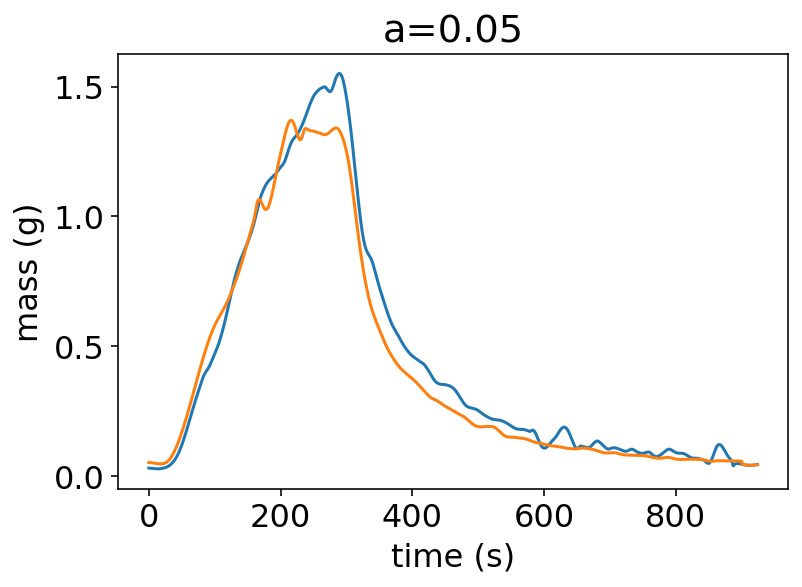

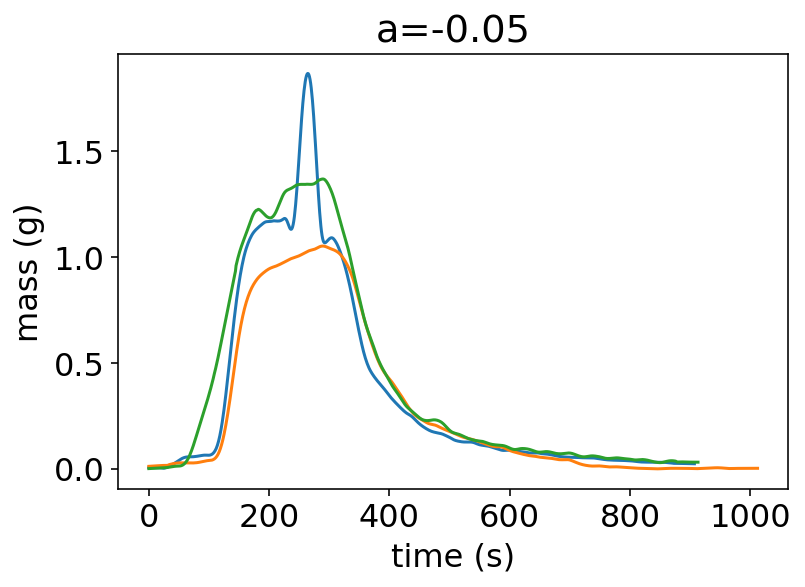

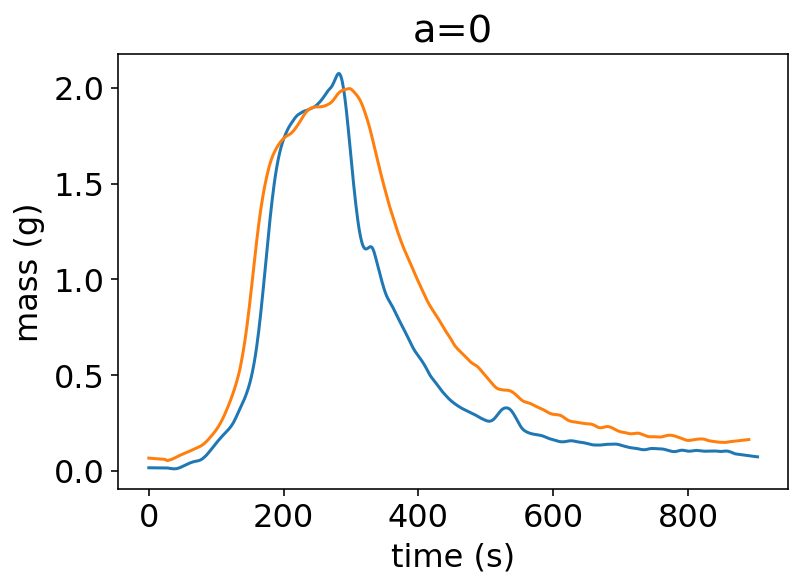

In [9]:
# plots separately the acceptable experimental runs
plt.plot(data.loc[::,'0.05_3':'0.05_4'])
plt.title('a=0.05')
plt.xlabel('time (s)')
plt.ylabel('mass (g)')
plt.show()
plt.plot(data.loc[::,'neg_0.05_1':'neg_0.05_3'])
plt.title('a=-0.05')
plt.xlabel('time (s)')
plt.ylabel('mass (g)')
plt.show()
plt.plot(data.loc[::,'0_3':'0_4'])
plt.title('a=0')
plt.xlabel('time (s)')
plt.ylabel('mass (g)')
plt.show()

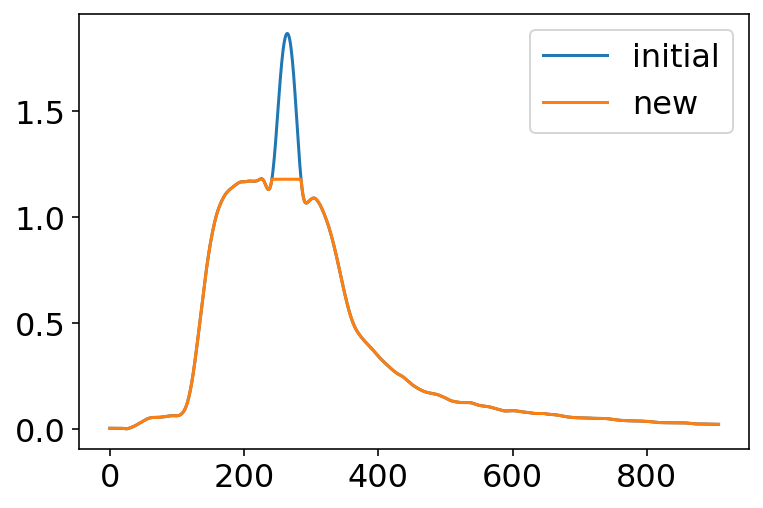

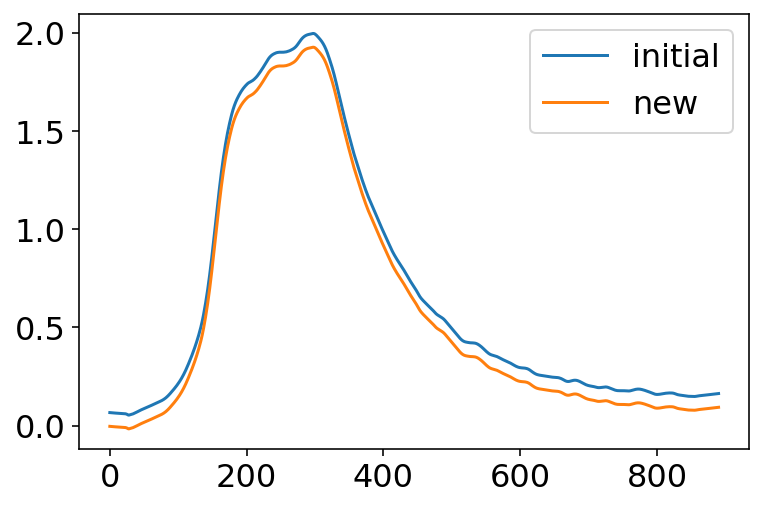

In [11]:


for d in data.keys():
    # removes outlier data point from experimental error
    if d=='neg_0.05_1' and thresh==0:
        plt.plot(data[d],label='initial')
        cats = []
        for i in range(len(data[d])):
            thresh=1.18
            if data[d][i]>thresh:
                data[d][i] = thresh
        plt.plot(data[d],label='new')
        plt.legend()
        plt.show()
    # adjusts hydrograph down that is lifted above 0
    elif d=='0_4' and min(data[d])>0.05:
        plt.plot(data[d],label='initial')
        for i in range(len(data[d])):
            data[d][i] = data[d][i]-0.07
        plt.plot(data[d],label='new')
        plt.legend()
        plt.show()


In [12]:
# dictionaries to hold data for pre-falling limb, falling limbs, and general simulation info
pre_falling = {'0.05_3':[],'0.05_4':[],'0.05_5':[],'neg_0.05_1':[],'neg_0.05_2':[],'0_3':[],'0_4':[]}
falling_limbs = {'0.05_3':[],'0.05_4':[],'0.05_5':[],'neg_0.05_1':[],'neg_0.05_2':[],'neg_0.05_3':[],'0_3':[],'0_4':[]}
sim_info = {'0.05_3':[0.05,0.984*38.,0.974*38.],'0.05_4':[0.05,0.984*38.,0.974*38.],'0.05_5':[0.05,0.984*38.,0.974*38.],
            'neg_0.05_1':[-0.05,0.974*29.,0.23*29.],'neg_0.05_2':[-0.05,0.974*29.,0.23*29.],'neg_0.05_3':[-0.05,0.974*29.,0.23*29.],
           '0_3':[0.,29.*0.903,0.61*29.],'0_4':[0.,29.*0.903,0.61*29.]}
# sim_info = {a:[value of a, length of scale model (m) multipled by scale factor, width of scale model outlet multiplied by scale factor]}

A =  626.322505041689
93
peakflow =  1.4389301451505376


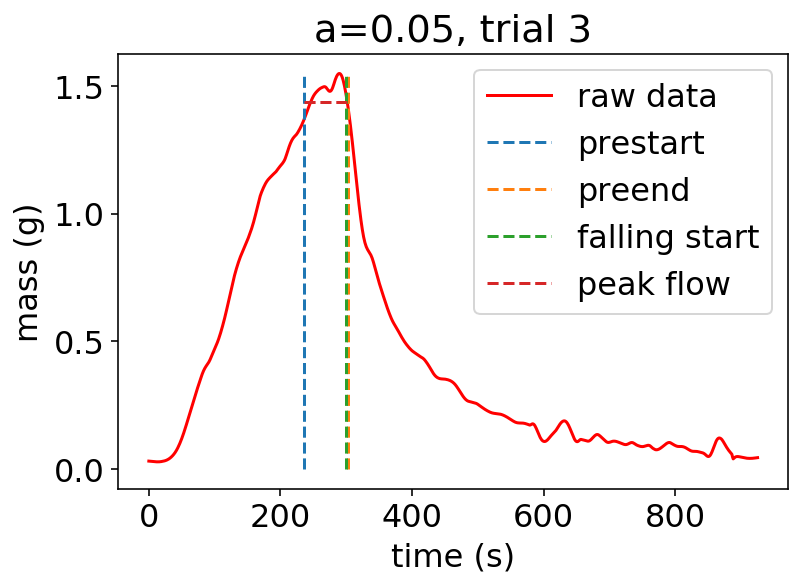

peakflow =  1.4389301451505376
t_c =  236
t_r =  300
I =  126.06440657827679
0.045146791063889885


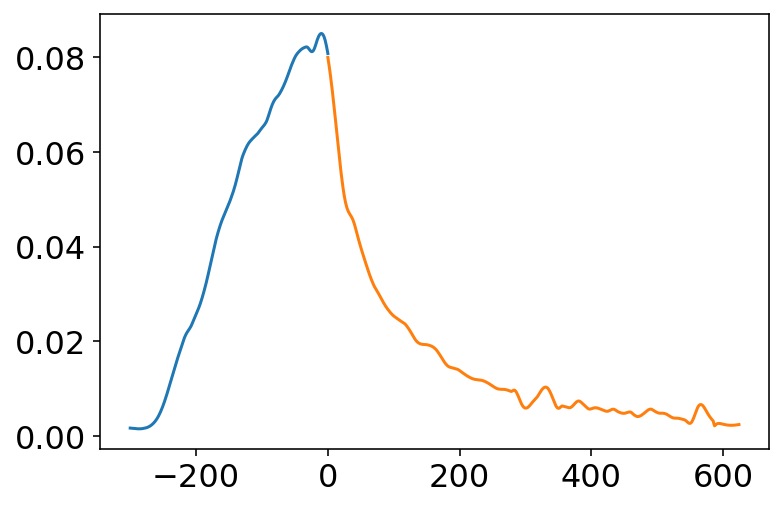

93
peakflow =  1.327398519612903


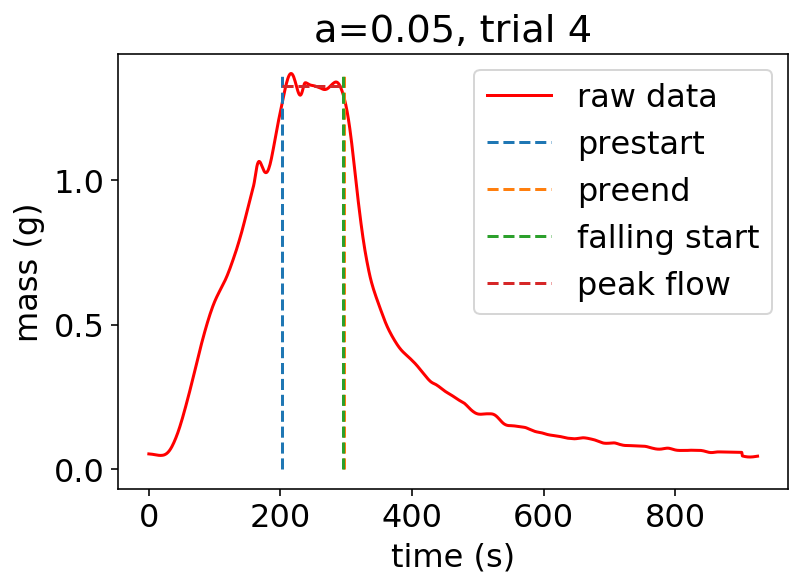

peakflow =  1.327398519612903
t_c =  202
t_r =  295
I =  116.2931412840595
0.04404375550790346


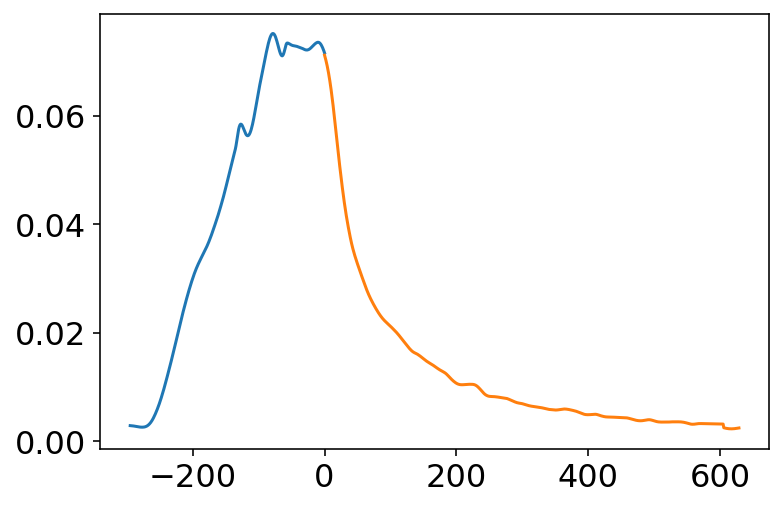

94
peakflow =  1.1861757603510643


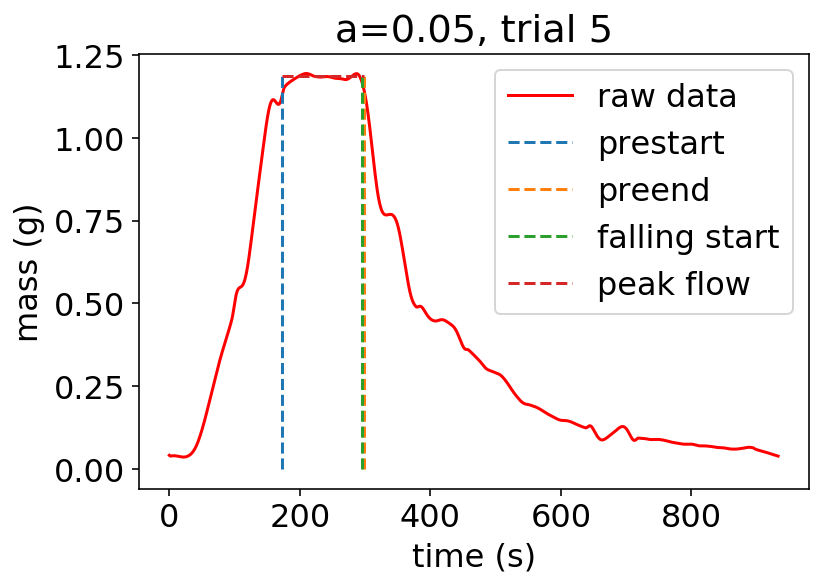

peakflow =  1.1861757603510643
t_c =  173
t_r =  295
I =  103.92064120009746
0.04149779912411128


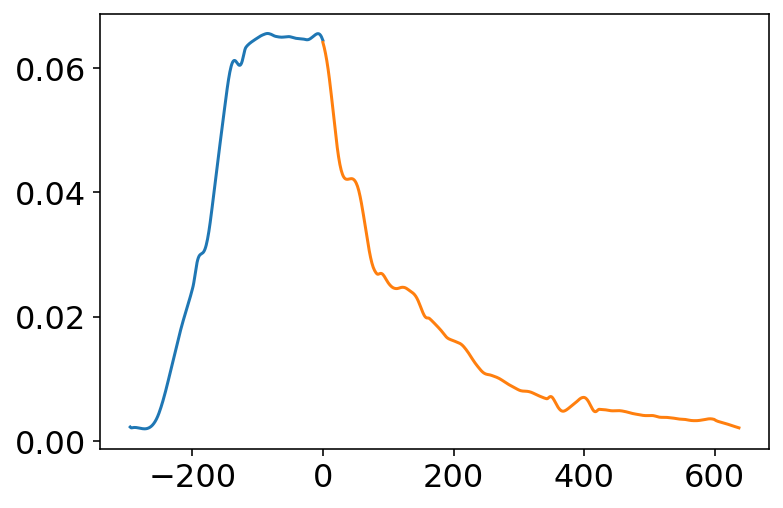

In [13]:
# sorts data and uses top 90% of points to identify the peak flow
# identifies the time when the peak flow value is within 5% of that value
# saves the value of peak flow and back calculates (from area) the 
# correct storm intensity to produce that peak flow Q=AI

a = 0.05
scale = 38.
xend = scale*0.985
c = 0.974*scale/nm.exp(a*xend)

A = c/a*(nm.exp(a*xend)-1.)
print ('A = ',A)

datasets = ['0.05_3','0.05_4','0.05_5']
j=3
for d in datasets:
    x = nm.linspace(0,len(data),len(data))  
    y1 = data[d] 

    plt.plot(x, y1, 'r',label='raw data')
    plt.legend()
    plt.xlabel('time (s)')
    plt.ylabel('mass (g)')
    plt.title('a=0.05, trial '+str(j))
    j+=1
    k = True
    sortlist = sorted(y1)
    #print (len(sortlist))
    for i in range(len(sortlist)):
        if math.isnan(sortlist[i]):
            #print ('hi')
            sortlist = sortlist[:i]
            break
    
    Dtip = int(len(sortlist)*0.9)
    print (len(sortlist[Dtip:]))
    avgpk = 0
    for i in range(Dtip,len(sortlist)):
        avgpk = avgpk+sortlist[i]/len(sortlist[Dtip:])
    print ('peakflow = ',avgpk)
    
    peaklist = []
    pstart = 0
    pend = 0
    for i in range(len(y1)):
        if abs(y1[i]-avgpk)<0.05*avgpk and pstart == 0:
            pstart = i
        if abs(y1[len(y1)-1-i]-avgpk)<0.05 and pend ==0:
            pend = len(y1)-1-i
    #print pstart,pend
    mm = max(y1)
    plt.plot([pstart,pstart],[0,mm],linestyle='--',label = 'prestart')
    plt.plot([pend,pend],[0,mm],linestyle='--',label = 'preend')
    plt.plot([endvals[d],endvals[d]],[0,mm],linestyle='--',label = 'falling start')
    plt.plot([pstart,pend],[avgpk,avgpk],linestyle='--',label='peak flow')
    #plt.ylim(-0.5,2)
    plt.legend()
    plt.show()
    print ('peakflow = ',avgpk)
    print ('t_c = ',pstart)
    print ('t_r = ',endvals[d])
    print ('I = ',avgpk*scale**3./A)
    
    if d in falling_limbs.keys():
        
        highbar = 8.0
        
        falling_limbs[d] = [f*scale**3./100.**3. for f in y1[endvals[d]:]]
        avg = sum(falling_limbs[d])/len(falling_limbs[d])
        for i in range(len(falling_limbs[d])):
            if falling_limbs[d][i]>highbar*avg:
                falling_limbs[d][i] = float('Nan')
            elif falling_limbs[d][i]<0:
                falling_limbs[d][i] = float('Nan')
        
        sim_info[d] = sim_info[d]+[avgpk*scale**3./A,endvals[d]]
        pre_falling[d] = [f*scale**3./100.**3. for f in y1[:endvals[d]]]
        preavg = sum(pre_falling[d])/len(pre_falling[d])
        print (preavg)
        for i in range(len(pre_falling[d])):
            if pre_falling[d][i]>highbar*avg:
                pre_falling[d][i] = float('Nan')
            elif pre_falling[d][i]<0:
                pre_falling[d][i] = float('Nan')
        plt.plot(nm.linspace(-len(pre_falling[d]),0,len(pre_falling[d])),pre_falling[d])
        plt.plot(falling_limbs[d])
        plt.show()

A =  414.2586182780111
91
peakflow =  1.1745400744945058


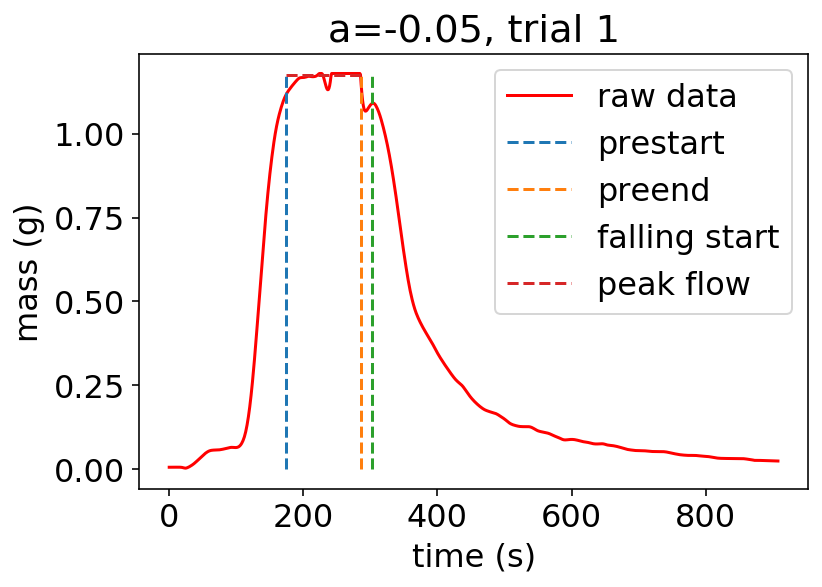

peakflow =  1.1745400744945058
t_c =  174
t_r =  303
I =  69.14969686308883
0.015660876362192468


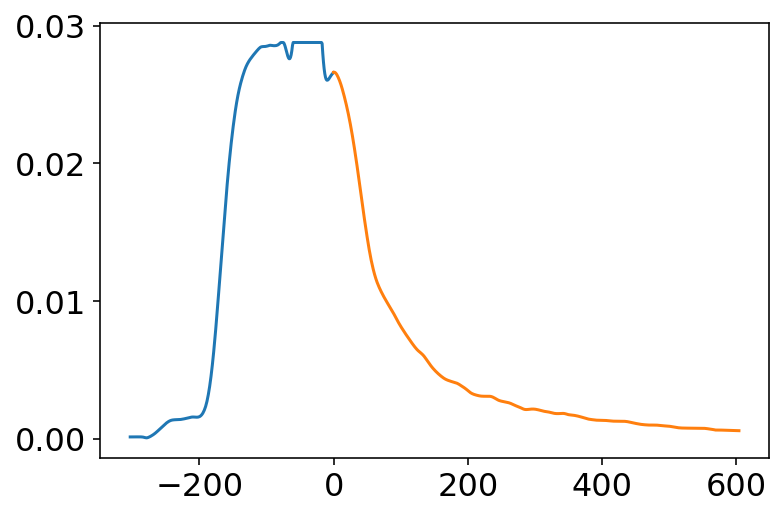

102
peakflow =  1.020751505117647


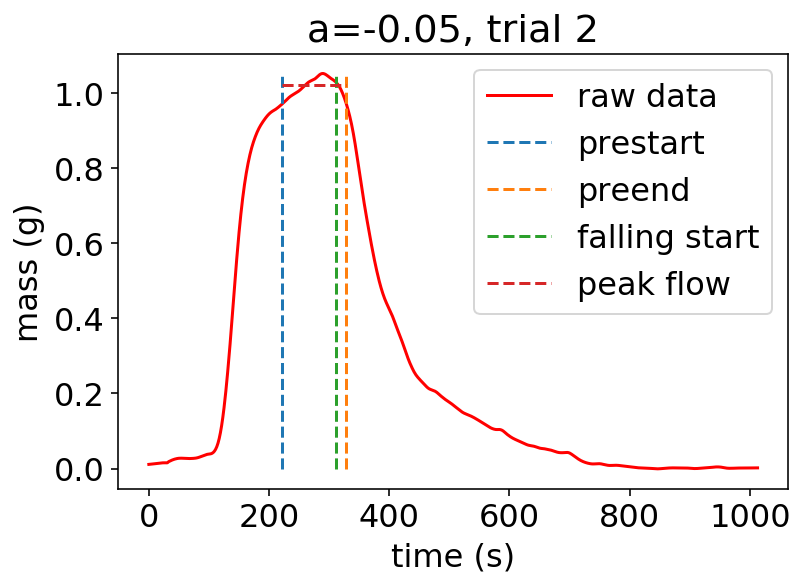

peakflow =  1.020751505117647
t_c =  221
t_r =  312
I =  60.09557160644768
0.013184571984757225


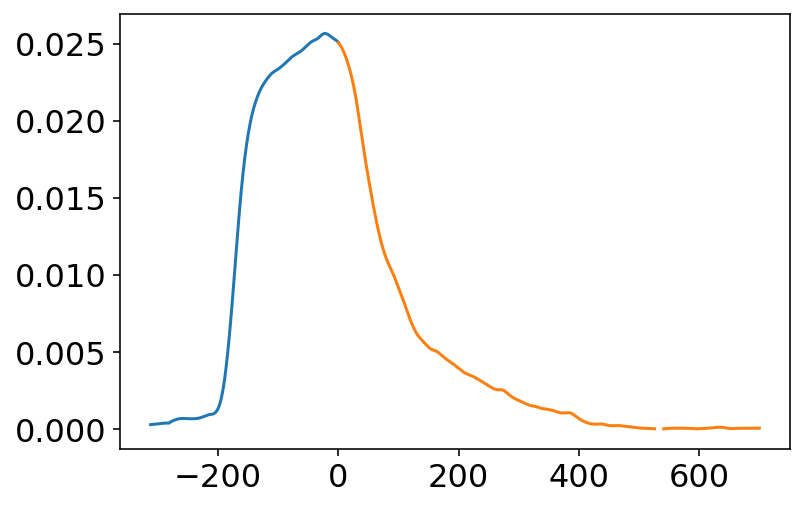

92
peakflow =  1.3338167622717394


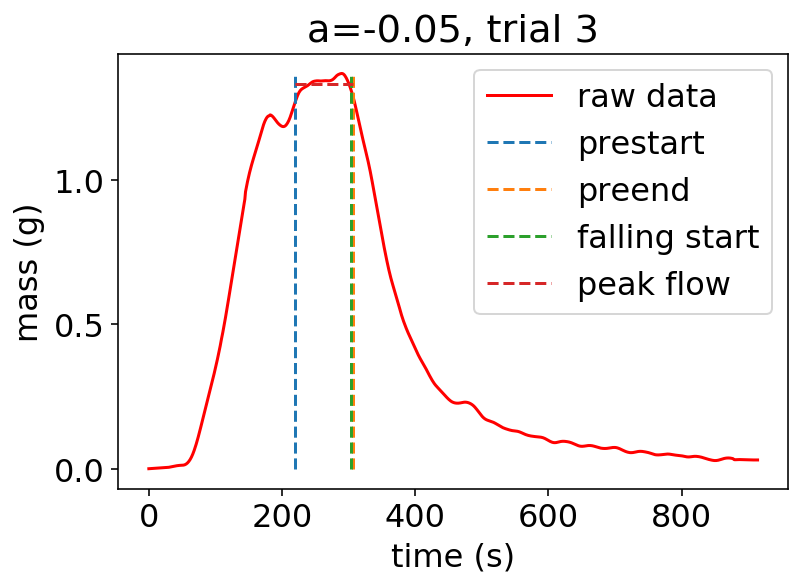

peakflow =  1.3338167622717394
t_c =  219
t_r =  304
I =  78.5269287824788
0.018857485862141966


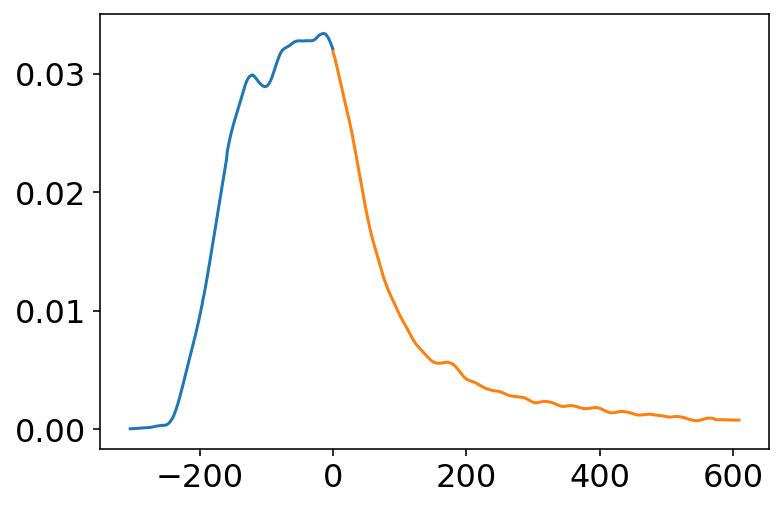

In [14]:
# sorts data and uses top 90% of points to identify the peak flow
# identifies the time when the peak flow value is within 5% of that value
# saves the value of peak flow and back calculates (from area) the 
# correct storm intensity to produce that peak flow Q=AI

a = -0.05
scale = 29.
xend = scale*0.974
c = 0.23*scale/nm.exp(a*xend)

A = c/a*(nm.exp(a*xend)-1.)
print ('A = ',A)

datasets = ['neg_0.05_1','neg_0.05_2','neg_0.05_3']
j=1
for d in datasets:
    x = nm.linspace(0,len(data),len(data))  
    y1 = data[d] 

    plt.plot(x, y1, 'r',label='raw data')
    plt.legend()
    plt.xlabel('time (s)')
    plt.ylabel('mass (g)')
    plt.title('a=-0.05, trial '+str(j))
    j+=1
    k = True
    sortlist = sorted(y1)
    #print (len(sortlist))
    for i in range(len(sortlist)):
        if math.isnan(sortlist[i]):
            #print ('hi')
            sortlist = sortlist[:i]
            break
    
    Dtip = int(len(sortlist)*0.9)
    print (len(sortlist[Dtip:]))
    avgpk = 0
    for i in range(Dtip,len(sortlist)):
        avgpk = avgpk+sortlist[i]/len(sortlist[Dtip:])
    print ('peakflow = ',avgpk)
    
    peaklist = []
    pstart = 0
    pend = 0
    for i in range(len(y1)):
        if abs(y1[i]-avgpk)<0.05*avgpk and pstart == 0:
            pstart = i
        if abs(y1[len(y1)-1-i]-avgpk)<0.05 and pend ==0:
            pend = len(y1)-1-i
    #print pstart,pend
    mm = max(y1)
    plt.plot([pstart,pstart],[0,mm],linestyle='--',label = 'prestart')
    plt.plot([pend,pend],[0,mm],linestyle='--',label = 'preend')
    plt.plot([endvals[d],endvals[d]],[0,mm],linestyle='--',label = 'falling start')
    plt.plot([pstart,pend],[avgpk,avgpk],linestyle='--',label='peak flow')
    #plt.ylim(-0.5,2)
    plt.legend()
    plt.show()
    print ('peakflow = ',avgpk)
    print ('t_c = ',pstart)
    print ('t_r = ',endvals[d])
    print ('I = ',avgpk*scale**3./A)
    
    if d in falling_limbs.keys():
        
        highbar = 8.0
        
        falling_limbs[d] = [f*scale**3./100.**3. for f in y1[endvals[d]:]]
        avg = sum(falling_limbs[d])/len(falling_limbs[d])
        for i in range(len(falling_limbs[d])):
            if falling_limbs[d][i]>highbar*avg:
                falling_limbs[d][i] = float('Nan')
            elif falling_limbs[d][i]<0:
                falling_limbs[d][i] = float('Nan')
        
        sim_info[d] = sim_info[d]+[avgpk*scale**3./A,endvals[d]]
        pre_falling[d] = [f*scale**3./100.**3. for f in y1[:endvals[d]]]
        preavg = sum(pre_falling[d])/len(pre_falling[d])
        print (preavg)
        for i in range(len(pre_falling[d])):
            if pre_falling[d][i]>highbar*avg:
                pre_falling[d][i] = float('Nan')
            elif pre_falling[d][i]<0:
                pre_falling[d][i] = float('Nan')
        plt.plot(nm.linspace(-len(pre_falling[d]),0,len(pre_falling[d])),pre_falling[d])
        plt.plot(falling_limbs[d])
        plt.show()

A =  463.24803
91
peakflow =  1.9228683664835167


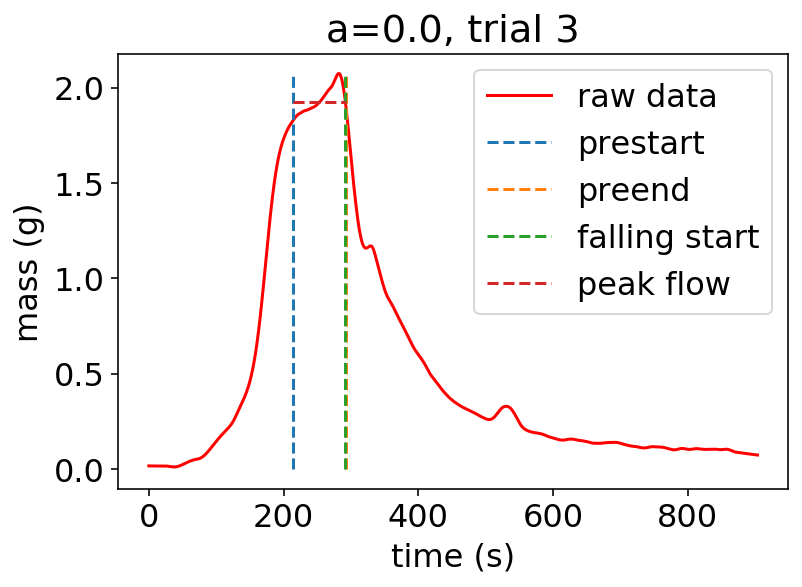

peakflow =  1.9228683664835167
t_c =  214
t_r =  292
I =  101.23483221324543
0.020807694581468146


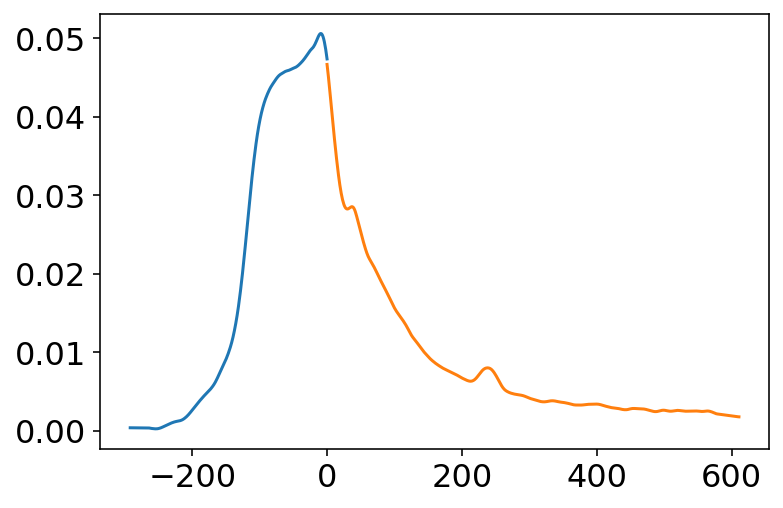

90
peakflow =  1.8636999707888884


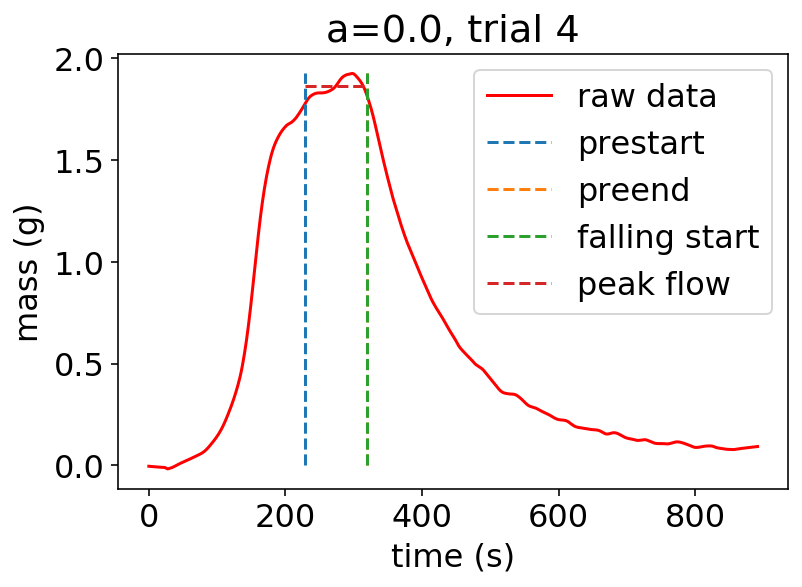

peakflow =  1.8636999707888884
t_c =  228
t_r =  320
I =  98.1197450263743
0.023583226925867222


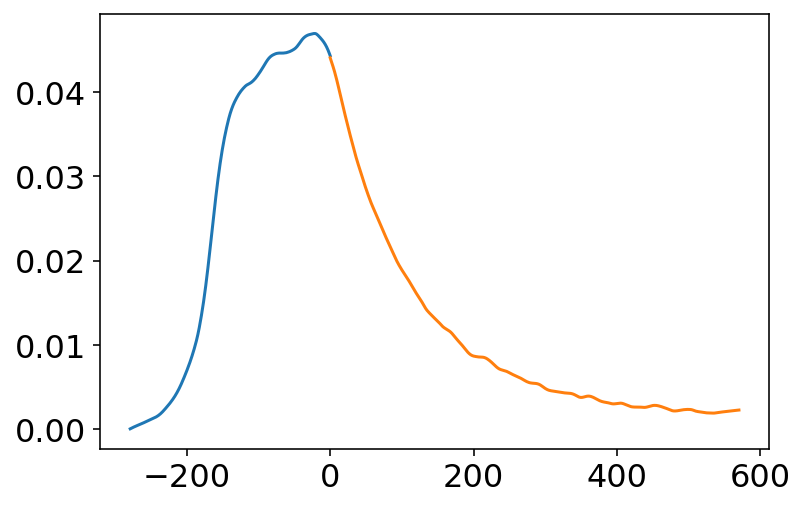

In [15]:
# sorts data and uses top 90% of points to identify the peak flow
# identifies the time when the peak flow value is within 5% of that value
# saves the value of peak flow and back calculates (from area) the 
# correct storm intensity to produce that peak flow Q=AI

a = 0.0
scale = 29.
xend = scale*0.903
A = 0.61*xend*scale

print ('A = ',A)


datasets = ['0_3','0_4']
j=3
for d in datasets:
    x = nm.linspace(0,len(data),len(data))  
    y1 = data[d] 

    plt.plot(x, y1, 'r',label='raw data')
    plt.legend()
    plt.xlabel('time (s)')
    plt.ylabel('mass (g)')
    plt.title('a=0.0, trial '+str(j))
    j+=1
    k = True
    sortlist = sorted(y1)
    #print (len(sortlist))
    for i in range(len(sortlist)):
        if math.isnan(sortlist[i]):
            #print ('hi')
            sortlist = sortlist[:i]
            break
    
    Dtip = int(len(sortlist)*0.9)
    print (len(sortlist[Dtip:]))
    avgpk = 0
    for i in range(Dtip,len(sortlist)):
        avgpk = avgpk+sortlist[i]/len(sortlist[Dtip:])
    print ('peakflow = ',avgpk)
    
    peaklist = []
    pstart = 0
    pend = 0
    for i in range(len(y1)):
        if abs(y1[i]-avgpk)<0.05*avgpk and pstart == 0:
            pstart = i
        if abs(y1[len(y1)-1-i]-avgpk)<0.05 and pend ==0:
            pend = len(y1)-1-i
    #print pstart,pend
    mm = max(y1)
    plt.plot([pstart,pstart],[0,mm],linestyle='--',label = 'prestart')
    plt.plot([pend,pend],[0,mm],linestyle='--',label = 'preend')
    plt.plot([endvals[d],endvals[d]],[0,mm],linestyle='--',label = 'falling start')
    plt.plot([pstart,pend],[avgpk,avgpk],linestyle='--',label='peak flow')
    #plt.ylim(-0.5,2)
    plt.legend()
    plt.show()
    print ('peakflow = ',avgpk)
    print ('t_c = ',pstart)
    print ('t_r = ',endvals[d])
    print ('I = ',avgpk*scale**3./A)
    
    if d in falling_limbs.keys():
        
        highbar = 8.0
        
        falling_limbs[d] = [f*scale**3./100.**3. for f in y1[endvals[d]:]]
        avg = sum(falling_limbs[d])/len(falling_limbs[d])
        for i in range(len(falling_limbs[d])):
            if falling_limbs[d][i]>highbar*avg:
                falling_limbs[d][i] = float('Nan')
            elif falling_limbs[d][i]<0:
                falling_limbs[d][i] = float('Nan')
        
        sim_info[d] = sim_info[d]+[avgpk*scale**3./A,endvals[d]]
        pre_falling[d] = [f*scale**3./100.**3. for f in y1[:endvals[d]]]
        preavg = sum(pre_falling[d])/len(pre_falling[d])
        print (preavg)
        for i in range(len(pre_falling[d])):
            if pre_falling[d][i]>highbar*avg:
                pre_falling[d][i] = float('Nan')
            elif pre_falling[d][i]<0:
                pre_falling[d][i] = float('Nan')
        plt.plot(nm.linspace(-len(pre_falling[d]),0,len(pre_falling[d])),pre_falling[d])
        plt.plot(falling_limbs[d])
        plt.show()

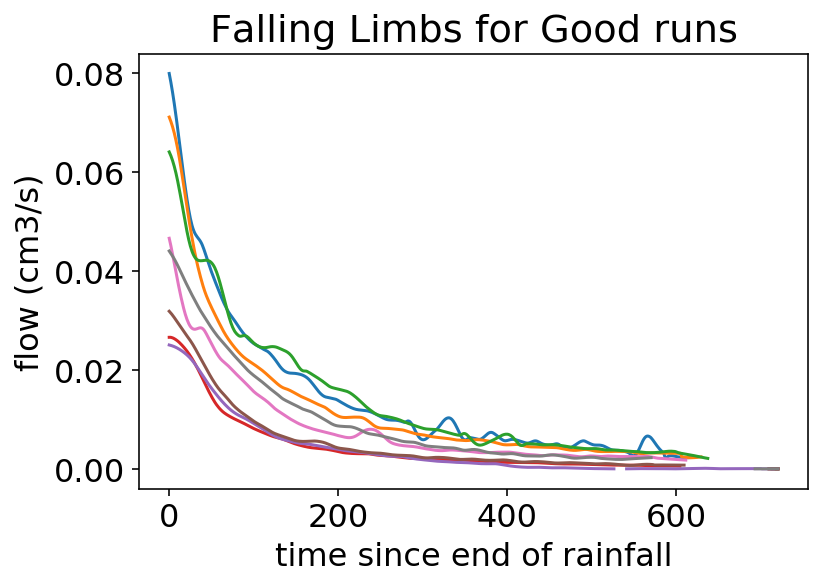

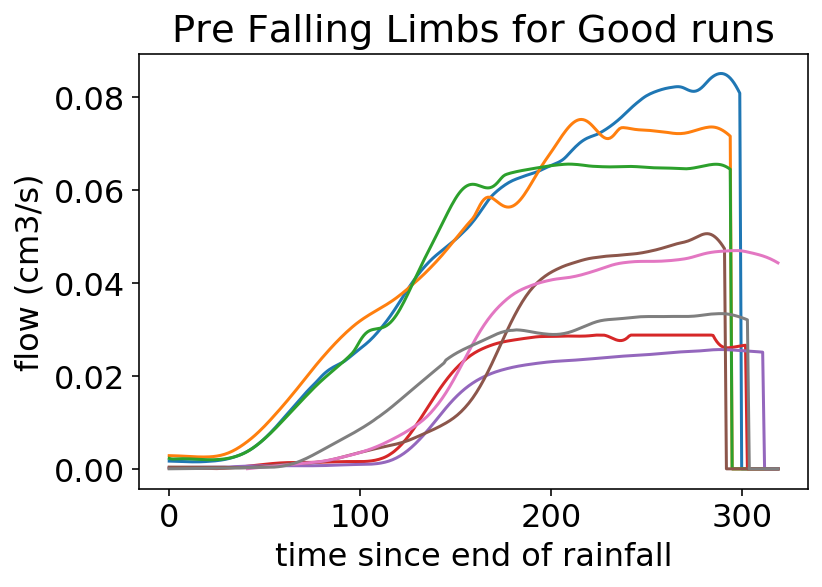

In [17]:
# plots the falling and rising limbs for all runs included in the dataset

maxlen = max([len(falling_limbs[d]) for d in falling_limbs.keys()])
for d in falling_limbs.keys():
    if len(falling_limbs[d])<maxlen:
        falling_limbs[d] = falling_limbs[d] + (maxlen-len(falling_limbs[d]))*[0]

df_falling = pd.DataFrame(falling_limbs)
df_falling.interpolate()

plt.plot(df_falling)
plt.title('Falling Limbs for Good runs')
plt.xlabel('time since end of rainfall')
plt.ylabel('flow (cm3/s)')
plt.show()

maxlen = max([len(pre_falling[d]) for d in pre_falling.keys()])
for d in pre_falling.keys():
    if len(pre_falling[d])<maxlen:
        pre_falling[d] = pre_falling[d] + (maxlen-len(pre_falling[d]))*[0]

df_prefalling = pd.DataFrame(pre_falling)
df_prefalling.interpolate()

plt.plot(df_prefalling)
plt.title('Pre Falling Limbs for Good runs')
plt.xlabel('time since end of rainfall')
plt.ylabel('flow (cm3/s)')
#plt.ylim(-0.01,0.1)
plt.show()

In [18]:
print (sim_info) # a, xend (m), outlet width, I (cm3/m2/s), tr (s)

{'0.05_3': [0.05, 37.391999999999996, 37.012, 126.06440657827679, 300], '0.05_4': [0.05, 37.391999999999996, 37.012, 116.2931412840595, 295], '0.05_5': [0.05, 37.391999999999996, 37.012, 103.92064120009746, 295], 'neg_0.05_1': [-0.05, 28.246, 6.67, 69.14969686308883, 303], 'neg_0.05_2': [-0.05, 28.246, 6.67, 60.09557160644768, 312], 'neg_0.05_3': [-0.05, 28.246, 6.67, 78.5269287824788, 304], '0_3': [0.0, 26.187, 17.69, 101.23483221324543, 292], '0_4': [0.0, 26.187, 17.69, 98.1197450263743, 320]}


In [ ]:
# In the following blocks, we will run analytical solutions to match each experimental run. 
# We will fit the analytical solution to the experimental data by tuning the roughness
# parameter (alpha) to match the falling limb

In [19]:
tp=0. # time of ponding, set to 0 by default, but the user 
      # can input a different constant value, and solutions 
      # will remain valid

# the following functions are the analytical equations 
# used by the next block to solve 

# all symbols are explicated in the table in the README document

# Domain 1 equations:
def h1(x0,x): # equation for average depth
    if a>=0:
        return(((r-f)*(1-nm.exp(a*(x0-x)))/(a*alpha))**(0.5))
    else:
        return(((r-f)*(nm.exp((-a)*(x-x0))-1)/((-a)*alpha))**(0.5))
def t1(x0,x,h): # equation for time characteristic
    if a>=0:
        return(tp+(1./(a*alpha*(r-f))**(0.5))*nm.arctanh(h*(a*alpha/(r-f))**(0.5)))
    else:
        return(tp+(1./((-a)*alpha*(r-f))**(0.5))*nm.arctan(h*((-a)*alpha/(r-f))**(0.5)))
def hstar1(): # equation for depth at tr
    if a>=0:
        return(nm.tanh((tr-tp)*(a*alpha*(r-f))**(0.5))*((r-f)/(a*alpha))**(0.5))
    else:
        return(nm.tan((tr-tp)*((-a)*alpha*(r-f))**(0.5))*((r-f)/((-a)*alpha))**(0.5))
def xstar1(x0): # equation for location at tr
    if a>=0:
        return(x0+a**(-1.)*nm.log((r-f)/(r-f-a*alpha*hstar1()**2)))
    else:
        return(x0+(-a)**(-1.)*(nm.log((r-f+(-a)*alpha*hstar1()**2))-nm.log(r-f)))

# Domain 2 equations:    
def h2(t0,x,xtop): # equation for average depth
    return(h1(xtop,x))
def t2(t0,x): # equation for time characteristic
    return(t0+tp+t1(0,x,h2(t0,x,xtop)))
def hstar2(t0): # equation for depth at tr
    if a>=0:
        return(nm.tanh((tr-t0-tp)*(a*alpha*(r-f))**(0.5))*((r-f)/(a*alpha))**(0.5))
    else:
        return(nm.tan((tr-t0-tp)*((-a)*alpha*(r-f))**(0.5))*((r-f)/((-a)*alpha))**(0.5))
def xstar2(t0,xtop): # equation for location at tr
    if a>=0:
        return(xtop+(a**(-1.))*nm.log((r-f)/(r-f-a*alpha*hstar2(t0+tp)**2)))
    else:
        return(xtop+(-a)**(-1.)*nm.log((r-f+(-a)*alpha*hstar2(t0+tp)**2)/(r-f)))

# Domain 3 equations:   
def h3(xstar,x,hstar): # equation for average depth
    if a>=0:
        return(((nm.exp(a*(xstar-x))*(f+a*alpha*hstar**2)-f)/(a*alpha))**(0.5))
    else:
        return(((-nm.exp((-a)*(x-xstar))*(f+a*alpha*hstar**2)+f)/((-a)*alpha))**(0.5))
def xzw(xstar,hstar): # equation for location of disappearance of water on surface, used when f!=0
    if a>=0:
        return(xstar+(a**(-1))*(nm.log((f+a*alpha*hstar**2))-nm.log(f)))
    else:
        return(xstar+(a)**(-1)*(-nm.log(f)+nm.log((f+(a)*alpha*hstar**2))))
def t3(xstar,x,hstar): # equation for time characteristic
    if f==0:
        return(tr+1./(alpha*a)*(1./h3(xstar,x,hstar)-1./hstar))
    elif a>=0:
        return(tr+(a*alpha*f)**(-0.5)*(nm.arctan(hstar*(a*alpha/f)**(0.5))-nm.arctan(h3(xstar,x,hstar)*(a*alpha/f)**(0.5))))
    else:
        return(tr-((-a)*alpha*f)**(-0.5)*(nm.arctanh(h3(xstar,x,hstar)*((-a)*alpha/f)**(0.5))-nm.arctanh(hstar*((-a)*alpha/f)**(0.5))))


In [21]:
# we test a range of alpha values to find the optimal value
alphalist = nm.linspace(4.,19.,50)

# dictionaries holding solution information
touts_tot={aaa:{aa:[] for aa in alphalist} for aaa in sim_info.keys()} # a list of time values at which depth is collected for each value of a
houts_tot={aaa:{aa:[] for aa in alphalist} for aaa in sim_info.keys()} # a list of depths corresponding to the time values collected for each value of a

touts_tot_1={aaa:{aa:[] for aa in alphalist} for aaa in sim_info.keys()} # a list of time values at which depth is collected for each value of a
houts_tot_1={aaa:{aa:[] for aa in alphalist} for aaa in sim_info.keys()} # a list of depths corresponding to the time values collected for each value of a



In [23]:
# this block runs analytical simulations for each experiment with a range of alpha values

for dd in sim_info.keys():
    for aa in alphalist:
        
        # this block solves for the hydrograph based on user parameters and displays
        # the characteristic net for user-defined problems




        # User-defined constants and values

        r=sim_info[dd][3] /100.**3.    # rainfall rate in m/s
        tr=sim_info[dd][4]                # end of rainstorm in seconds
        f=0         # constant infiltration rate in m/s
        alpha = aa

                   # coefficient alpha=(So/n)^(1/2)

        color1='skyblue'         # color for plotting characteristics
        colorbold='dimgrey'      # color for limiting characteristic

        different = False         # parameter that tells the program to use hillslopeSizeDict if True. If False, program will use user-set xend and xtop for all cases
        xend = sim_info[dd][1]               # location of stream outlet
        xtop = 0.                # location of divide

        

        #solution begins below
        aval = dd                           # for loop that completes solution for each user-specified value of a
        a = sim_info[dd][0]                       # sets value of a for following simulation
        #a = -0.0000000001
        tp=0
        if aval=='0_3' or aval=='0_4':
            a=-0.0000000001
            tp=20.
        elif aval=='neg_0.05_1': 
            tp=25.
        elif aval=='neg_0.05_2' :
            tp=0.
        elif aval=='neg_0.05_3':
            tp = 6.
        else:
            tp=0.
        if different == True:                    # sets locations of divide and outlet based on hillslopeSizeDict if True or xend and xtop if False
            xend=hillslopeSizeDict[aval][1]
            xtop=hillslopeSizeDict[aval][0]
        print (dd )                          # prints value of a for simulation
        xstarvals = []                           # list of characteristic locations at tr
        hstarvals = []                           # list of depths associated with characteristic locations at tr
        houts1 = []                              # list of depths at outlet from domain 1
        touts1 = []                              # list of times associated with outlet depths from domain 1
        houts2 = []                              # list of depths at outlet from domain 2
        touts2 = []                              # list of times associated with outlet depths from domain 2
        houts3 = []                              # list of depths at outlet from domain 3
        touts3 = []                              # list of times associated with outlet depths from domain 3
        xstarplot = []                           # list of xstar vals used to plot characteristics starting at t=tr

        print ('a = ',a)
        print ('alpha = ',alpha)# prints dimensions of the hillslope
        
        
        # Solution for Domain 1

        x0vals = nm.linspace(xtop,xend,100)             # initiate a list of 100 x0 values to start characteristics
        for val in x0vals:                              # for loop solves a characteristic for each x0
            xvals= nm.linspace(val,xend,1000)           # initiates 1000 xvals to solve the characteristic on
            hvals= h1(val,xvals)                        # finds depth using domain 1 equation at each xval
            tvals= t1(val,xvals,hvals)                  # finds the associated time for each depth value

            d=len(tvals)                                
            for g in range (len(tvals)):    # loops through elements in tvals  
                if tvals[g]>tr:             # notes the latest time before tr as an index in the list
                    if d==len(tvals):      
                        d=g-1
            for g in range(len(tvals)):     # for times after the characteristic reaches tr, we throw out the information 
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if t1(val,xend,h1(val,xend))<tr:                 # if statement tests whether the characteristic crosses the outlet before tr
                houts1 = houts1+[h1(val,xend)]               # if so, then the depth and time of crossing are kept for the hydrograph
                touts1 = touts1+[t1(val,xend,h1(val,xend))]
            else:
                xstarvals=xstarvals+[xstar1(val)]            # if not, then the location xstar and depth hstar for this characteristic
                hstarvals=hstarvals+[h1(val,xstar1(val))]    # are saved to send to domain 3

            # the following if statement plots the limiting characteristic in colorbold, the rest in color1
            if val==x0vals[0]:
                #pylab.plot(xvals,[t for t in tvals], c=colorbold)
                xstarplot = xstarplot+[xstar1(val)]
            elif val in [x0vals[i*14] for i in list(range(7))]: # plot only a handful of the characterstics, not all of them
                #pylab.plot(xvals,[t for t in tvals],c=color1)
                xstarplot = xstarplot+[xstar1(val)]

        touts1.reverse()                                     # reverses the elements of touts1 since they are backwards
        houts1.reverse()                                     # reverses the elements of houts1 to stay consistent with touts1

        # Solution for Domain 2

        t0vals = nm.linspace(tp,tr,100)                       # initiates a set of t0vals to start characteristics in domain 2
        for val in t0vals:                                   # for loop solves a characteristic for each t0
            xvals = nm.linspace(xtop,xend,1000)              # initiates a set of xvals to solve characteristic on
            hvals = h2(val,xvals,xtop)                       # finds depth along characteristic using domain 2 equation
            tvals = t2(val,xvals)                            # solves for t(x) characteristic using domain 2 equation

            d=len(tvals)
            for g in range(len(tvals)):         # loops through elements in tvals
                if tvals[g]>tr:                 # notes the latest time before tr as an index in the list
                    if d==len(tvals):
                        d=g-1
            for g in range(len(tvals)):         # throws out all information occuring after tr
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if t2(val,xend)<=tr:                          # if statement tests whether the characteristic crosses the outlet before tr
                houts2 = houts2+[h2(val,xend,xtop)]       # if so, then the depth and time of crossing are kept for the hydrograph
                touts2 = touts2+[t2(val,xend)]
            else:
                xstarvals=[xstar2(val,xtop)]+xstarvals               # if not, then the location xstar and depth hstar for this characteristic
                hstarvals=[h2(val,xstar2(val,xtop),xtop)]+hstarvals  # are saved to send to domain 3

            # the following if statement plots the limiting characteristic in colorbold, the rest in color1
            if val==t0vals[0]:
                #pylab.plot(xvals,[t for t in tvals],c=colorbold)
                xstarplot = xstarplot+[xstar2(val,xtop)]
            elif val in [t0vals[i*14] for i in list(range(7))]: # plot only a handful of the characteristics, not all of them
                #pylab.plot(xvals,[t for t in tvals],c=color1)
                xstarplot = xstarplot+[xstar2(val,xtop)]

        # Solution for Domain 3:        

        xzwvals=[]          # list of locations at which characteristic dries up (used only when f!=0)
        tzwvals=[]          # list of times at which characteristic dries up (used only when f!=0)

        for i in range (len(xstarvals)):                       # for loop solves characteristic for each xstarval
            xvals = nm.linspace(xstarvals[i],xend,1000)        # initiates set of xvals to solve the characteristic on
            hvals = h3(xstarvals[i],xvals,hstarvals[i])        # solves for depths along characteristic using domain 3 equation
            tvals = t3(xstarvals[i],xvals,hstarvals[i])        # solves for t(x) characteristic using domain 3 equation

            d=len(tvals)
            for g in range(len(xvals)):                                     # loops through xvals
                if math.isnan(hvals[g]):                                    # checks if an xval is NaN
                    if d==len(tvals):                                       # marks the beginning of NaN values, since all following values will be Nan
                        d=g
                        tzwvals=tzwvals+[tvals[d-1]]                        # throws out NaN values
                        xzwvals=xzwvals+[xzw(xstarvals[i],hstarvals[i])]    # throws out NaN values

                if xvals[g]>xzw(hstarvals[i],xstarvals[i]):                 # checks if the xval is past where the characteristic disappears
                    if d==len(tvals):                                       # throws out all data past when the characteristic disappears
                        d=g
                        tzwvals=tzwvals+[tvals[d-1]]
                        xzwvals=xzwvals+[xzw(xstarvals[i],hstarvals[i])]
            for g in range(len(tvals)):          # loops through tvals throwing out NaN data or data after characteristic disappears
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if f==0:                                                 # if f=0, then all characteristics eventually leave landscape, so...
                houts3 = houts3+[h3(xstarvals[i],xend,hstarvals[i])]     # tracks the depth when each characteristic leaves the landscape
                touts3 = touts3+[t3(xstarvals[i],xend,hstarvals[i])]     # tracks the time each characteristic leaves the landscape
            if xzw(xstarvals[i],hstarvals[i])>=xend:                 # if f!=0, then not all characteristics leave landscape. If they leave, then
                houts3 = houts3+[h3(xstarvals[i],xend,hstarvals[i])]     # tracks depth
                touts3 = touts3+[t3(xstarvals[i],xend,hstarvals[i])]     # and time when they leave
            #if xvals[0] in xstarplot:                                # we initiated many more characteristics than we plot, so 
            #    pylab.plot(xvals,[t for t in tvals],c=color1)     # plot only the continuation of characteristics already on the plot

        houts3.reverse()           # reverse houts3 since it is backwards
        touts3.reverse()           # reverse touts3 since it is backwards


        houts=houts1+houts2+houts3    # aggregate all depth data at outlet into one list
        touts=touts1+touts2+touts3    # aggregate all time data at outlet into one list

        houts_tot[aval][alpha]=houts         # save depth data to the dictionary houts_tot
        touts_tot[aval][alpha]=touts         # save time data to the dictionary touts_tot


        #plt.plot(xzwvals,[t for t in tzwvals],c='gray',linestyle='--') # plots the envelope of drying characteristics when f!=0
        #plt.plot([0,xend],[tr,tr],c='gray',linestyle='--')          # plots a horizontal line at t=tr
        #plt.xlim(0,xend)             # sets x-axis to show only the hillslope
        #plt.ylim(0,2*tr)          # sets y-axis to display a period 5 times the rainstorm length
        #plt.xlabel('x (m)')          # x-axis label
        #plt.ylabel('t-t$_p$ (min)')  # y-axis label
        #plt.title('a = ' + str(aval))     # plot title
        #plt.show()                   # makes each plot display separately


0.05_3
a =  0.05
alpha =  4.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in subtract
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:56: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in double_scalars


0.05_3
a =  0.05
alpha =  4.3061224489795915
0.05_3
a =  0.05
alpha =  4.612244897959184
0.05_3
a =  0.05
alpha =  4.918367346938775
0.05_3
a =  0.05
alpha =  5.224489795918368
0.05_3
a =  0.05
alpha =  5.530612244897959
0.05_3
a =  0.05
alpha =  5.836734693877551
0.05_3
a =  0.05
alpha =  6.142857142857142
0.05_3
a =  0.05
alpha =  6.448979591836735
0.05_3
a =  0.05
alpha =  6.755102040816327
0.05_3
a =  0.05
alpha =  7.061224489795919
0.05_3
a =  0.05
alpha =  7.36734693877551
0.05_3
a =  0.05
alpha =  7.673469387755102
0.05_3
a =  0.05
alpha =  7.979591836734694
0.05_3
a =  0.05
alpha =  8.285714285714285
0.05_3
a =  0.05
alpha =  8.591836734693878
0.05_3
a =  0.05
alpha =  8.89795918367347
0.05_3
a =  0.05
alpha =  9.204081632653061
0.05_3
a =  0.05
alpha =  9.510204081632654
0.05_3
a =  0.05
alpha =  9.816326530612244
0.05_3
a =  0.05
alpha =  10.122448979591837
0.05_3
a =  0.05
alpha =  10.428571428571429
0.05_3
a =  0.05
alpha =  10.73469387755102
0.05_3
a =  0.05
alpha =  11.04

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in log


neg_0.05_1
a =  -0.05
alpha =  4.3061224489795915
neg_0.05_1
a =  -0.05
alpha =  4.612244897959184
neg_0.05_1
a =  -0.05
alpha =  4.918367346938775
neg_0.05_1
a =  -0.05
alpha =  5.224489795918368
neg_0.05_1
a =  -0.05
alpha =  5.530612244897959
neg_0.05_1
a =  -0.05
alpha =  5.836734693877551
neg_0.05_1
a =  -0.05
alpha =  6.142857142857142
neg_0.05_1
a =  -0.05
alpha =  6.448979591836735
neg_0.05_1
a =  -0.05
alpha =  6.755102040816327
neg_0.05_1
a =  -0.05
alpha =  7.061224489795919
neg_0.05_1
a =  -0.05
alpha =  7.36734693877551
neg_0.05_1
a =  -0.05
alpha =  7.673469387755102
neg_0.05_1
a =  -0.05
alpha =  7.979591836734694
neg_0.05_1
a =  -0.05
alpha =  8.285714285714285
neg_0.05_1
a =  -0.05
alpha =  8.591836734693878
neg_0.05_1
a =  -0.05
alpha =  8.89795918367347
neg_0.05_1
a =  -0.05
alpha =  9.204081632653061
neg_0.05_1
a =  -0.05
alpha =  9.510204081632654
neg_0.05_1
a =  -0.05
alpha =  9.816326530612244
neg_0.05_1
a =  -0.05
alpha =  10.122448979591837
neg_0.05_1
a =  -0.0

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in double_scalars


neg_0.05_2
a =  -0.05
alpha =  4.3061224489795915
neg_0.05_2
a =  -0.05
alpha =  4.612244897959184
neg_0.05_2
a =  -0.05
alpha =  4.918367346938775
neg_0.05_2
a =  -0.05
alpha =  5.224489795918368
neg_0.05_2
a =  -0.05
alpha =  5.530612244897959
neg_0.05_2
a =  -0.05
alpha =  5.836734693877551
neg_0.05_2
a =  -0.05
alpha =  6.142857142857142
neg_0.05_2
a =  -0.05
alpha =  6.448979591836735
neg_0.05_2
a =  -0.05
alpha =  6.755102040816327
neg_0.05_2
a =  -0.05
alpha =  7.061224489795919
neg_0.05_2
a =  -0.05
alpha =  7.36734693877551
neg_0.05_2
a =  -0.05
alpha =  7.673469387755102
neg_0.05_2
a =  -0.05
alpha =  7.979591836734694
neg_0.05_2
a =  -0.05
alpha =  8.285714285714285
neg_0.05_2
a =  -0.05
alpha =  8.591836734693878
neg_0.05_2
a =  -0.05
alpha =  8.89795918367347
neg_0.05_2
a =  -0.05
alpha =  9.204081632653061
neg_0.05_2
a =  -0.05
alpha =  9.510204081632654
neg_0.05_2
a =  -0.05
alpha =  9.816326530612244
neg_0.05_2
a =  -0.05
alpha =  10.122448979591837
neg_0.05_2
a =  -0.0

0_4
a =  -1e-10
alpha =  12.571428571428571
0_4
a =  -1e-10
alpha =  12.877551020408163
0_4
a =  -1e-10
alpha =  13.183673469387756
0_4
a =  -1e-10
alpha =  13.489795918367347
0_4
a =  -1e-10
alpha =  13.795918367346939
0_4
a =  -1e-10
alpha =  14.10204081632653
0_4
a =  -1e-10
alpha =  14.408163265306122
0_4
a =  -1e-10
alpha =  14.714285714285715
0_4
a =  -1e-10
alpha =  15.020408163265307
0_4
a =  -1e-10
alpha =  15.326530612244898
0_4
a =  -1e-10
alpha =  15.63265306122449
0_4
a =  -1e-10
alpha =  15.938775510204081
0_4
a =  -1e-10
alpha =  16.244897959183675
0_4
a =  -1e-10
alpha =  16.551020408163268
0_4
a =  -1e-10
alpha =  16.857142857142858
0_4
a =  -1e-10
alpha =  17.163265306122447
0_4
a =  -1e-10
alpha =  17.46938775510204
0_4
a =  -1e-10
alpha =  17.775510204081634
0_4
a =  -1e-10
alpha =  18.081632653061227
0_4
a =  -1e-10
alpha =  18.387755102040817
0_4
a =  -1e-10
alpha =  18.693877551020407
0_4
a =  -1e-10
alpha =  19.0


In [24]:
# this block runs analytical simulations for each simulation assuming a=0 for a range of alpha values

for dd in sim_info.keys():
    for aa in alphalist:
        
        # this block solves for the hydrograph based on user parameters and displays
        # the characteristic net for user-defined problems

        matplotlib.rcParams.update({'font.size': 16}) # sets the font size for characteristics figures
        %config InlineBackend.figure_format = 'retina' # sets the image resolution to retina quality


        # User-defined constants and values

        r=sim_info[dd][3] /100.**3.    # rainfall rate in m/s
        tr=sim_info[dd][4]                # end of rainstorm in seconds
        f=0         # constant infiltration rate in m/s
        alpha = aa

                   # coefficient alpha=(So/n)^(1/2)

        color1='skyblue'         # color for plotting characteristics
        colorbold='dimgrey'      # color for limiting characteristic

        different = False         # parameter that tells the program to use hillslopeSizeDict if True. If False, program will use user-set xend and xtop for all cases
        xend = sim_info[dd][1]               # location of stream outlet
        xtop = 0.                # location of divide

        

        #solution begins below
        aval = dd                           # for loop that completes solution for each user-specified value of a
        a = -0.0000000001
        if aval=='0_3' or aval=='0_4':
            a=-0.0000000001
            tp=20.
        elif aval=='neg_0.05_1': 
            tp=25.
        elif aval=='neg_0.05_2' :
            tp=0.
        elif aval=='neg_0.05_3':
            tp = 6.
        else:
            tp=0.
        if different == True:                    # sets locations of divide and outlet based on hillslopeSizeDict if True or xend and xtop if False
            xend=hillslopeSizeDict[aval][1]
            xtop=hillslopeSizeDict[aval][0]
        print (aval )                          # prints value of a for simulation
        xstarvals = []                           # list of characteristic locations at tr
        hstarvals = []                           # list of depths associated with characteristic locations at tr
        houts1 = []                              # list of depths at outlet from domain 1
        touts1 = []                              # list of times associated with outlet depths from domain 1
        houts2 = []                              # list of depths at outlet from domain 2
        touts2 = []                              # list of times associated with outlet depths from domain 2
        houts3 = []                              # list of depths at outlet from domain 3
        touts3 = []                              # list of times associated with outlet depths from domain 3
        xstarplot = []                           # list of xstar vals used to plot characteristics starting at t=tr

        print ('a = ',a)
        print ('alpha = ',alpha)# prints dimensions of the hillslope

        # Solution for Domain 1

        x0vals = nm.linspace(xtop,xend,100)             # initiate a list of 100 x0 values to start characteristics
        for val in x0vals:                              # for loop solves a characteristic for each x0
            xvals= nm.linspace(val,xend,1000)           # initiates 1000 xvals to solve the characteristic on
            hvals= h1(val,xvals)                        # finds depth using domain 1 equation at each xval
            tvals= t1(val,xvals,hvals)                  # finds the associated time for each depth value

            d=len(tvals)                                
            for g in range (len(tvals)):    # loops through elements in tvals  
                if tvals[g]>tr:             # notes the latest time before tr as an index in the list
                    if d==len(tvals):      
                        d=g-1
            for g in range(len(tvals)):     # for times after the characteristic reaches tr, we throw out the information 
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if t1(val,xend,h1(val,xend))<tr:                 # if statement tests whether the characteristic crosses the outlet before tr
                houts1 = houts1+[h1(val,xend)]               # if so, then the depth and time of crossing are kept for the hydrograph
                touts1 = touts1+[t1(val,xend,h1(val,xend))]
            else:
                xstarvals=xstarvals+[xstar1(val)]            # if not, then the location xstar and depth hstar for this characteristic
                hstarvals=hstarvals+[h1(val,xstar1(val))]    # are saved to send to domain 3

            # the following if statement plots the limiting characteristic in colorbold, the rest in color1
            if val==x0vals[0]:
                #pylab.plot(xvals,[t for t in tvals], c=colorbold)
                xstarplot = xstarplot+[xstar1(val)]
            elif val in [x0vals[i*14] for i in list(range(7))]: # plot only a handful of the characterstics, not all of them
                #pylab.plot(xvals,[t for t in tvals],c=color1)
                xstarplot = xstarplot+[xstar1(val)]

        touts1.reverse()                                     # reverses the elements of touts1 since they are backwards
        houts1.reverse()                                     # reverses the elements of houts1 to stay consistent with touts1

        # Solution for Domain 2

        t0vals = nm.linspace(tp,tr,100)                       # initiates a set of t0vals to start characteristics in domain 2
        for val in t0vals:                                   # for loop solves a characteristic for each t0
            xvals = nm.linspace(xtop,xend,1000)              # initiates a set of xvals to solve characteristic on
            hvals = h2(val,xvals,xtop)                       # finds depth along characteristic using domain 2 equation
            tvals = t2(val,xvals)                            # solves for t(x) characteristic using domain 2 equation

            d=len(tvals)
            for g in range(len(tvals)):         # loops through elements in tvals
                if tvals[g]>tr:                 # notes the latest time before tr as an index in the list
                    if d==len(tvals):
                        d=g-1
            for g in range(len(tvals)):         # throws out all information occuring after tr
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if t2(val,xend)<=tr:                          # if statement tests whether the characteristic crosses the outlet before tr
                houts2 = houts2+[h2(val,xend,xtop)]       # if so, then the depth and time of crossing are kept for the hydrograph
                touts2 = touts2+[t2(val,xend)]
            else:
                xstarvals=[xstar2(val,xtop)]+xstarvals               # if not, then the location xstar and depth hstar for this characteristic
                hstarvals=[h2(val,xstar2(val,xtop),xtop)]+hstarvals  # are saved to send to domain 3

            # the following if statement plots the limiting characteristic in colorbold, the rest in color1
            if val==t0vals[0]:
                #pylab.plot(xvals,[t for t in tvals],c=colorbold)
                xstarplot = xstarplot+[xstar2(val,xtop)]
            elif val in [t0vals[i*14] for i in list(range(7))]: # plot only a handful of the characteristics, not all of them
                #pylab.plot(xvals,[t for t in tvals],c=color1)
                xstarplot = xstarplot+[xstar2(val,xtop)]

        # Solution for Domain 3:        

        xzwvals=[]          # list of locations at which characteristic dries up (used only when f!=0)
        tzwvals=[]          # list of times at which characteristic dries up (used only when f!=0)

        for i in range (len(xstarvals)):                       # for loop solves characteristic for each xstarval
            xvals = nm.linspace(xstarvals[i],xend,1000)        # initiates set of xvals to solve the characteristic on
            hvals = h3(xstarvals[i],xvals,hstarvals[i])        # solves for depths along characteristic using domain 3 equation
            tvals = t3(xstarvals[i],xvals,hstarvals[i])        # solves for t(x) characteristic using domain 3 equation

            d=len(tvals)
            for g in range(len(xvals)):                                     # loops through xvals
                if math.isnan(hvals[g]):                                    # checks if an xval is NaN
                    if d==len(tvals):                                       # marks the beginning of NaN values, since all following values will be Nan
                        d=g
                        tzwvals=tzwvals+[tvals[d-1]]                        # throws out NaN values
                        xzwvals=xzwvals+[xzw(xstarvals[i],hstarvals[i])]    # throws out NaN values

                if xvals[g]>xzw(hstarvals[i],xstarvals[i]):                 # checks if the xval is past where the characteristic disappears
                    if d==len(tvals):                                       # throws out all data past when the characteristic disappears
                        d=g
                        tzwvals=tzwvals+[tvals[d-1]]
                        xzwvals=xzwvals+[xzw(xstarvals[i],hstarvals[i])]
            for g in range(len(tvals)):          # loops through tvals throwing out NaN data or data after characteristic disappears
                if g>d:
                    tvals[g]=tvals[d]
                    hvals[g]=hvals[d]
                    xvals[g]=xvals[d]

            if f==0:                                                 # if f=0, then all characteristics eventually leave landscape, so...
                houts3 = houts3+[h3(xstarvals[i],xend,hstarvals[i])]     # tracks the depth when each characteristic leaves the landscape
                touts3 = touts3+[t3(xstarvals[i],xend,hstarvals[i])]     # tracks the time each characteristic leaves the landscape
            if xzw(xstarvals[i],hstarvals[i])>=xend:                 # if f!=0, then not all characteristics leave landscape. If they leave, then
                houts3 = houts3+[h3(xstarvals[i],xend,hstarvals[i])]     # tracks depth
                touts3 = touts3+[t3(xstarvals[i],xend,hstarvals[i])]     # and time when they leave
            #if xvals[0] in xstarplot:                                # we initiated many more characteristics than we plot, so 
            #    pylab.plot(xvals,[t for t in tvals],c=color1)     # plot only the continuation of characteristics already on the plot

        houts3.reverse()           # reverse houts3 since it is backwards
        touts3.reverse()           # reverse touts3 since it is backwards


        houts=houts1+houts2+houts3    # aggregate all depth data at outlet into one list
        touts=touts1+touts2+touts3    # aggregate all time data at outlet into one list

        houts_tot_1[aval][alpha]=houts         # save depth data to the dictionary houts_tot
        touts_tot_1[aval][alpha]=touts         # save time data to the dictionary touts_tot


        #plt.plot(xzwvals,[t for t in tzwvals],c='gray',linestyle='--') # plots the envelope of drying characteristics when f!=0
        #plt.plot([0,xend],[tr,tr],c='gray',linestyle='--')          # plots a horizontal line at t=tr
        #plt.xlim(0,xend)             # sets x-axis to show only the hillslope
        #plt.ylim(0,2*tr)          # sets y-axis to display a period 5 times the rainstorm length
        #plt.xlabel('x (m)')          # x-axis label
        #plt.ylabel('t-t$_p$ (min)')  # y-axis label
        #plt.title('a = ' + str(aval))     # plot title
        #plt.show()                   # makes each plot display separately


0.05_3
a =  -1e-10
alpha =  4.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in subtract
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in log


0.05_3
a =  -1e-10
alpha =  4.3061224489795915
0.05_3
a =  -1e-10
alpha =  4.612244897959184
0.05_3
a =  -1e-10
alpha =  4.918367346938775
0.05_3
a =  -1e-10
alpha =  5.224489795918368
0.05_3
a =  -1e-10
alpha =  5.530612244897959
0.05_3
a =  -1e-10
alpha =  5.836734693877551
0.05_3
a =  -1e-10
alpha =  6.142857142857142
0.05_3
a =  -1e-10
alpha =  6.448979591836735
0.05_3
a =  -1e-10
alpha =  6.755102040816327
0.05_3
a =  -1e-10
alpha =  7.061224489795919
0.05_3
a =  -1e-10
alpha =  7.36734693877551
0.05_3
a =  -1e-10
alpha =  7.673469387755102
0.05_3
a =  -1e-10
alpha =  7.979591836734694
0.05_3
a =  -1e-10
alpha =  8.285714285714285
0.05_3
a =  -1e-10
alpha =  8.591836734693878
0.05_3
a =  -1e-10
alpha =  8.89795918367347
0.05_3
a =  -1e-10
alpha =  9.204081632653061
0.05_3
a =  -1e-10
alpha =  9.510204081632654
0.05_3
a =  -1e-10
alpha =  9.816326530612244
0.05_3
a =  -1e-10
alpha =  10.122448979591837
0.05_3
a =  -1e-10
alpha =  10.428571428571429
0.05_3
a =  -1e-10
alpha =  10.73

neg_0.05_1
a =  -1e-10
alpha =  12.26530612244898
neg_0.05_1
a =  -1e-10
alpha =  12.571428571428571
neg_0.05_1
a =  -1e-10
alpha =  12.877551020408163
neg_0.05_1
a =  -1e-10
alpha =  13.183673469387756
neg_0.05_1
a =  -1e-10
alpha =  13.489795918367347
neg_0.05_1
a =  -1e-10
alpha =  13.795918367346939
neg_0.05_1
a =  -1e-10
alpha =  14.10204081632653
neg_0.05_1
a =  -1e-10
alpha =  14.408163265306122
neg_0.05_1
a =  -1e-10
alpha =  14.714285714285715
neg_0.05_1
a =  -1e-10
alpha =  15.020408163265307
neg_0.05_1
a =  -1e-10
alpha =  15.326530612244898
neg_0.05_1
a =  -1e-10
alpha =  15.63265306122449
neg_0.05_1
a =  -1e-10
alpha =  15.938775510204081
neg_0.05_1
a =  -1e-10
alpha =  16.244897959183675
neg_0.05_1
a =  -1e-10
alpha =  16.551020408163268
neg_0.05_1
a =  -1e-10
alpha =  16.857142857142858
neg_0.05_1
a =  -1e-10
alpha =  17.163265306122447
neg_0.05_1
a =  -1e-10
alpha =  17.46938775510204
neg_0.05_1
a =  -1e-10
alpha =  17.775510204081634
neg_0.05_1
a =  -1e-10
alpha =  18.

0_3
a =  -1e-10
alpha =  18.693877551020407
0_3
a =  -1e-10
alpha =  19.0
0_4
a =  -1e-10
alpha =  4.0
0_4
a =  -1e-10
alpha =  4.3061224489795915
0_4
a =  -1e-10
alpha =  4.612244897959184
0_4
a =  -1e-10
alpha =  4.918367346938775
0_4
a =  -1e-10
alpha =  5.224489795918368
0_4
a =  -1e-10
alpha =  5.530612244897959
0_4
a =  -1e-10
alpha =  5.836734693877551
0_4
a =  -1e-10
alpha =  6.142857142857142
0_4
a =  -1e-10
alpha =  6.448979591836735
0_4
a =  -1e-10
alpha =  6.755102040816327
0_4
a =  -1e-10
alpha =  7.061224489795919
0_4
a =  -1e-10
alpha =  7.36734693877551
0_4
a =  -1e-10
alpha =  7.673469387755102
0_4
a =  -1e-10
alpha =  7.979591836734694
0_4
a =  -1e-10
alpha =  8.285714285714285
0_4
a =  -1e-10
alpha =  8.591836734693878
0_4
a =  -1e-10
alpha =  8.89795918367347
0_4
a =  -1e-10
alpha =  9.204081632653061
0_4
a =  -1e-10
alpha =  9.510204081632654
0_4
a =  -1e-10
alpha =  9.816326530612244
0_4
a =  -1e-10
alpha =  10.122448979591837
0_4
a =  -1e-10
alpha =  10.428571428

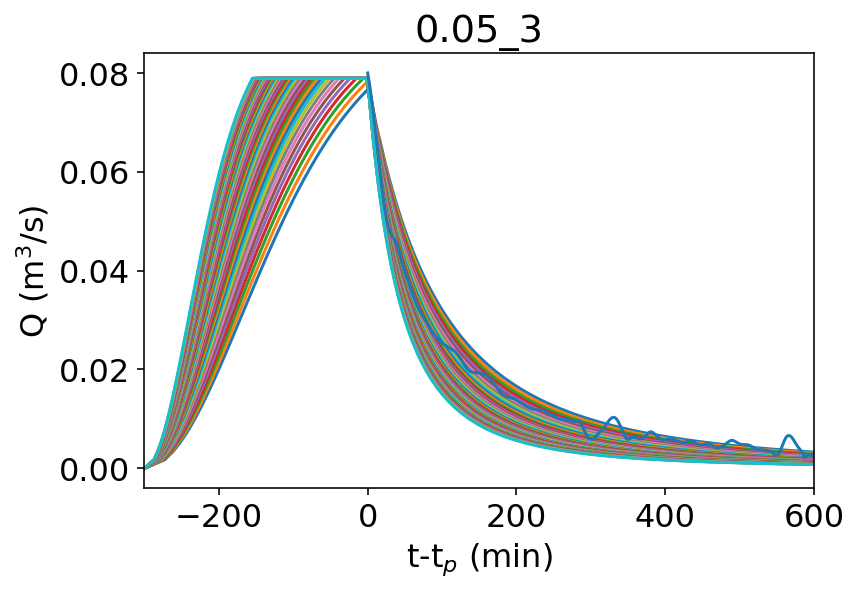

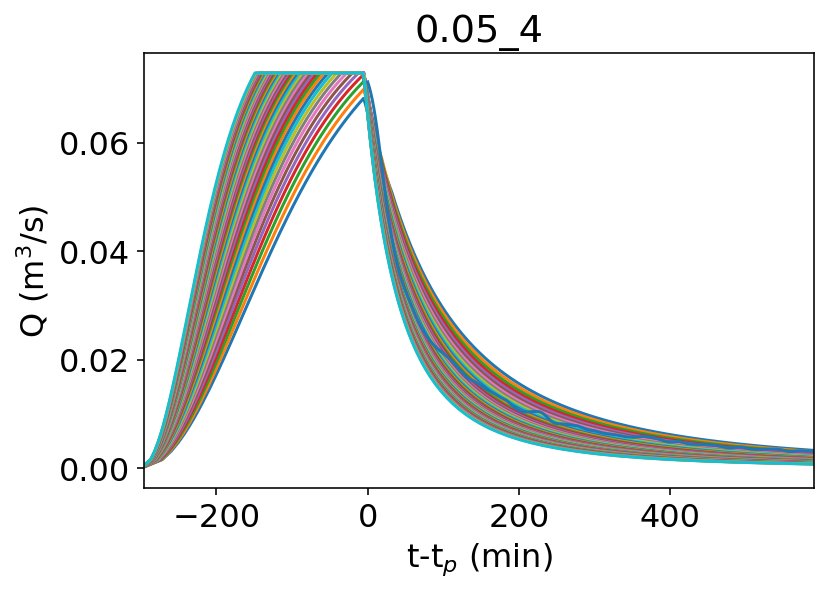

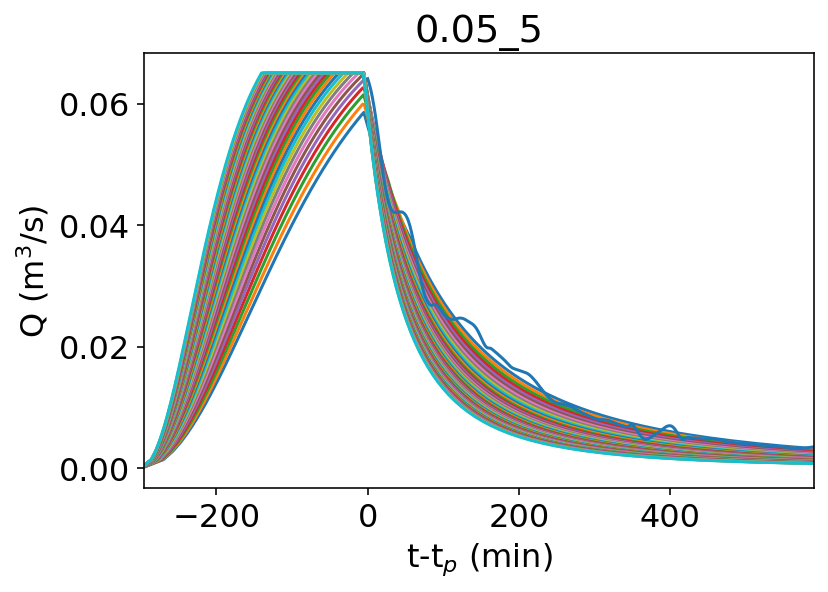

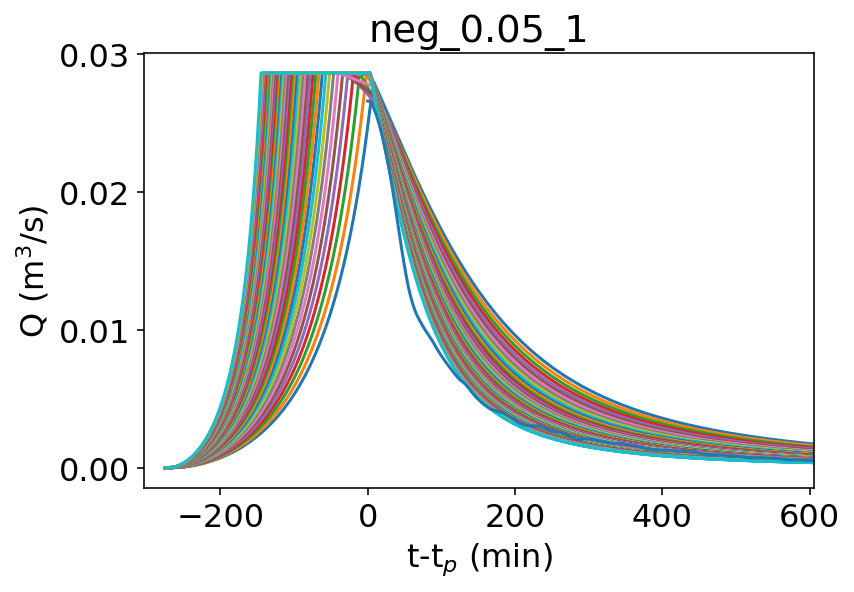

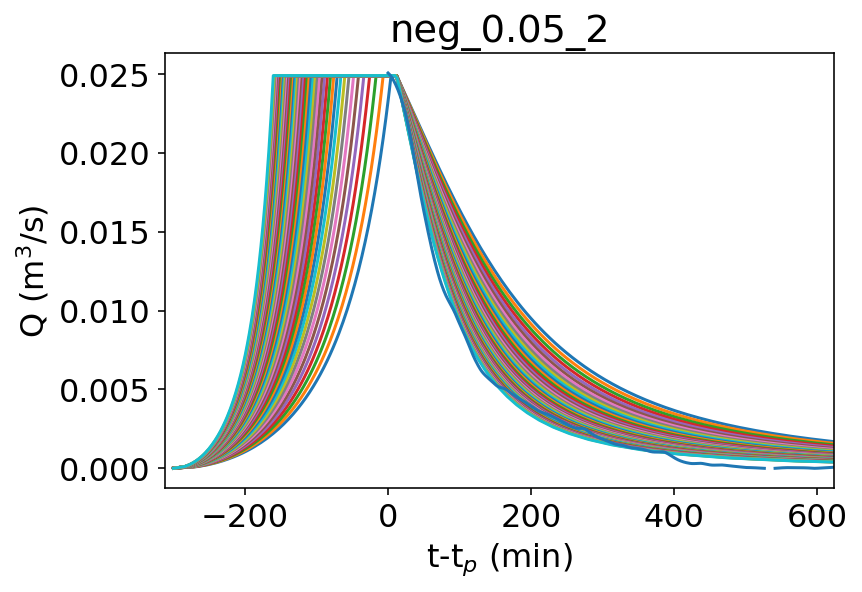

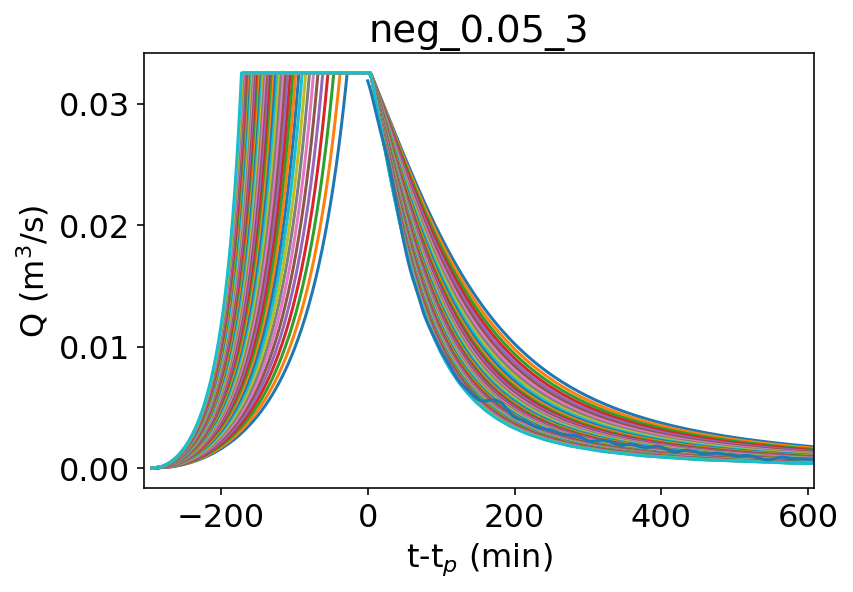

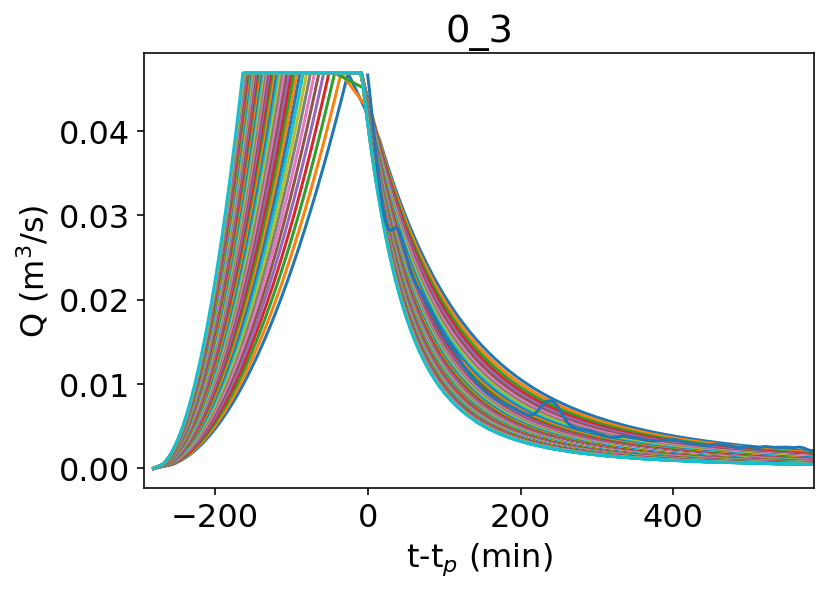

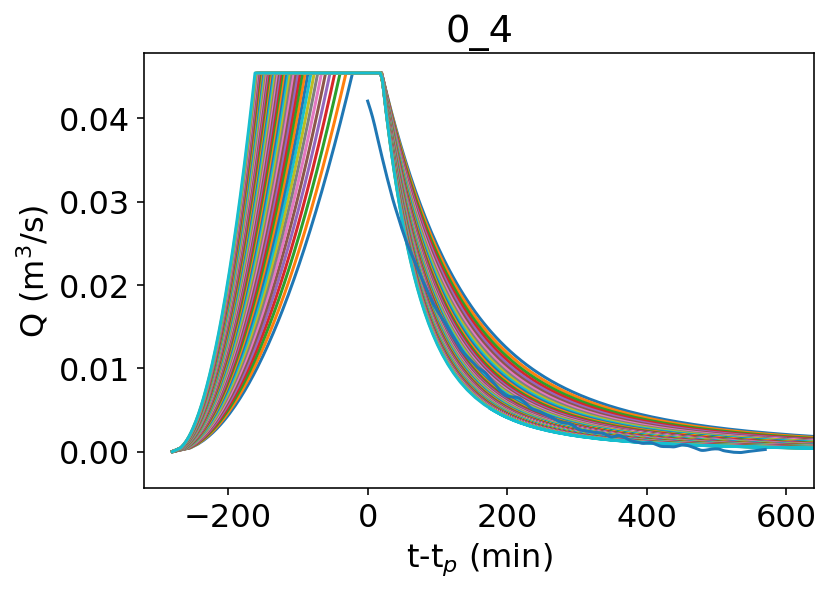

In [25]:
# this block plots hydrographs from the solutions with the correct values of a found above

                                                          # all outlet widths to the same value, ignore this and set
                                                          # outletSame = True
outletSame = False                                        # key that tells the program whether you want the outlet widths
                                                          # set individually by outlet_width or the same for all set by
                                                          # the number outlet

#matplotlib.rcParams.update({'font.size': 10})             # sets font size for figure


#%config InlineBackend.figure_format = 'retina'            # makes figure retina quality

# plot hydrographs

keylist = sim_info.keys() 

maxq = {aval:0 for aval in keylist}
for aval in keylist:                      # plots a hydrograph for each value of a
    for aa in alphalist:
        tr = sim_info[aval][4]
        if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
            xend=hillslopeSizeDict[aval][1]
            xtop=hillslopeSizeDict[aval][0]
        outlet = sim_info[aval][2]

        qouts=[]    # list of q values for hydrograph

        for i in range(len(houts_tot[aval][aa])):                      # loops through houts_tot[aval], the depth values saved from above
            qouts= qouts+[(aa*(houts_tot[aval][aa][i])**2)*outlet]         # produces q values at each time

        maxq[aval]=max(qouts)


        tmin=[]  # list of time values in minutes for hydrograph

        for val in touts_tot[aval][aa]:      # converts time values to minutes and saves in tmin
            tmin=tmin+[float(val)-300]



        # plot q or Q, depending on user preference
        pylab.plot((tmin),(qouts),label='$alpha$ = '+str(aa))


        # searches for tc by finding the first time that the maximum value is hit since the max case is the equilibrium case
        k=0
        for i in range(len(qouts)):
            if maxq[aval]==qouts[i] and k==0:
                k=i

        # prints out the value of a, teq, and qmax
        #print(aval, 'teq = ',touts_tot[aval][aa][k], ' qmax = ',maxq[aval])

        # increases the value of j, which is used for plotting labels
        j+=1

        plt.ylabel('Q (m$^3$/s)')

    plt.xlim(-tr,2*tr)                             # sets plot limit to 5 times storm lenth
    plt.xlabel('t-t$_p$ (min)')                     # x-axis label
    plt.title(aval)
    
    if aval=='0_4':
        plt.plot([aa-0.002 for aa in falling_limbs[aval]],label='experiment')
    else:
        plt.plot(falling_limbs[aval],label='experiment')

    #plt.legend() # adds a legend to the plot
    plt.show()


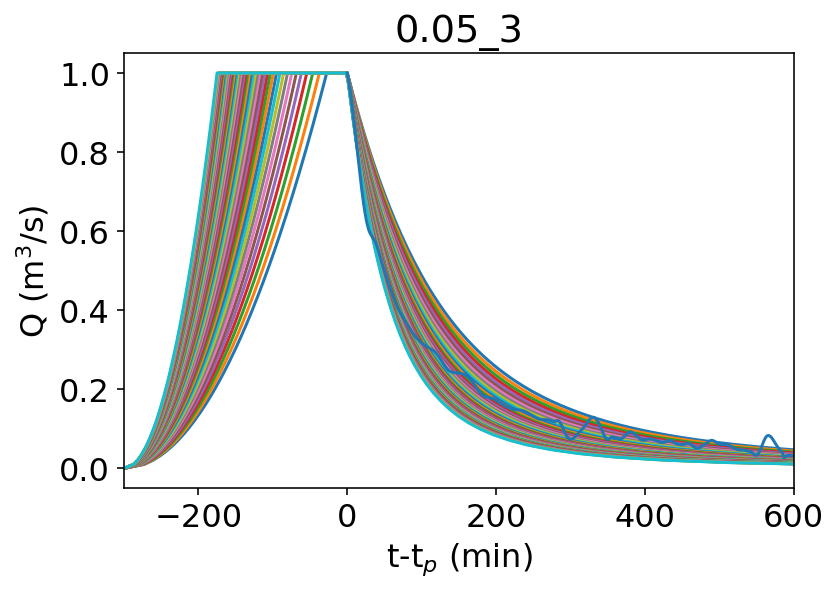

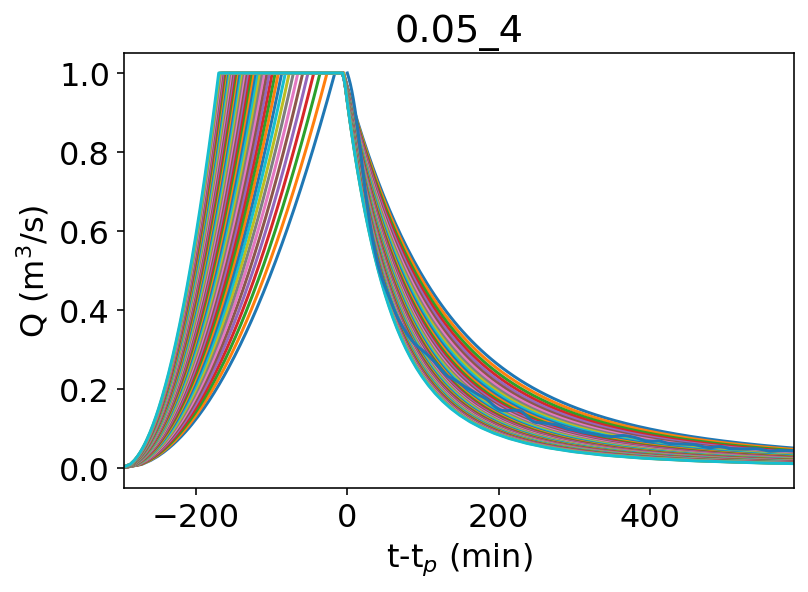

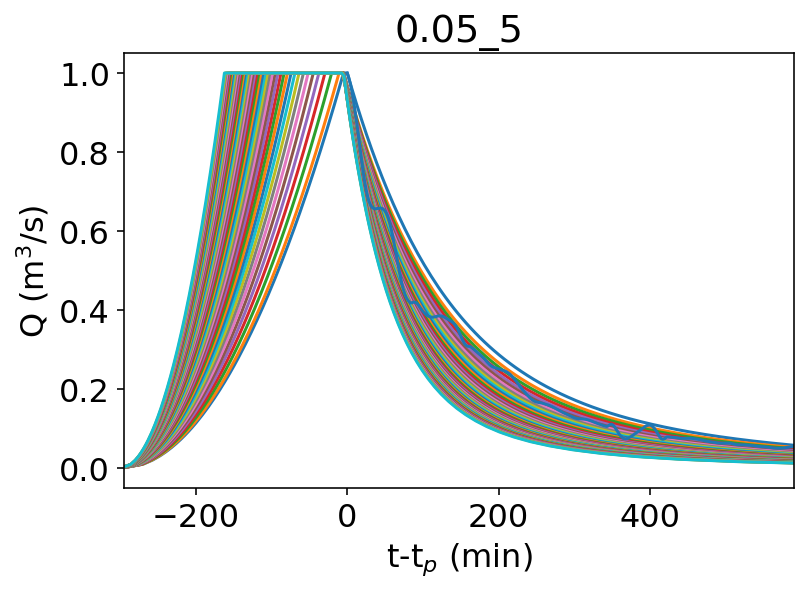

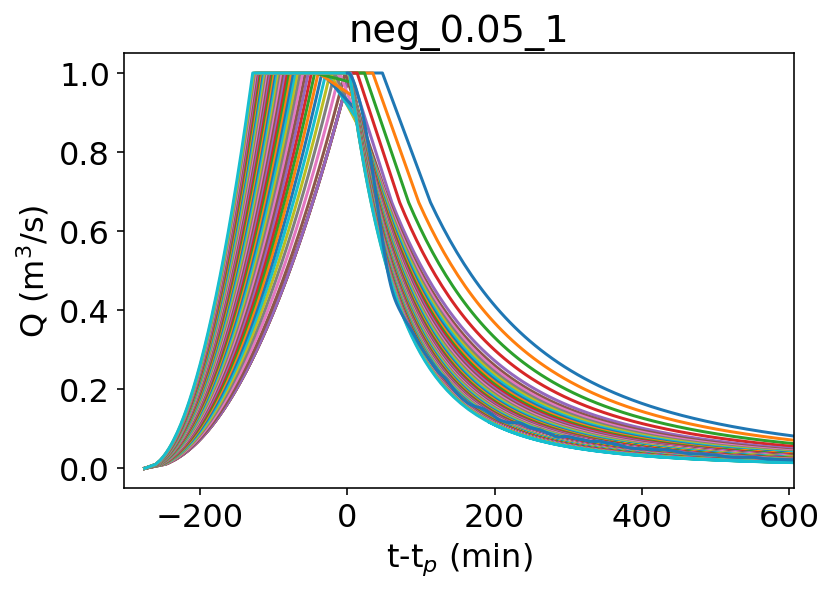

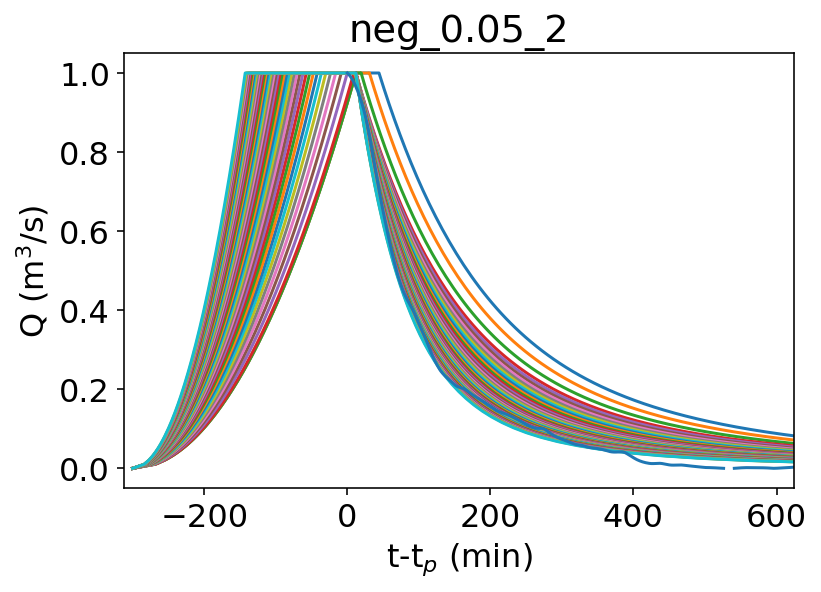

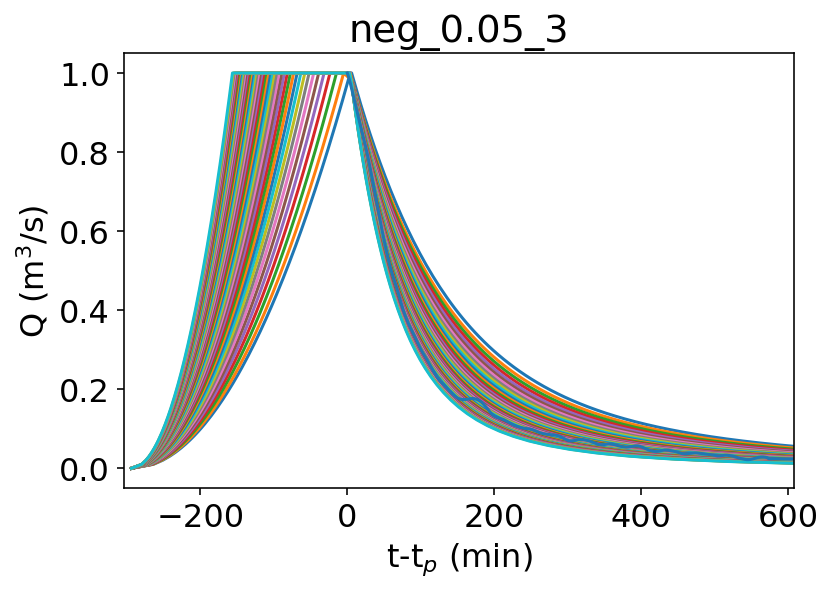

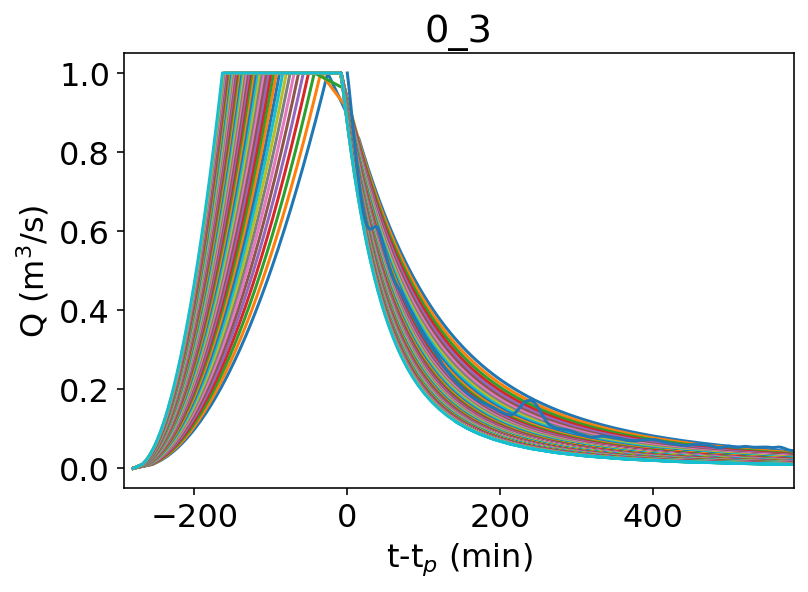

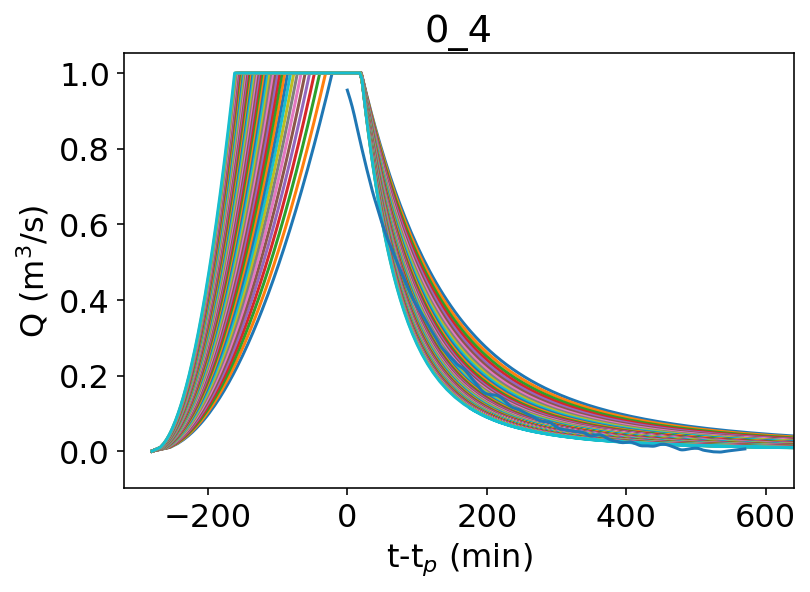

In [26]:
# this block plots hydrographs from the solutions found above using always a=0

                                                          # all outlet widths to the same value, ignore this and set
                                                          # outletSame = True
outletSame = False                                        # key that tells the program whether you want the outlet widths
                                                          # set individually by outlet_width or the same for all set by
                                                          # the number outlet

#matplotlib.rcParams.update({'font.size': 10})             # sets font size for figure


#%config InlineBackend.figure_format = 'retina'            # makes figure retina quality

# plot hydrographs

keylist = sim_info.keys() 

maxq = {aval:0 for aval in keylist}
for aval in keylist:                      # plots a hydrograph for each value of a
    for aa in alphalist:
        tr = sim_info[aval][4]
        if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
            xend=hillslopeSizeDict[aval][1]
            xtop=hillslopeSizeDict[aval][0]
        outlet = sim_info[aval][2]

        qouts=[]    # list of q values for hydrograph

        for i in range(len(houts_tot_1[aval][aa])):                      # loops through houts_tot[aval], the depth values saved from above
            qouts= qouts+[(aa*(houts_tot_1[aval][aa][i])**2)*outlet]         # produces q values at each time

        maxq[aval]=max(qouts)

        
        tmin=[]  # list of time values in minutes for hydrograph

        for val in touts_tot_1[aval][aa]:      # converts time values to minutes and saves in tmin
            tmin=tmin+[float(val)-300]

        qoutplot = [q/maxq[aval] for q in qouts]

        # plot q or Q, depending on user preference
        pylab.plot((tmin),(qoutplot),label='$alpha$ = '+str(aa))


        # searches for tc by finding the first time that the maximum value is hit since the max case is the equilibrium case
        k=0
        for i in range(len(qouts)):
            if maxq[aval]==qouts[i] and k==0:
                k=i

        # prints out the value of a, teq, and qmax
        #print(aval, 'teq = ',touts_tot[aval][aa][k], ' qmax = ',maxq[aval])

        # increases the value of j, which is used for plotting labels
        j+=1

        plt.ylabel('Q (m$^3$/s)')

    plt.xlim(-tr,2*tr)                             # sets plot limit to 5 times storm lenth
    plt.xlabel('t-t$_p$ (min)')                     # x-axis label
    plt.title(aval)
    
    if aval=='0_4':
        fplot = [(aa-0.002)/max(falling_limbs[aval]) for aa in falling_limbs[aval]]
        plt.plot(fplot)
    else:
        fplot=[aa/max(falling_limbs[aval]) for aa in falling_limbs[aval]]
        plt.plot(fplot)

    #plt.legend() # adds a legend to the plot
    plt.show()


/usr/local/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


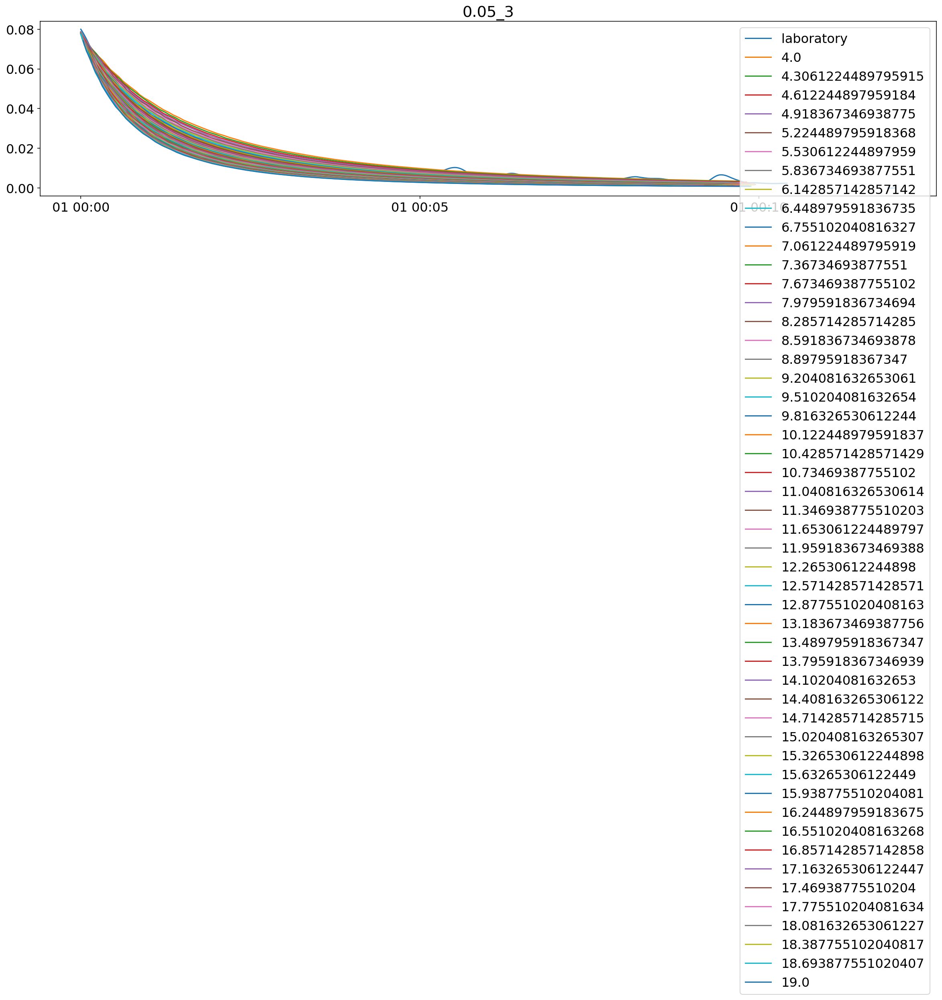

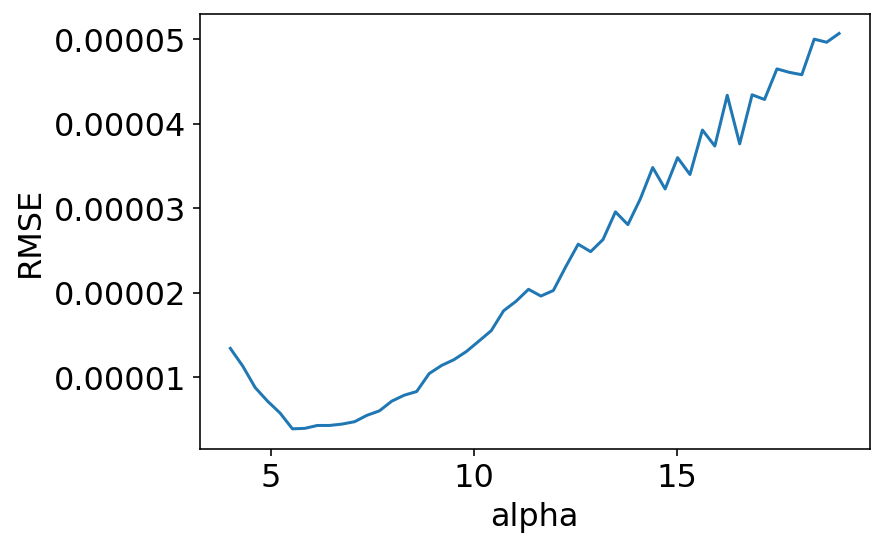

best alpha =  5.530612244897959


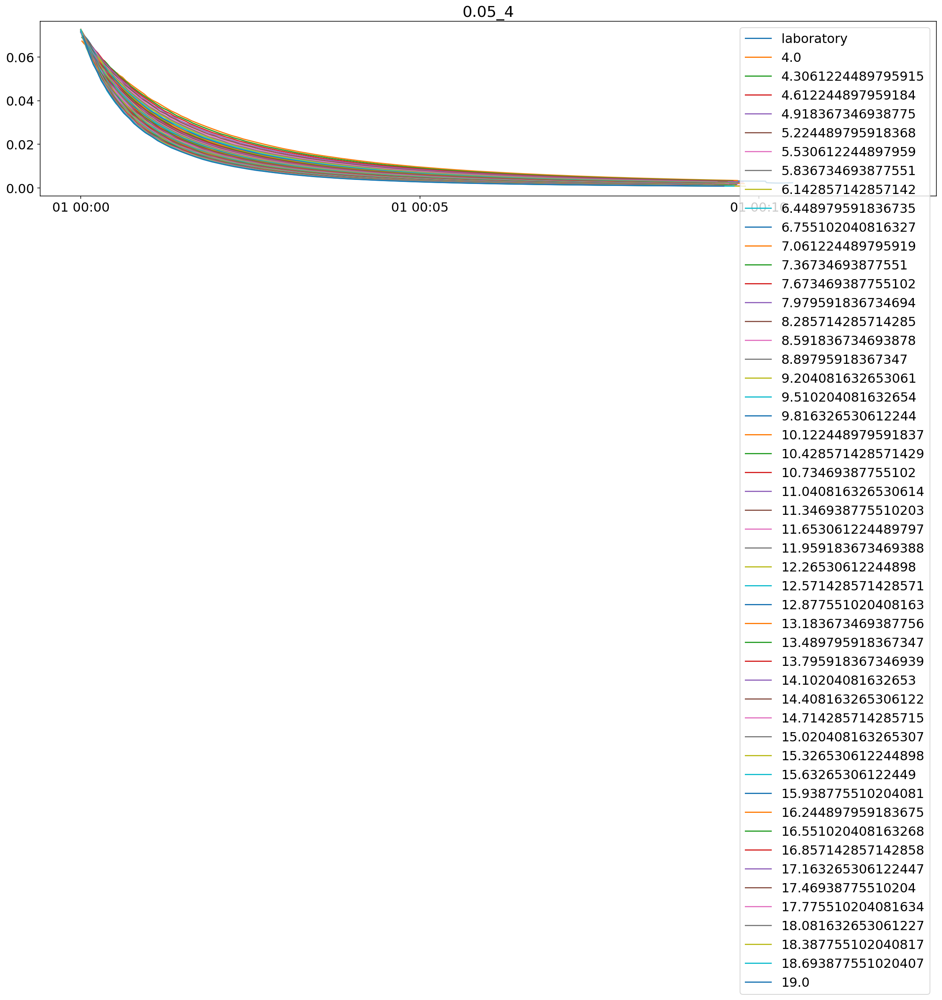

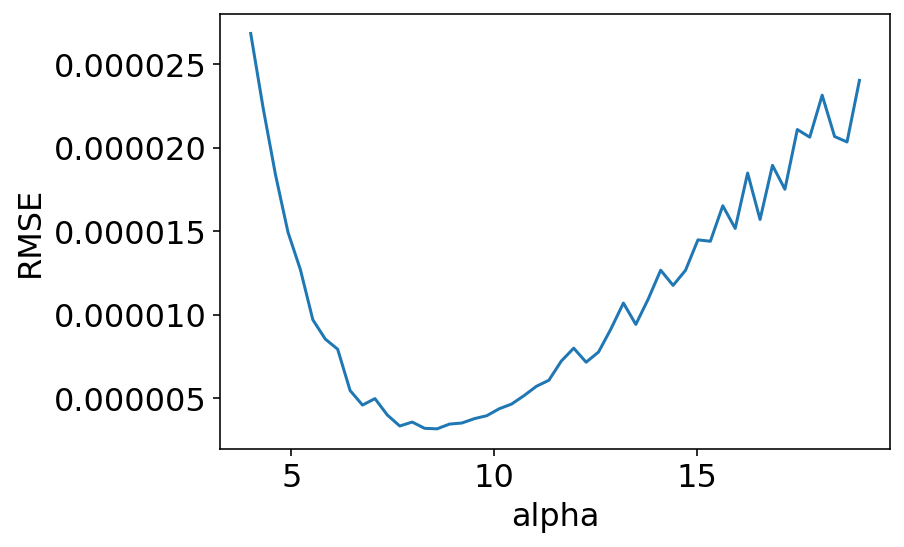

best alpha =  8.591836734693878


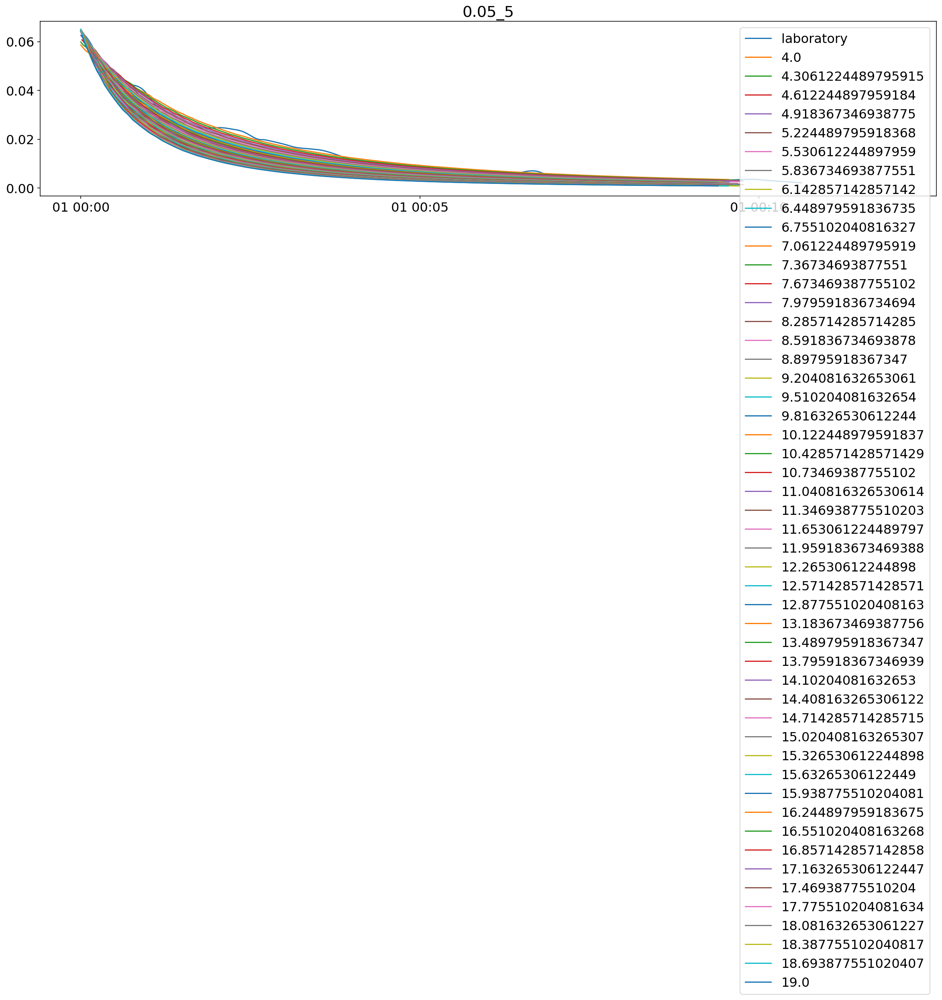

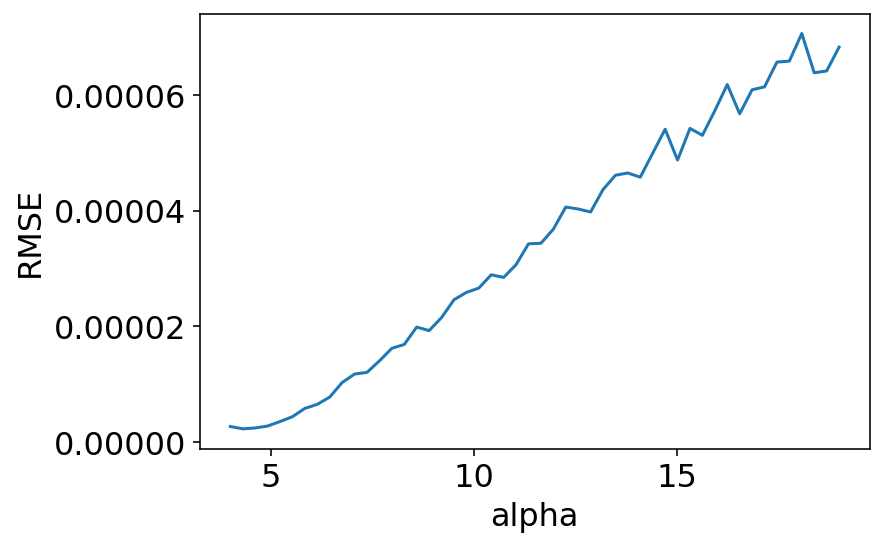

best alpha =  4.3061224489795915


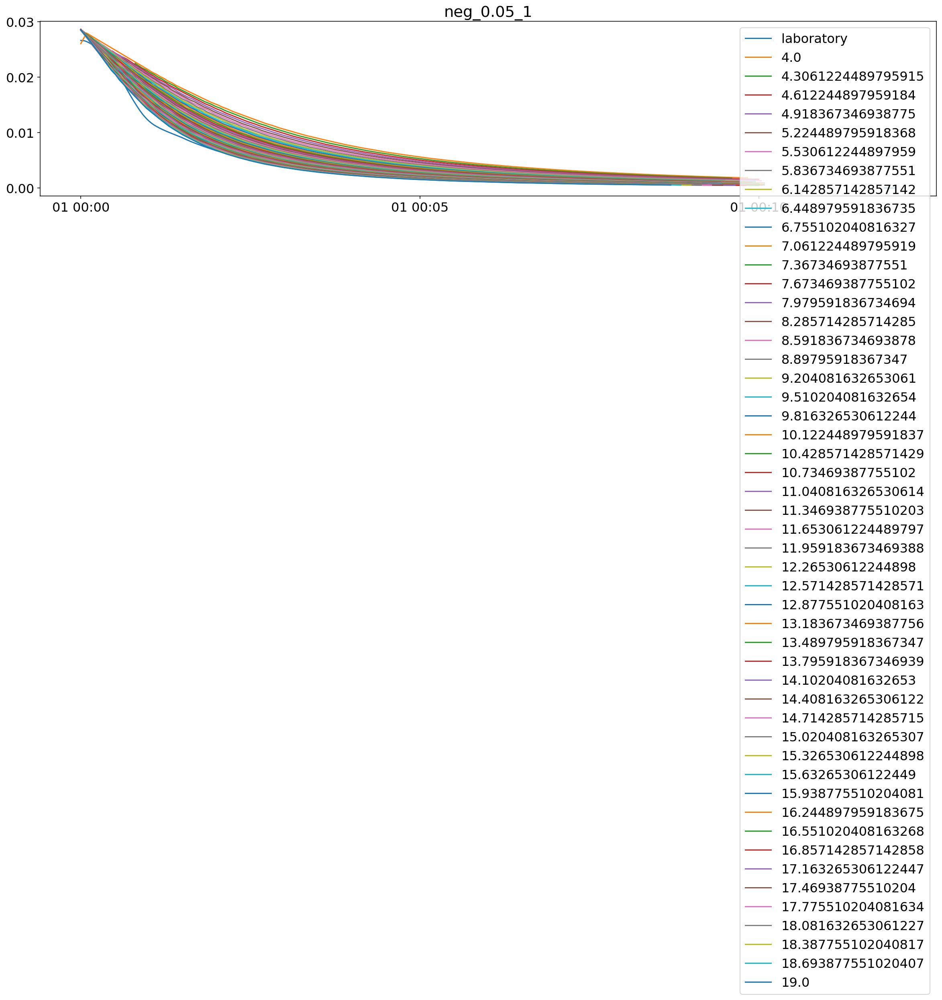

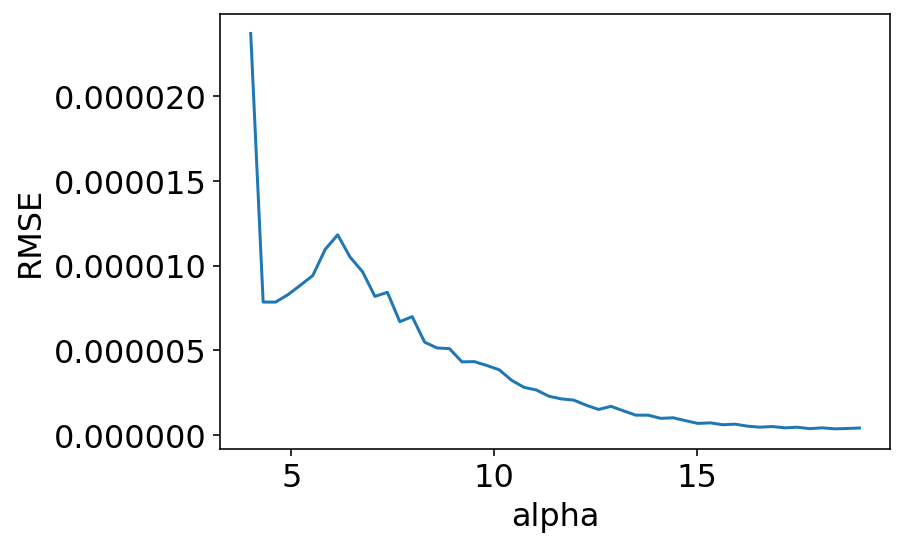

best alpha =  18.387755102040817


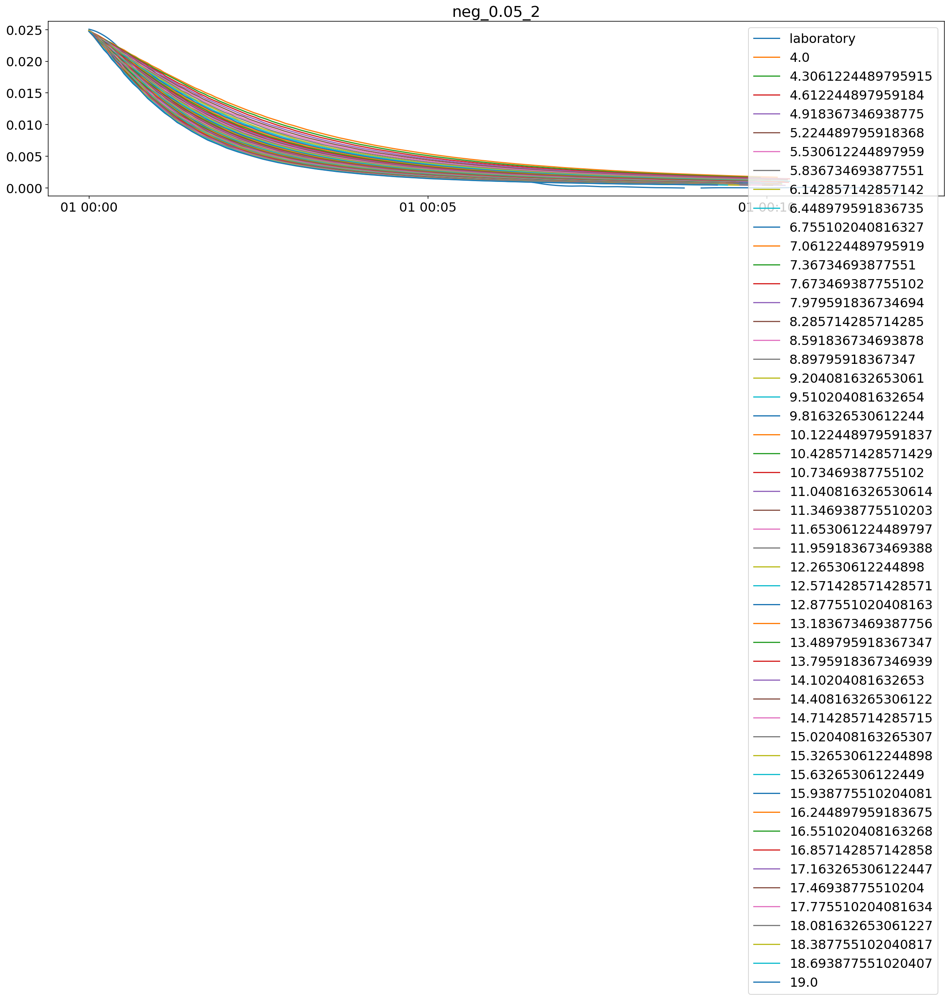

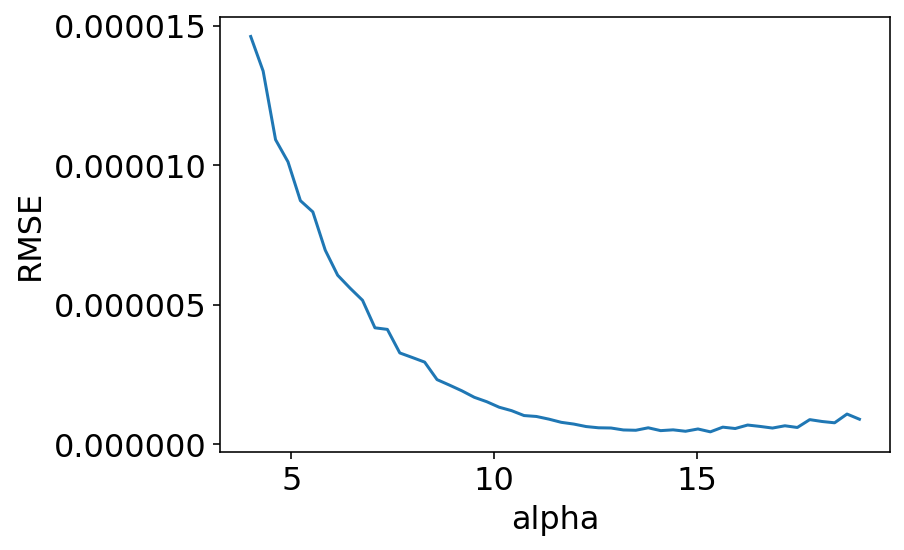

best alpha =  15.326530612244898


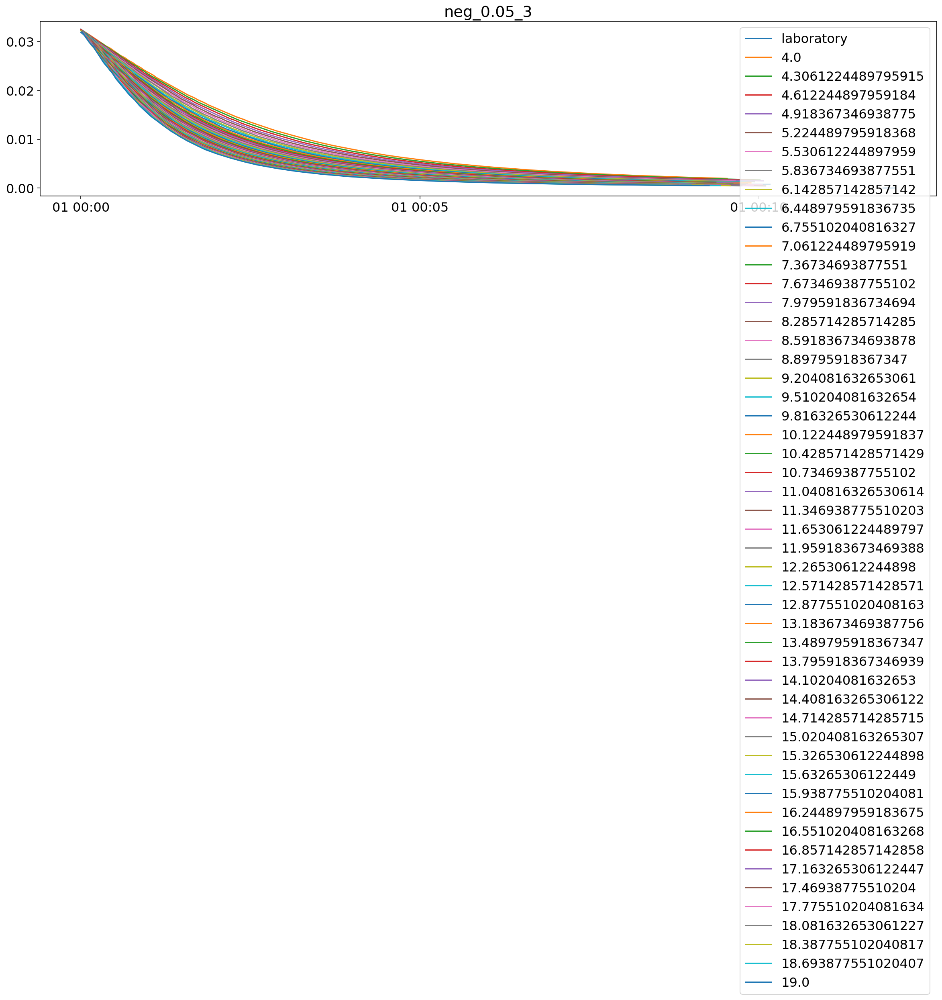

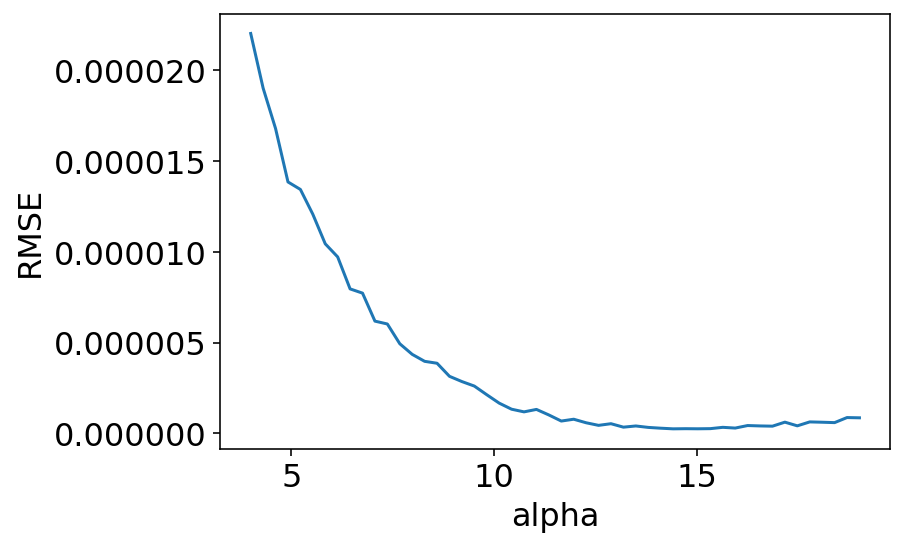

best alpha =  14.408163265306122


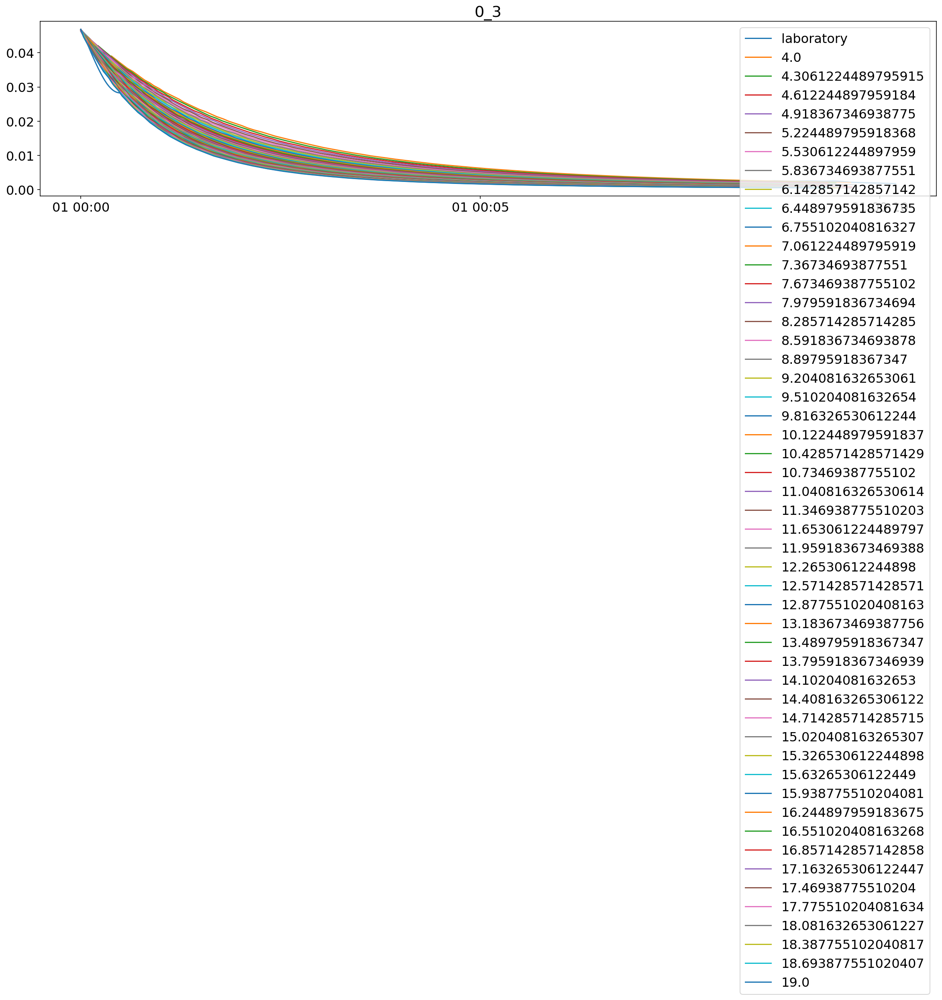

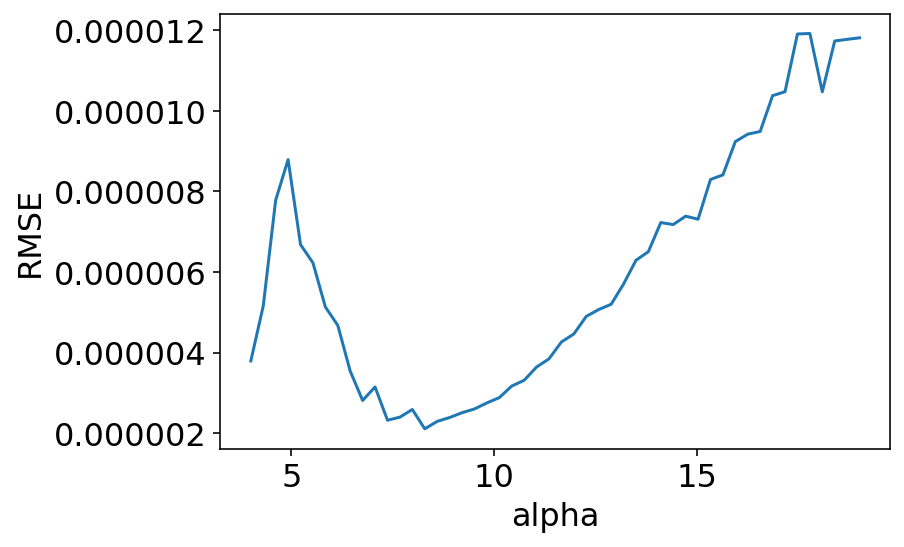

best alpha =  8.285714285714285


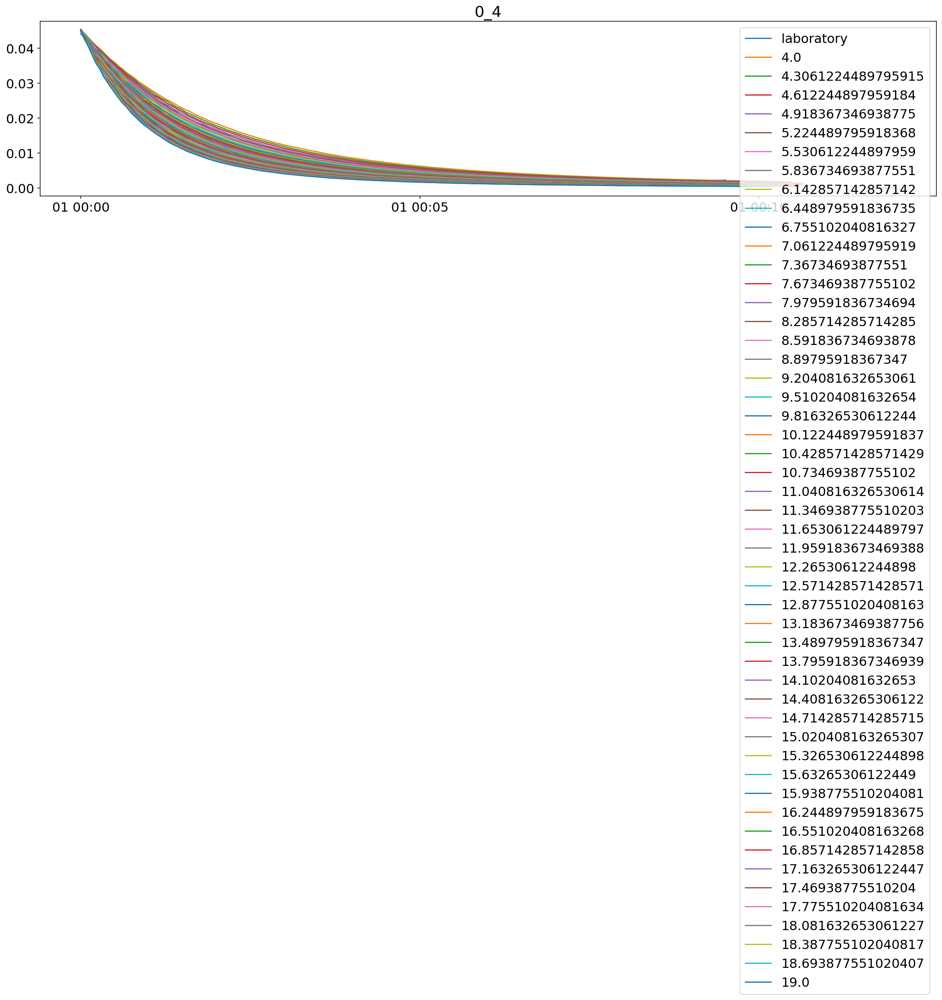

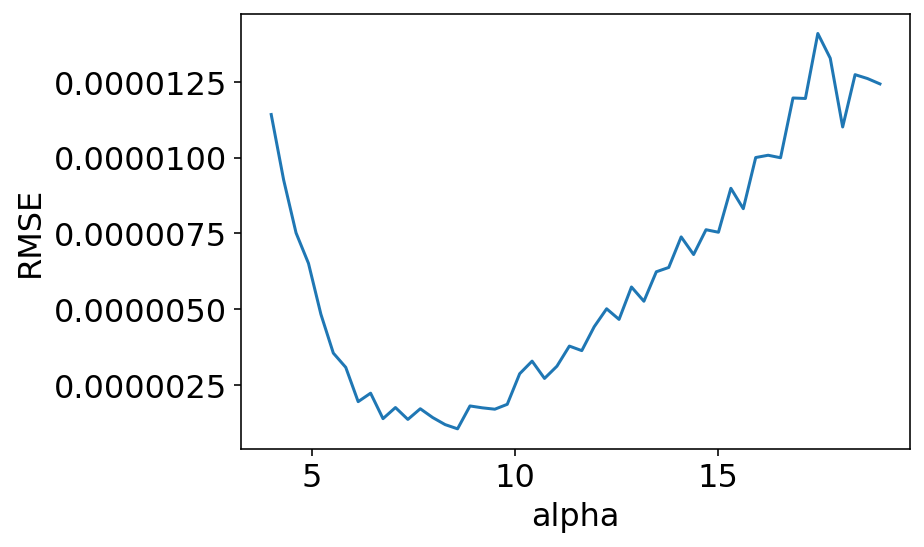

best alpha =  8.591836734693878
{'0.05_3': [0.05, 37.391999999999996, 37.012, 126.06440657827679, 300, 5.530612244897959], '0.05_4': [0.05, 37.391999999999996, 37.012, 116.2931412840595, 295, 8.591836734693878], '0.05_5': [0.05, 37.391999999999996, 37.012, 103.92064120009746, 295, 4.3061224489795915], 'neg_0.05_1': [-0.05, 28.246, 6.67, 69.14969686308883, 303, 18.387755102040817], 'neg_0.05_2': [-0.05, 28.246, 6.67, 60.09557160644768, 312, 15.326530612244898], 'neg_0.05_3': [-0.05, 28.246, 6.67, 78.5269287824788, 304, 14.408163265306122], '0_3': [0.0, 26.187, 17.69, 101.23483221324543, 292, 8.285714285714285], '0_4': [0.0, 26.187, 17.69, 98.1197450263743, 320, 8.591836734693878]}


In [27]:
# this block plots only the falling limb for the solutions with the correct a
# it then plots the RMSE between the experimental falling limb and analytical falling limb as a function of alpha
# the optimum alpha is chosen as the minimum of the function RMSE(alpha)

for aval in keylist: 
    plt.figure(figsize=(20,4))
    #print len(df_falling[aval])
    rmse = []
    aavals = []
    
    filer = df_falling[aval]
    filer.interpolate()
    filer.index = pd.to_datetime(nm.linspace(0,len(filer),len(filer)), unit='s')

    
    plt.plot(filer,label='laboratory')
    #plt.show()

    for aa in alphalist:
        #plt.figure(figsize=(20,4))
        tr = sim_info[aval][4]
        outlet = sim_info[aval][2]
        start=0
        end = 0
        for i in range(len(touts_tot[aval][aa])):
            if touts_tot[aval][aa][i]>=tr and start==0:
                start=i
            if touts_tot[aval][aa][i]>=tr*3 and end==0:
                end = i
        falling_t = [tt-tr for tt in touts_tot[aval][aa][start:end]]
        falling_q = [h**2.*aa*outlet for h in houts_tot[aval][aa][start:end]]
        #plt.plot(falling_t,falling_q)
        #print falling_t
        
        df = pd.DataFrame({'q': falling_q})
        df.index = pd.to_datetime([t*1. for t in falling_t],unit = 's')

        s_resampled_data = df.resample('1s').mean()
        s_resampled_data = s_resampled_data.interpolate()
        #print s_resampled_data.head()

        
        plt.plot(s_resampled_data,label=aa)
        #plt.show()

        #print filer_resampled['sum'][s_resampled_data.idxmin()]

        
        aavals = aavals + [aa]
        if aval=='0_4':
            
            try:
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],[s+0.002 for s in s_resampled_data['q'].tolist()])
                rmse = rmse + [ rms]
            except:
                for c in range(len(filer)):
                    if math.isnan(filer[c]):
                        filer[c] = 0.
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],[s+0.002 for s in s_resampled_data['q'].tolist()])
                rmse = rmse + [ rms]
        else:
            try:
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
                rmse = rmse + [ rms]
            except:
                for c in range(len(filer)):
                    if math.isnan(filer[c]):
                        filer[c] = 0.
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
                rmse = rmse + [ rms]
        
    plt.legend()
    #plt.xlim(min())
    plt.title(aval)
    plt.show()

    plt.plot(aavals,rmse)
    plt.xlabel('alpha')
    plt.ylabel('RMSE')
    plt.show()   
    
    val, idx = min((val, idx) for (idx, val) in enumerate(rmse))
    print ('best alpha = ',aavals[idx])
    try:
        sim_info[aval][5] = aavals[idx]
    except:
        sim_info[aval] = sim_info[aval]+[aavals[idx]]
    
print (sim_info)

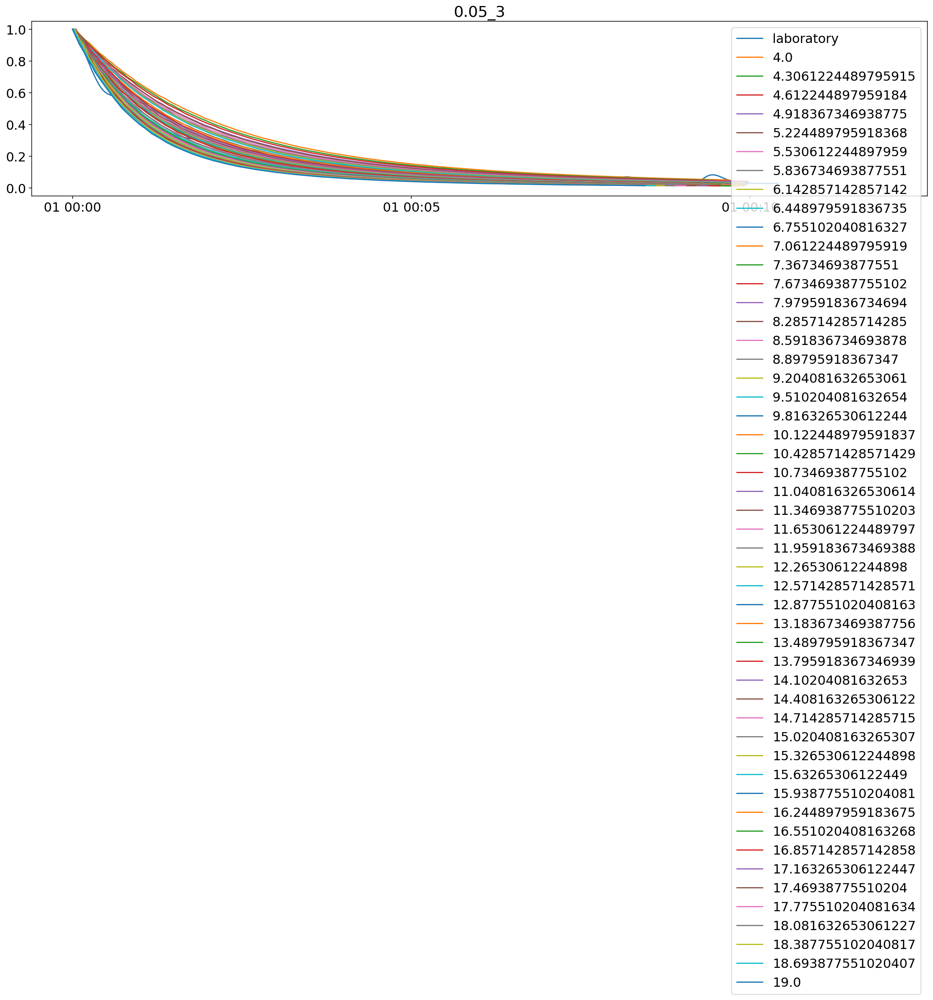

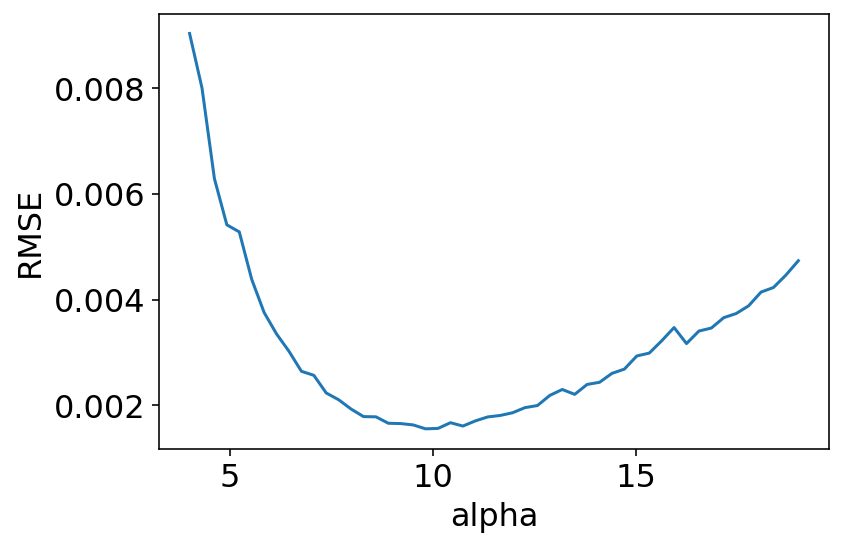

best alpha =  9.816326530612244


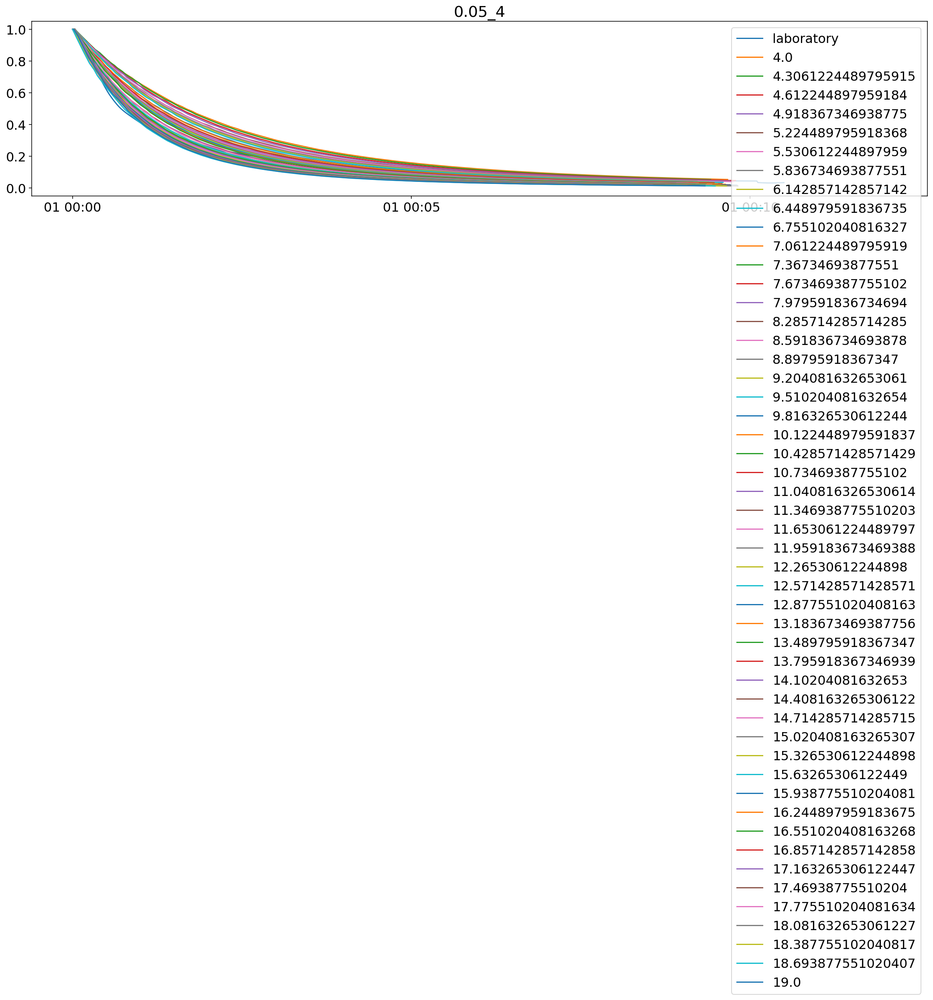

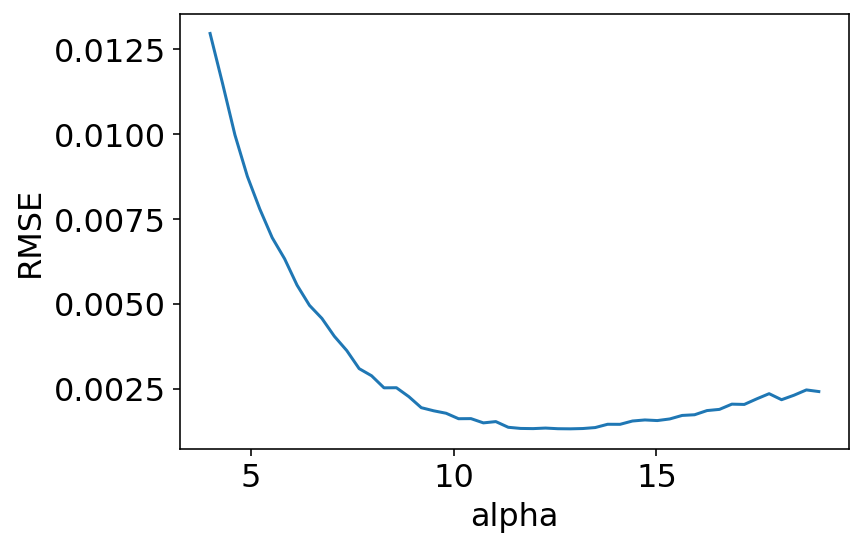

best alpha =  12.877551020408163


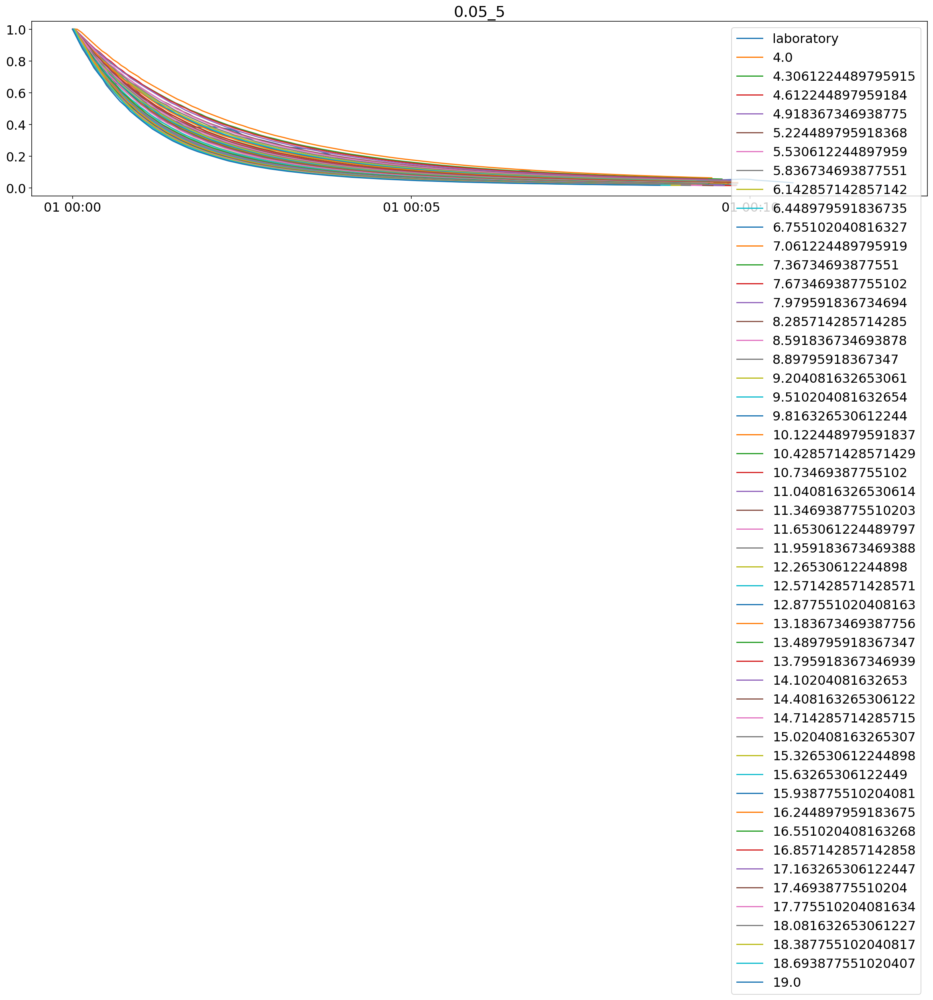

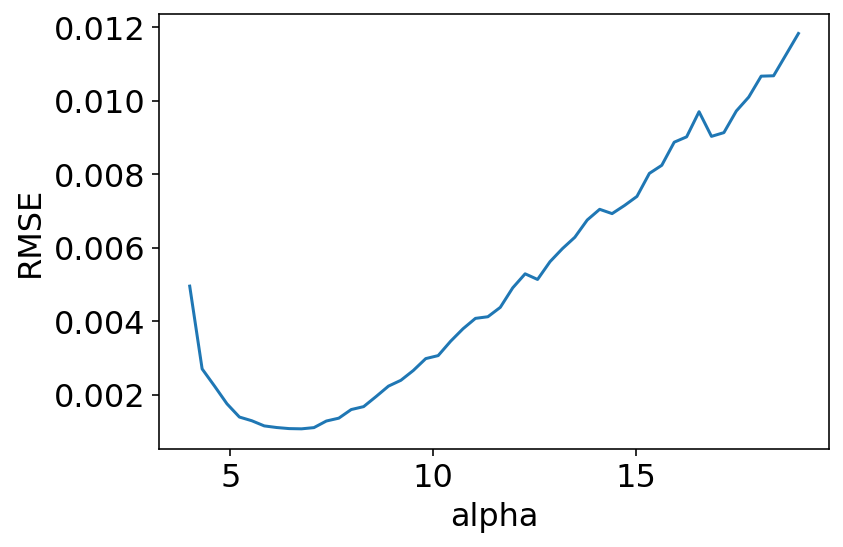

best alpha =  6.755102040816327


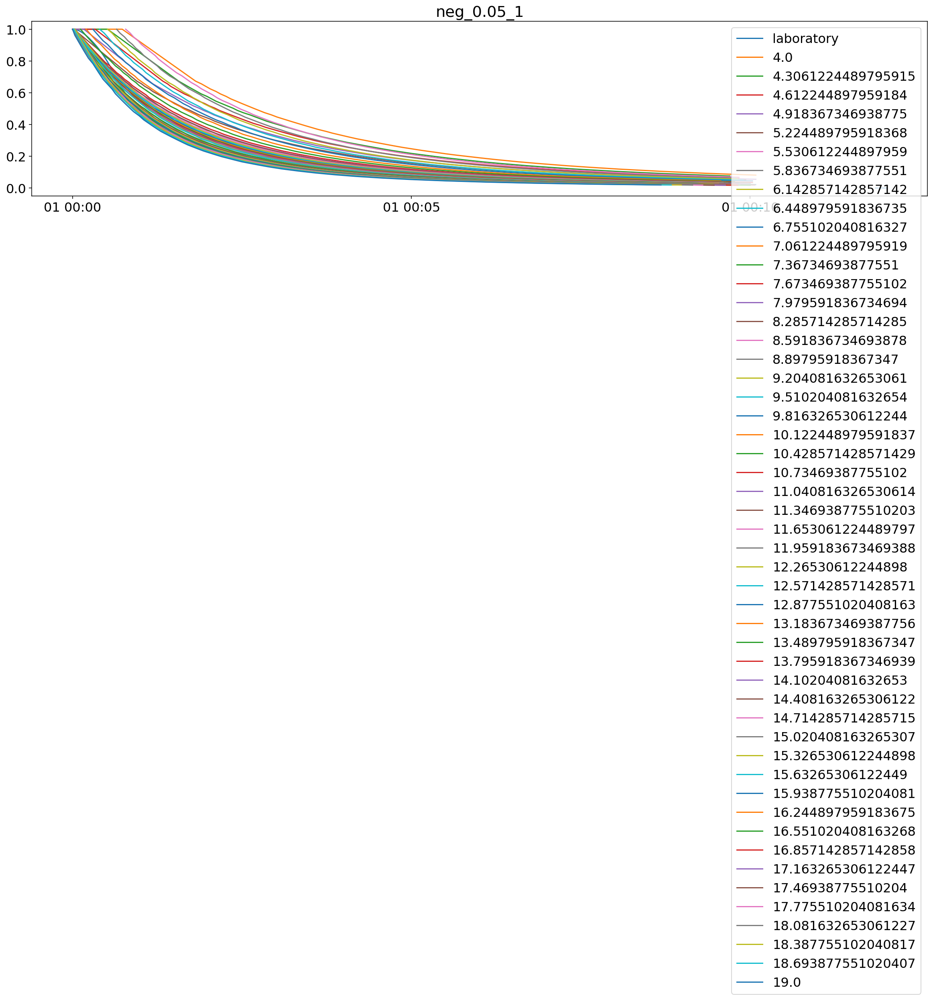

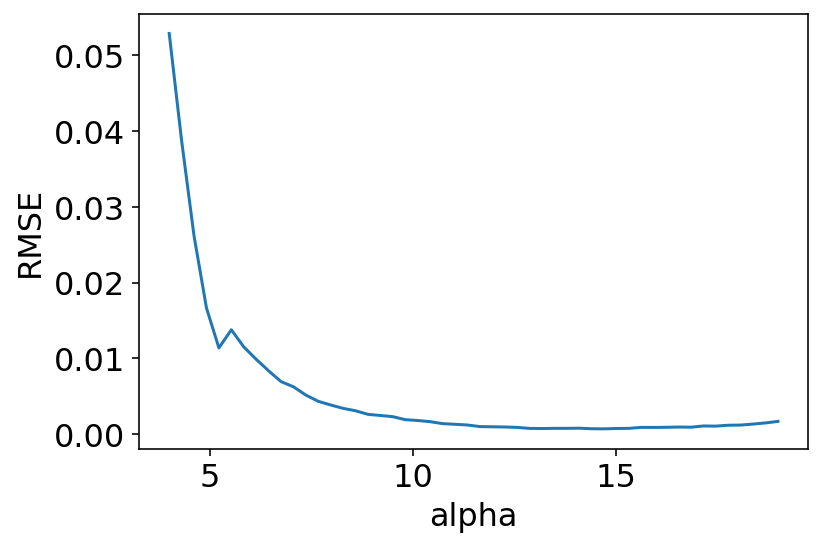

best alpha =  14.714285714285715


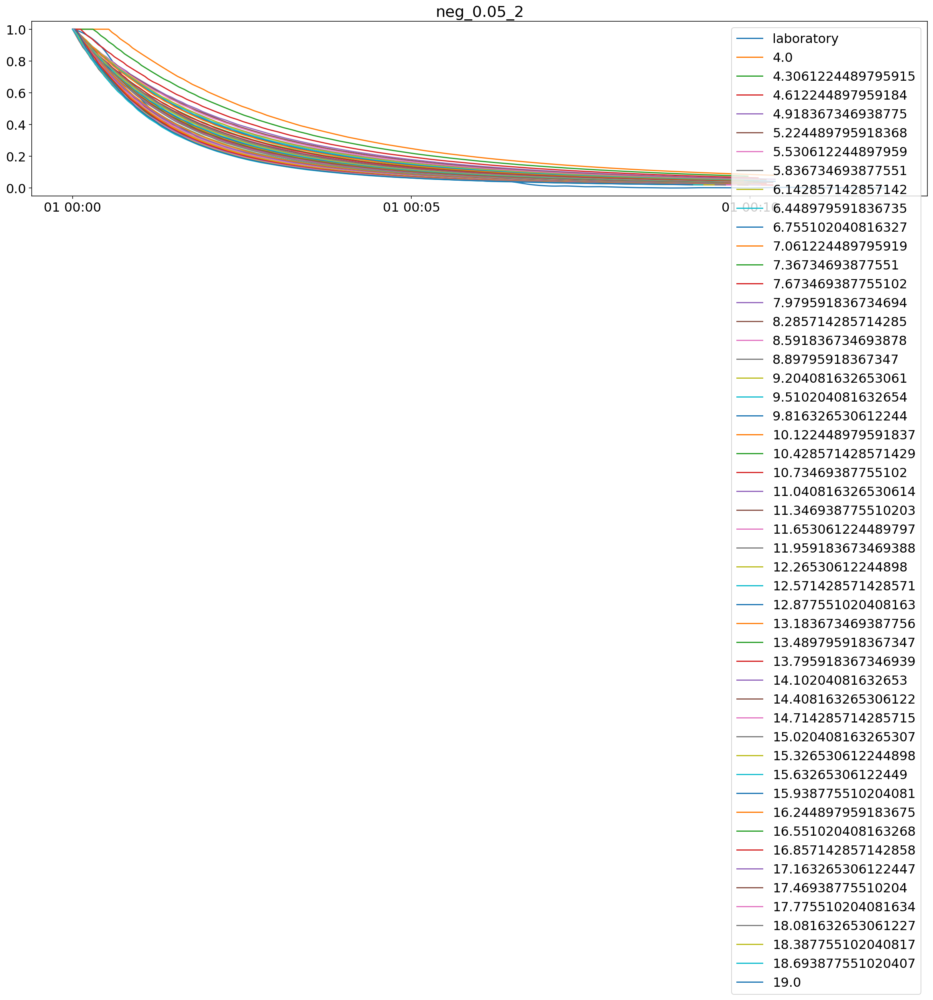

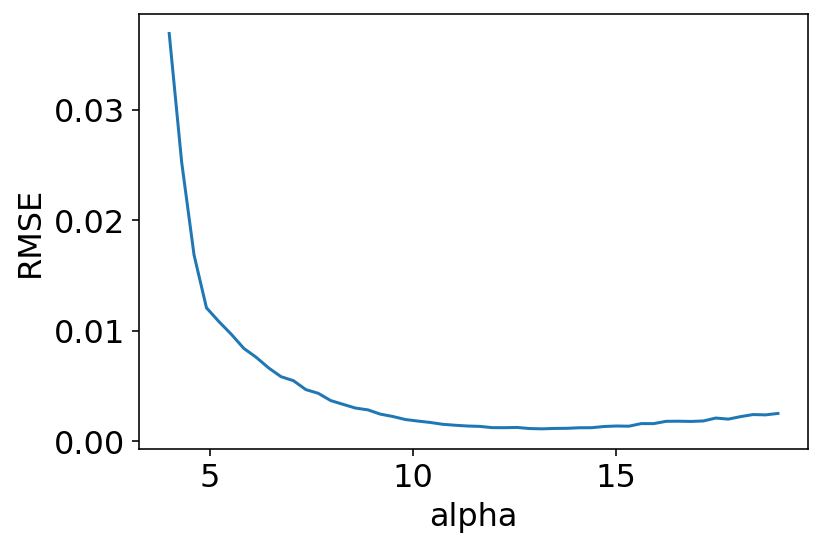

best alpha =  13.183673469387756


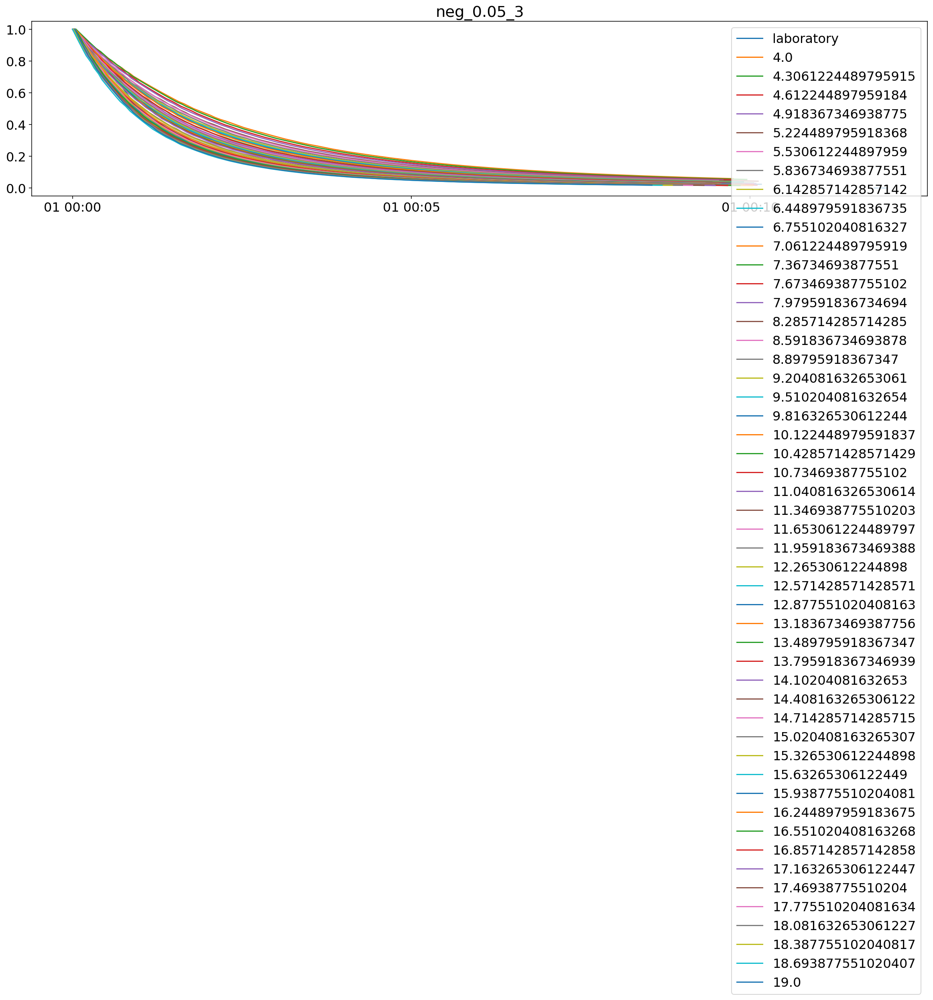

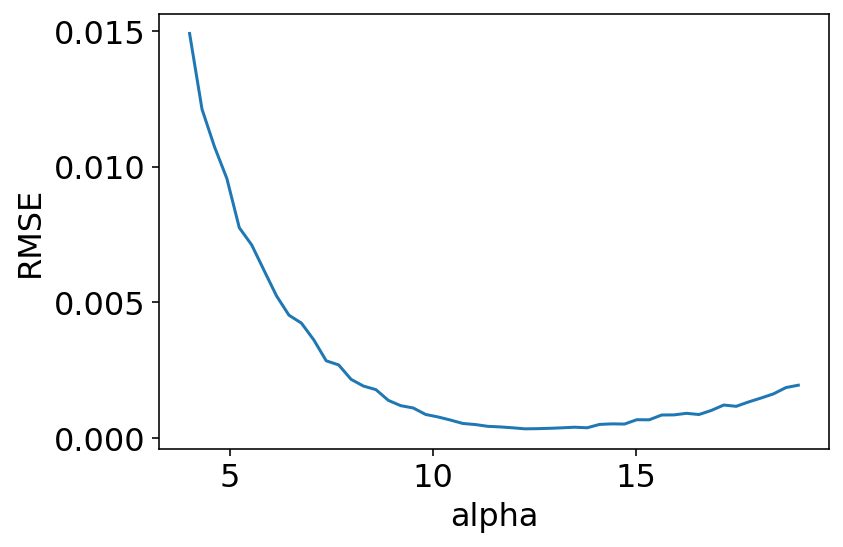

best alpha =  12.26530612244898


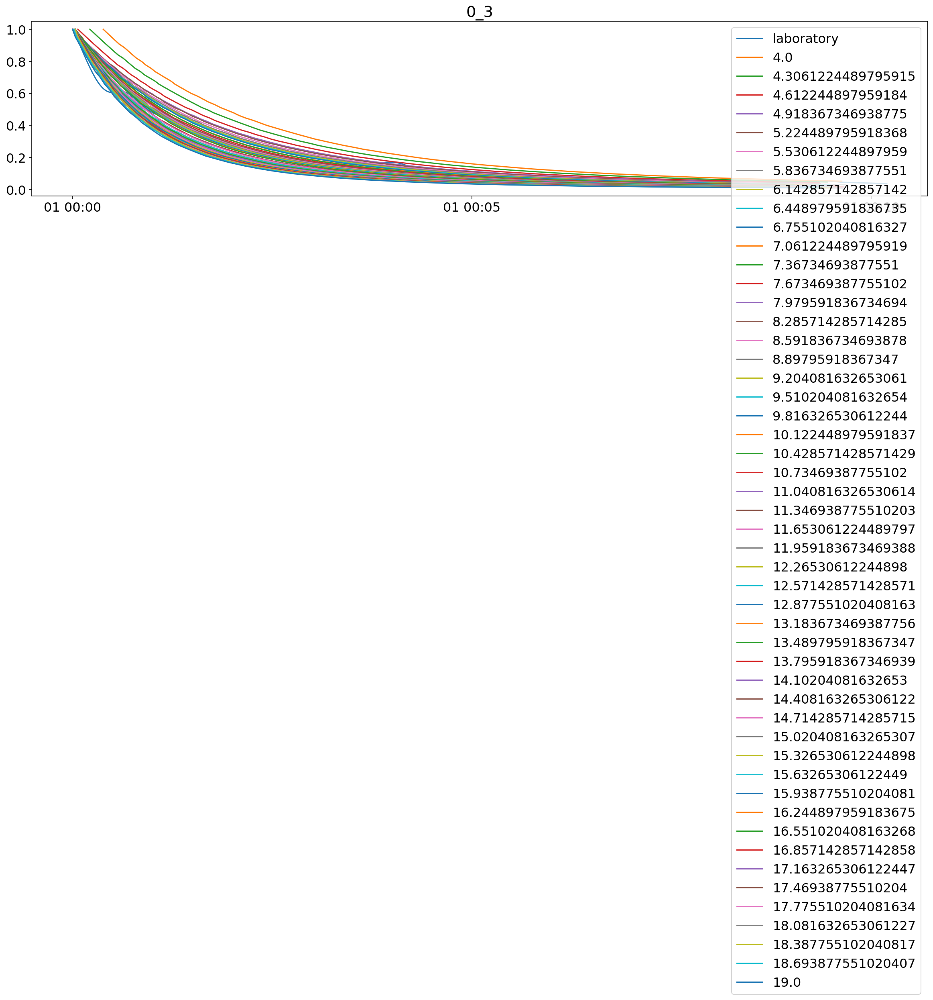

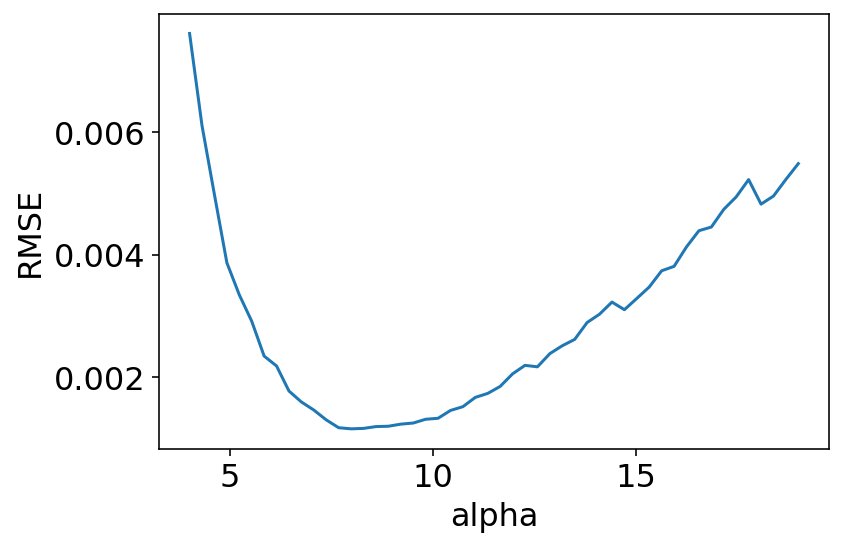

best alpha =  7.979591836734694


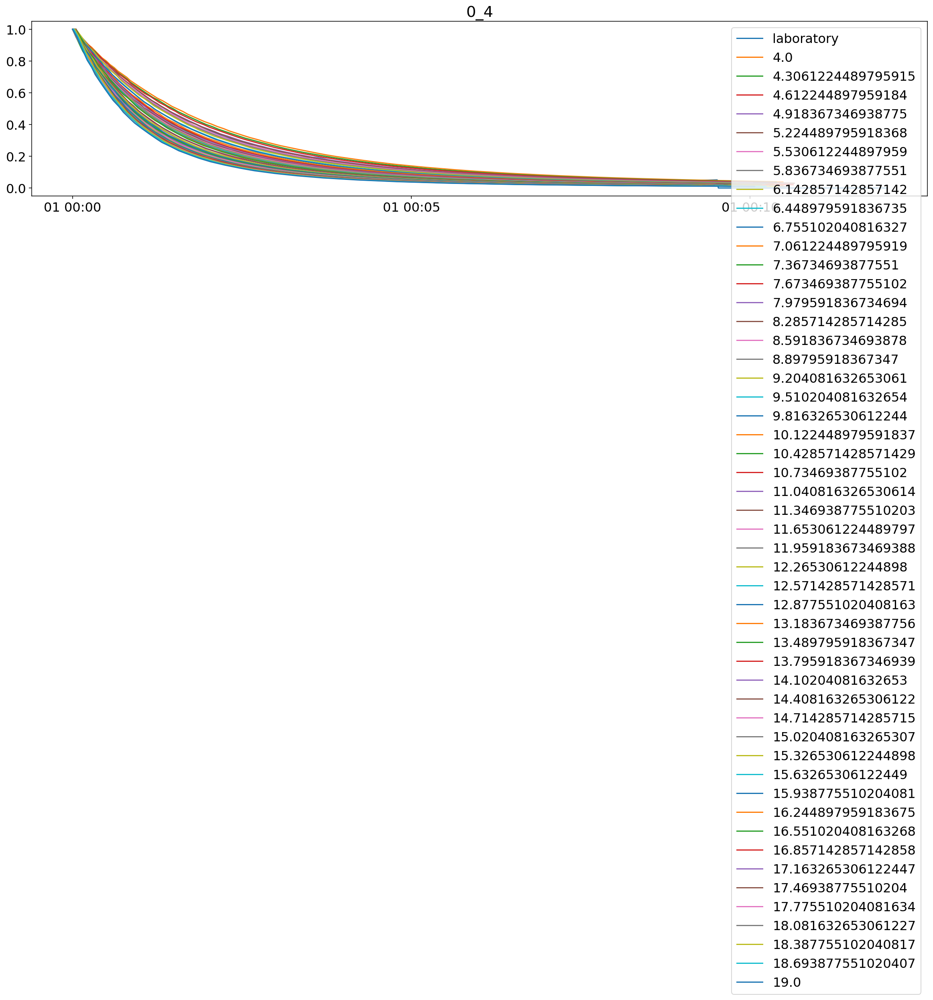

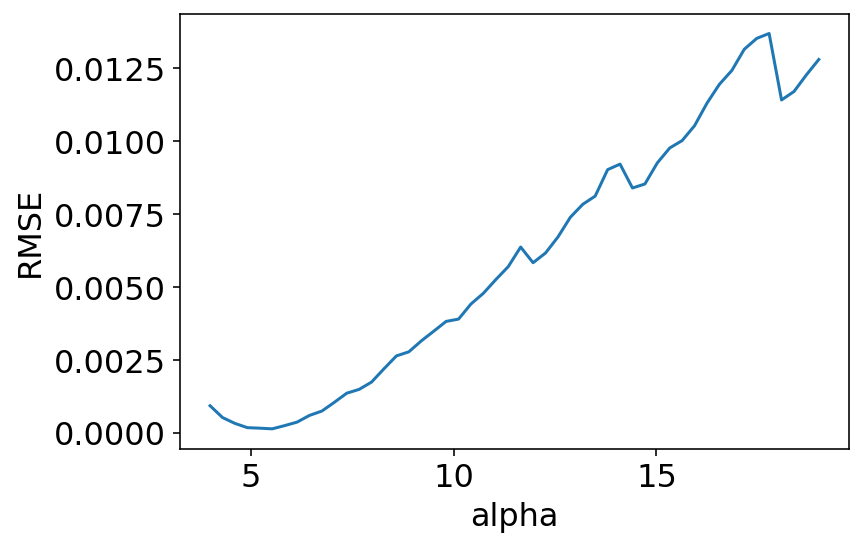

best alpha =  5.530612244897959


In [28]:
# this block plots only the falling limb for the solutions with a=0
# it then plots the RMSE between the experimental falling limb and analytical falling limb as a function of alpha
# the optimum alpha is chosen as the minimum of the function RMSE(alpha)

nocurve_alpha = {aval:[0,0] for aval in keylist}

for aval in keylist: 
    plt.figure(figsize=(20,4))
    #print len(df_falling[aval])
    rmse = []
    aavals = []
    
    filer = df_falling[aval]/max(df_falling[aval])
    filer.interpolate()
    filer.index = pd.to_datetime(nm.linspace(0,len(filer),len(filer)), unit='s')

    
    plt.plot(filer,label='laboratory')
    #plt.show()

    for aa in alphalist:
        #plt.figure(figsize=(20,4))
        tr = sim_info[aval][4]
        outlet = sim_info[aval][2]
        start=0
        end = 0
        for i in range(len(touts_tot_1[aval][aa])):
            if touts_tot_1[aval][aa][i]>=tr and start==0:
                start=i
            if touts_tot_1[aval][aa][i]>=tr*3 and end==0:
                end = i
        falling_t = [tt-tr for tt in touts_tot_1[aval][aa][start:end]]
        falling_q_p = [h**2.*aa*outlet for h in houts_tot_1[aval][aa][start:end]]
        #plt.plot(falling_t,falling_q)
        #print falling_t
        falling_q = [f/max(falling_q_p) for f in falling_q_p]
        
        df = pd.DataFrame({'q': falling_q})
        df.index = pd.to_datetime([t*1. for t in falling_t],unit = 's')

        s_resampled_data = df.resample('1s').mean()
        s_resampled_data = s_resampled_data.interpolate()
        #print s_resampled_data.head()

        
        plt.plot(s_resampled_data,label=aa)
        #plt.show()

        #print filer_resampled['sum'][s_resampled_data.idxmin()]

        
        aavals = aavals + [aa]
        if aval=='0_4':
            
            try:
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],[s+0.002 for s in s_resampled_data['q'].tolist()])
                rmse = rmse + [ rms]
            except:
                for c in range(len(filer)):
                    if math.isnan(filer[c]):
                        filer[c] = 0.
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],[s+0.002 for s in s_resampled_data['q'].tolist()])
                rmse = rmse + [ rms]
        else:
            try:
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
                rmse = rmse + [ rms]
            except:
                for c in range(len(filer)):
                    if math.isnan(filer[c]):
                        filer[c] = 0.
                rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
                rmse = rmse + [ rms]
        
    plt.legend()
    #plt.xlim(min())
    plt.title(aval)
    plt.show()

    plt.plot(aavals,rmse)
    plt.xlabel('alpha')
    plt.ylabel('RMSE')
    plt.show()   
    
    val, idx = min((val, idx) for (idx, val) in enumerate(rmse))
    print ('best alpha = ',aavals[idx])
    nocurve_alpha[aval][0]=aavals[idx]
    
#print (sim_info)

0.05_3 teq =  268.7806397580656  qmax =  0.07892966319811477


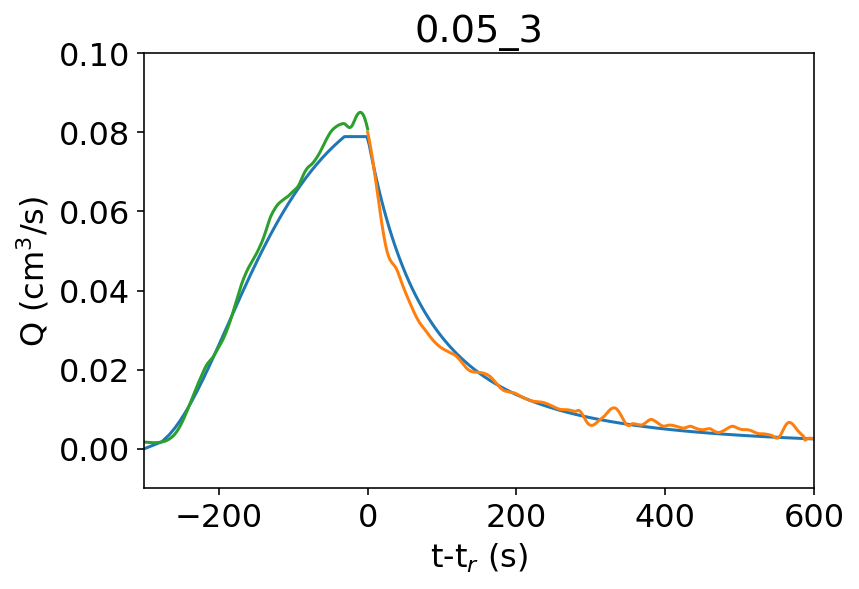

0.05_4 teq =  224.5229665987845  qmax =  0.07281181677638819


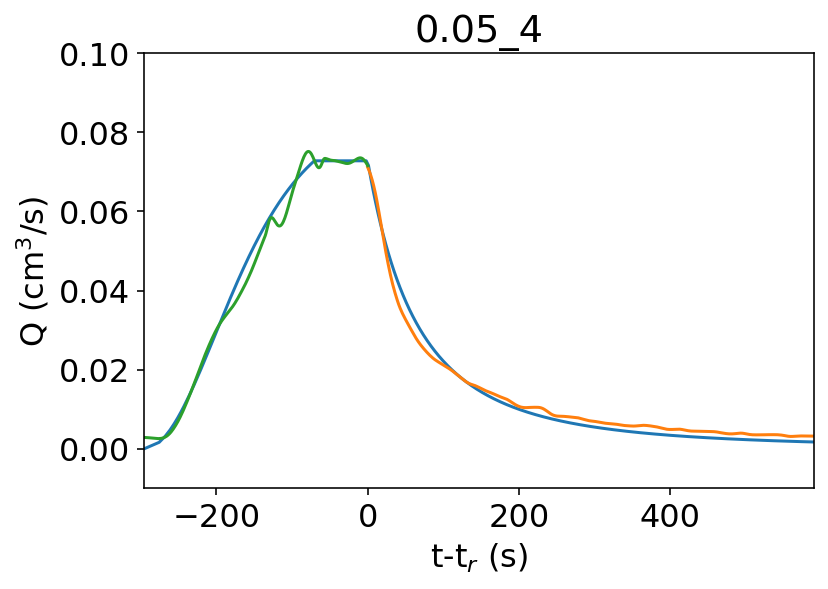

0.05_5 teq =  293.4619369998906  qmax =  0.059945830640869814


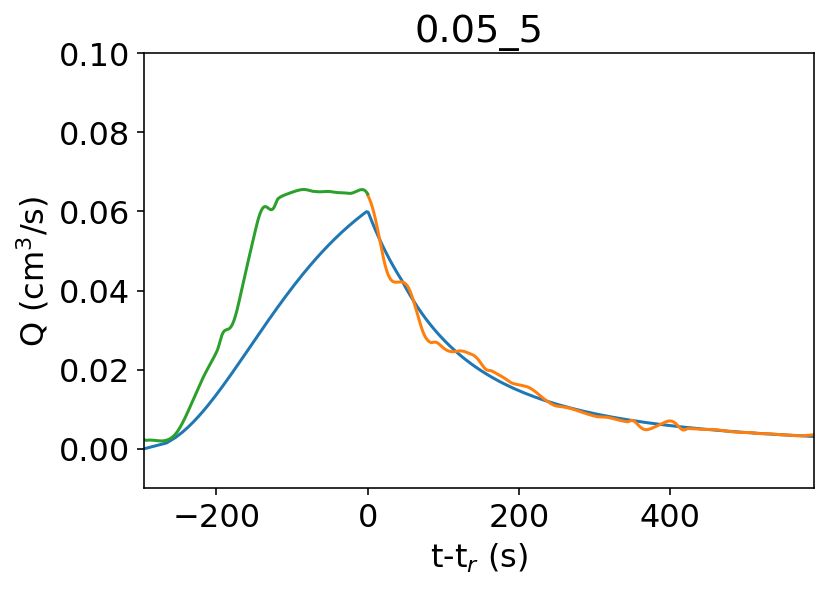

neg_0.05_1 teq =  157.26953578646012  qmax =  0.028645857876846505


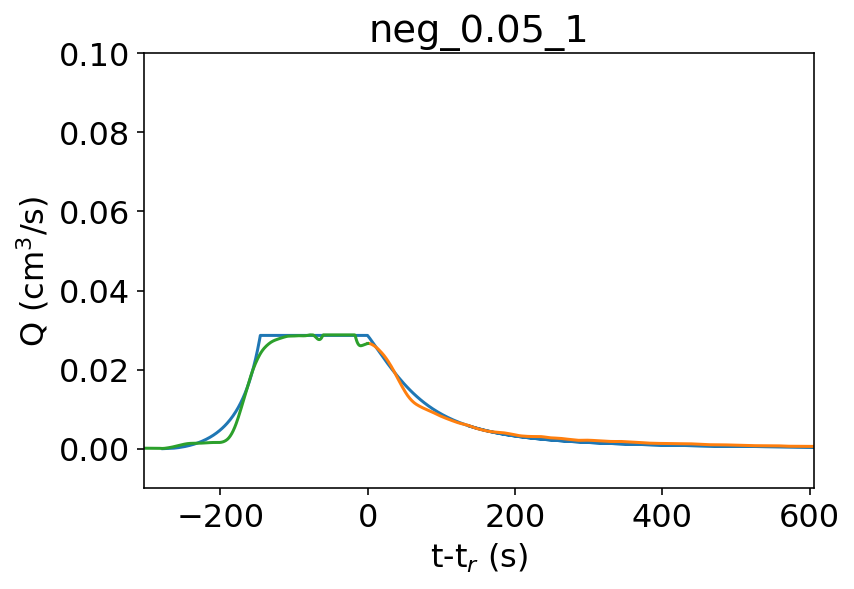

neg_0.05_2 teq =  155.40899839671542  qmax =  0.024895108458314295


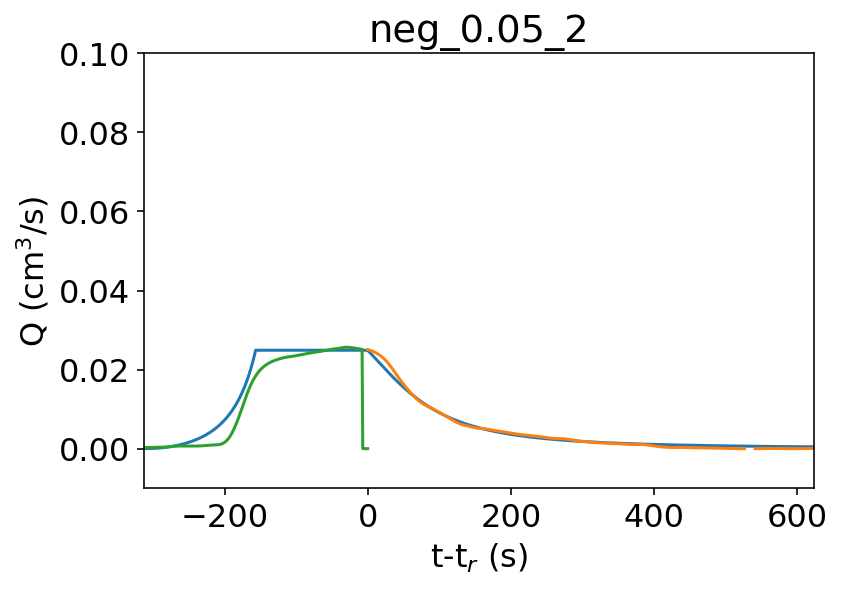

neg_0.05_3 teq =  146.21862641192283  qmax =  0.03253045701504546


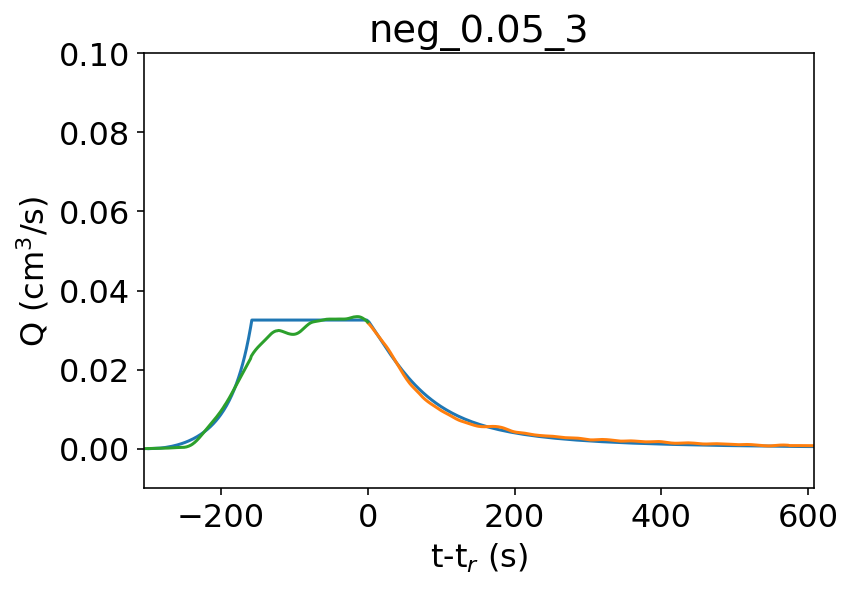

0_3 teq =  196.69038087718872  qmax =  0.04689683522148393


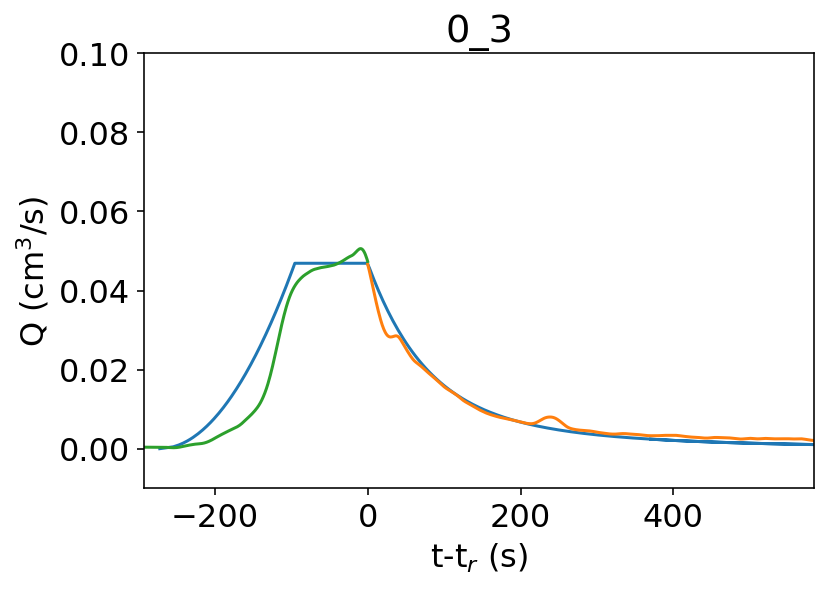

0_4 teq =  196.2469677947473  qmax =  0.045453777261003234


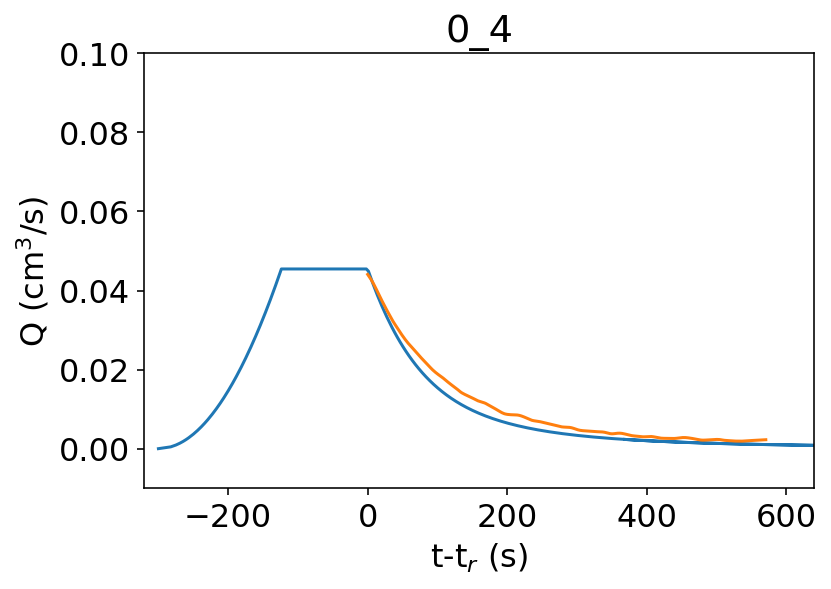

In [29]:
# this block plots each experimental hydrograph with the best fit analytical hydrograph

                                                          # all outlet widths to the same value, ignore this and set
                                                          # outletSame = True
outletSame = False                                        # key that tells the program whether you want the outlet widths
                                                          # set individually by outlet_width or the same for all set by
                                                          # the number outlet

#matplotlib.rcParams.update({'font.size': 10})             # sets font size for figure


#%config InlineBackend.figure_format = 'retina'            # makes figure retina quality

# plot hydrographs

keylist = sim_info.keys() 



for aval in keylist:                      # plots a hydrograph for each value of a
    aa = sim_info[aval][5]
    tr = sim_info[aval][4]
    if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
        xend=hillslopeSizeDict[aval][1]
        xtop=hillslopeSizeDict[aval][0]
    outlet = sim_info[aval][2]

    qouts=[]    # list of q values for hydrograph

    for i in range(len(houts_tot[aval][aa])):                      # loops through houts_tot[aval], the depth values saved from above
        #try: 
        #    float(aval[:4])
        #    g = 0.48
        #except:
        #    g = 2.0
        g=1.0
        qouts= qouts+[(g*aa*(houts_tot[aval][aa][i])**2.)*outlet]         # produces q values at each time

    maxq[aval]=max(qouts)


    tmin=[]  # list of time values in minutes for hydrograph

    for val in touts_tot[aval][aa]:      # converts time values to minutes and saves in tmin
        tmin=tmin+[float(val)-endvals[aval]]



    # plot q or Q, depending on user preference
    pylab.plot((tmin),(qouts),label='$alpha$ = '+str(aa))


    # searches for tc by finding the first time that the maximum value is hit since the max case is the equilibrium case
    k=0
    for i in range(len(qouts)):
        if maxq[aval]==qouts[i] and k==0:
            k=i

    # prints out the value of a, teq, and qmax
    print(aval, 'teq = ',touts_tot[aval][aa][k], ' qmax = ',maxq[aval])

    # increases the value of j, which is used for plotting labels
    j+=1

    plt.ylabel('Q (cm$^3$/s)')

    plt.xlim(-tr,2*tr)                             # sets plot limit to 5 times storm lenth
    plt.xlabel('t-t$_r$ (s)')                     # x-axis label
    plt.title(aval)
    
    v=0
        
    if len(sim_info[aval])>=7:    
        sim_info[aval][6] = [touts_tot[aval][aa][k]]
    else: 
        sim_info[aval] = sim_info[aval] + [touts_tot[aval][aa][k]]
    
    plotprelen=0
    for i in range(len(pre_falling[aval])):
        if aval!='0_4' and aval!='neg_0.05_2':
            if math.isnan(pre_falling[aval][i]) or pre_falling[aval][i]==0 and plotprelen==0:
                plotprelen=i
        elif i<len(pre_falling[aval])-1 and (pre_falling[aval][i])==0 and (pre_falling[aval][i+1])==0 and plotprelen==0:
            if i>100:
                plotprelen=i
                print (i)
        if aval=='neg_0.05_2':
            plotprelen=len(pre_falling[aval])
    
    plt.plot(nm.linspace(0,len(falling_limbs[aval]),len(falling_limbs[aval])),falling_limbs[aval])
    plt.plot(nm.linspace(-endvals[aval],0,plotprelen),pre_falling[aval][:plotprelen])
    plt.ylim(-0.01,0.1)
    #plt.legend() # adds a legend to the plot
    plt.show()


7.061224489795919
16.244897959183675
8.285714285714285
$alpha$ = 7.061224489795919
0.05_3 teq =  237.87268754277486  qmax =  0.07892966319811481


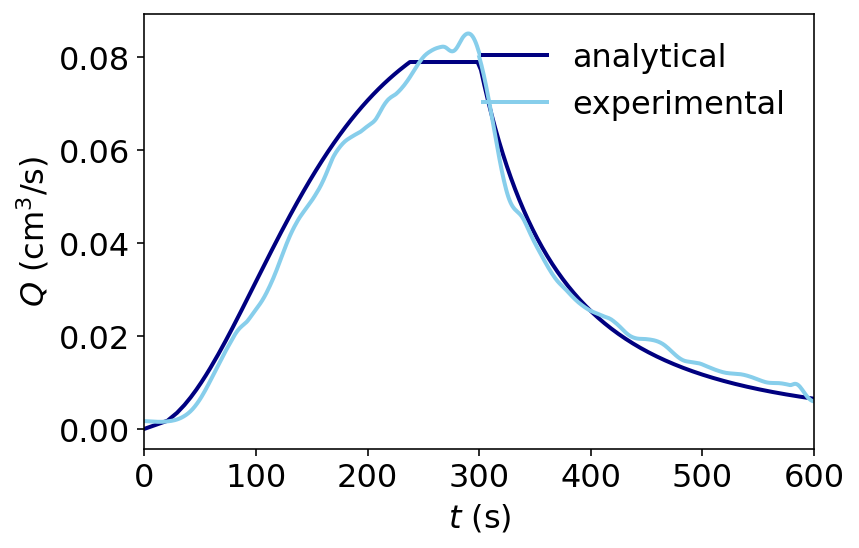

$alpha$ = 7.061224489795919
0.05_4 teq =  247.66450611153175  qmax =  0.0728118167763882


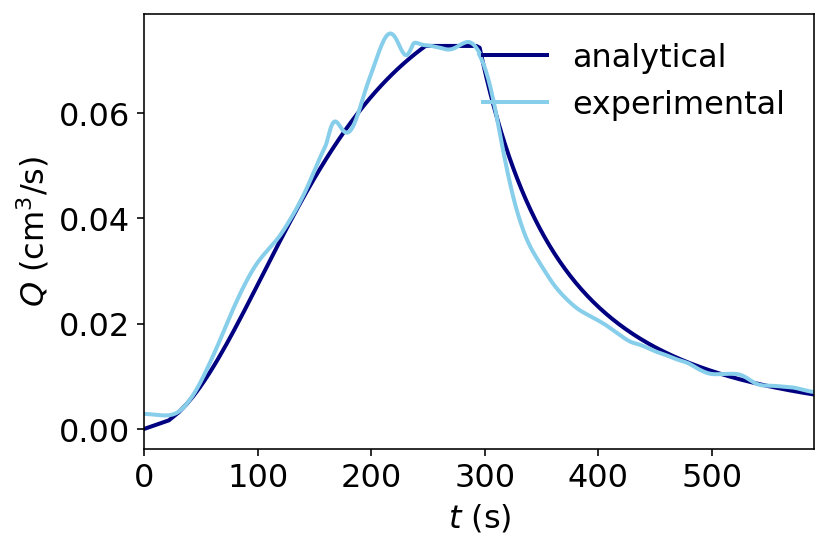

$alpha$ = 7.061224489795919
0.05_5 teq =  261.9931354524733  qmax =  0.06506532201984165


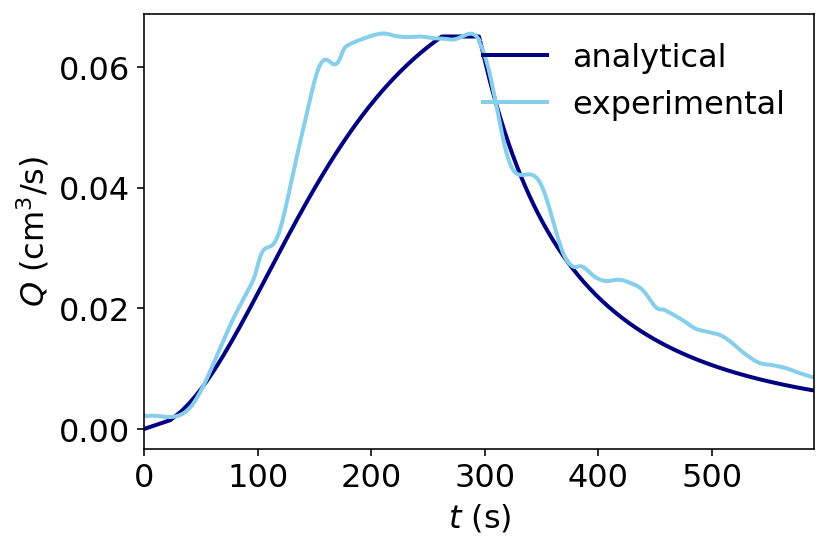

$alpha$ = 16.244897959183675
neg_0.05_1 teq =  165.72319633545553  qmax =  0.028645857876846512


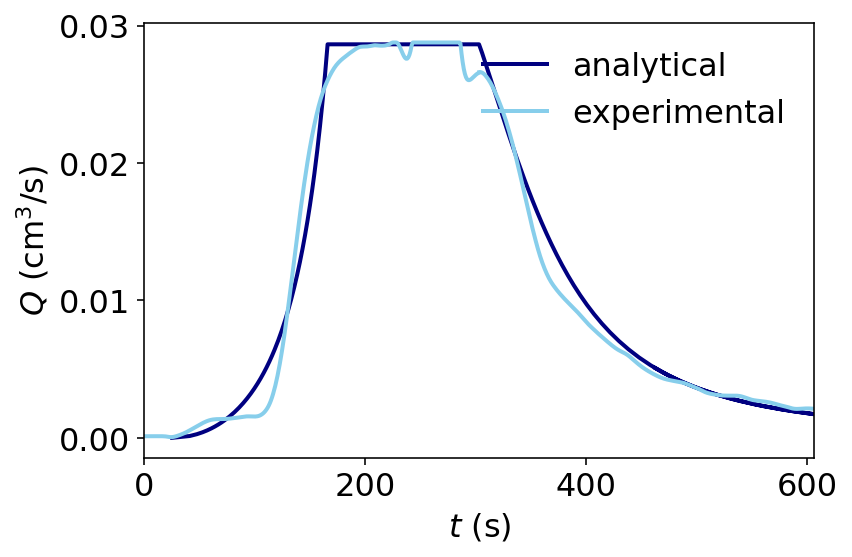

$alpha$ = 16.244897959183675
neg_0.05_2 teq =  150.95225185945034  qmax =  0.024895108458314292


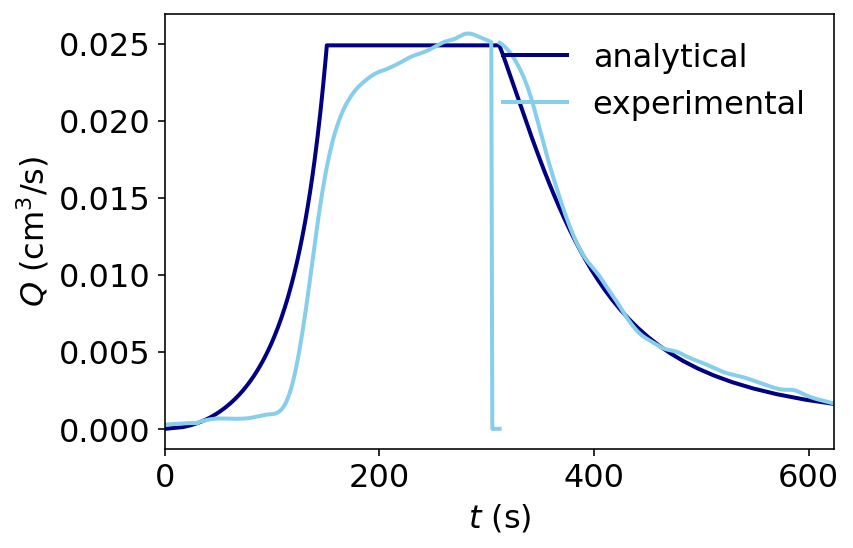

$alpha$ = 16.244897959183675
neg_0.05_3 teq =  138.05398914052753  qmax =  0.032530457015045464


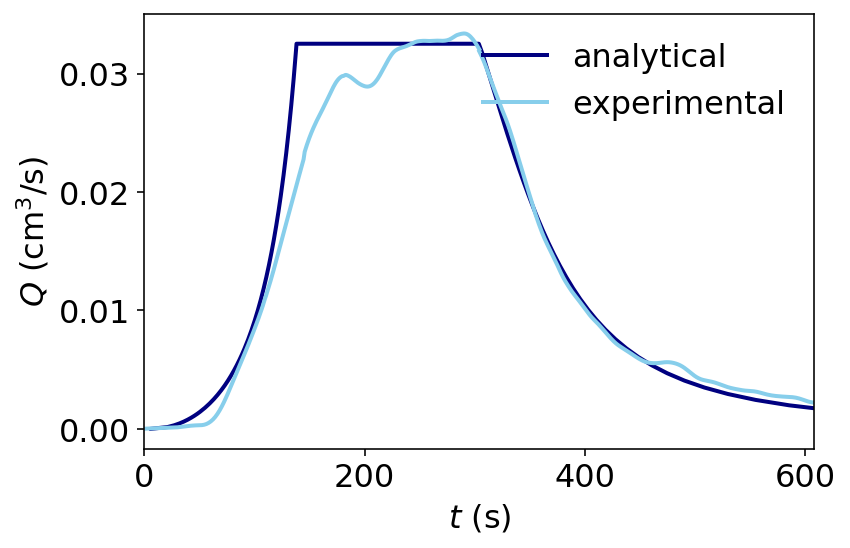

$alpha$ = 8.285714285714285
0_3 teq =  196.69038087718872  qmax =  0.04689683522148393


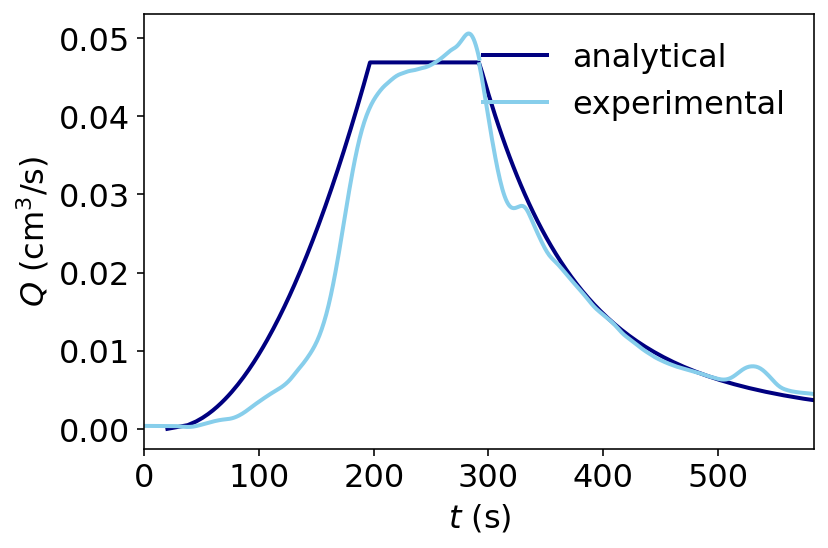

$alpha$ = 8.285714285714285
0_4 teq =  199.4732325605711  qmax =  0.04545377726100325


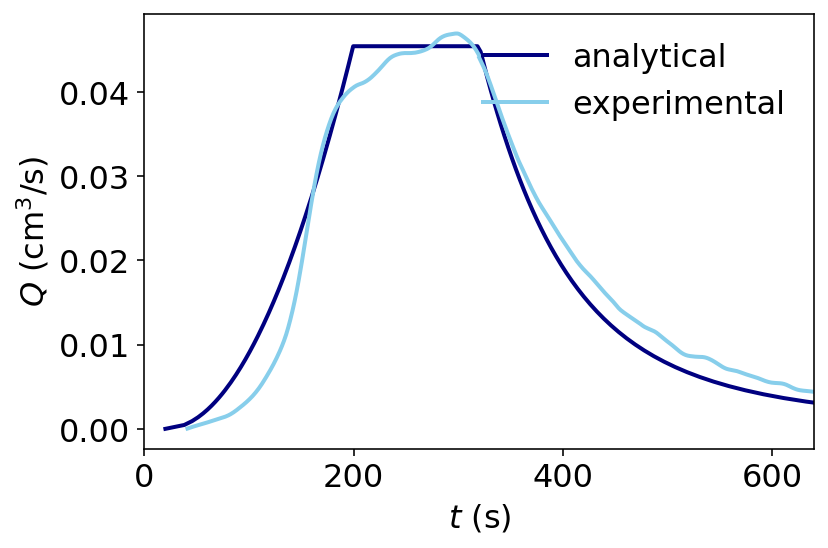

In [30]:
# this block plots each experimental hydrograph with the best fit hydrograph, 
# using the average alpha for all good simulations with the same value of a

alph05 = sum([sim_info['0.05_3'][5],sim_info['0.05_4'][5]])/2.
alph_neg05 = sum([sim_info['neg_0.05_1'][5], sim_info['neg_0.05_3'][5]])/2.
alph_0 = sum([sim_info['0_3'][5]])

curve_aval={aval:0 for aval in keylist}
i05=0
in05=0
i0=0
for i in range(len(alphalist)):
    if alph05<alphalist[i] and i05==0:
        i05=i
    if alph_neg05<alphalist[i] and in05==0:
        in05 = i
    if alph_0<alphalist[i] and i0==0:
        i0 = i
if abs(alph05-alphalist[i05])<abs(alph05-alphalist[i05-1]):
    alpha05 = alphalist[i05]
else:
    alpha05 = alphalist[i05-1]
    
if abs(alph_neg05-alphalist[in05])<abs(alph_neg05-alphalist[in05-1]):
    alpha_neg05 = alphalist[in05]
else:
    alpha_neg05 = alphalist[in05-1]

if abs(alph_0-alphalist[i0])<abs(alph_0-alphalist[i0-1]):
    alph_0 = alphalist[i0]
else:
    alph_0 = alphalist[i0-1]

outletSame = False                                        # key that tells the program whether you want the outlet widths
                                                          # set individually by outlet_width or the same for all set by
print (alpha05)
print (alpha_neg05) # the number outlet
print (alph_0)

#matplotlib.rcParams.update({'font.size': 10})             # sets font size for figure


#%config InlineBackend.figure_format = 'retina'            # makes figure retina quality

# plot hydrographs

keylist = sim_info.keys() 



for aval in keylist:                      # plots a hydrograph for each value of a
    if aval in ['0.05_3','0.05_4','0.05_5']:
        aa = alpha05
        #aa = sim_info['0.05_4'][5]
    elif aval in ['0_3','0_4']:
        aa = alph_0
    else:
        aa = alpha_neg05
    curve_aval[aval]=aa
    tr = sim_info[aval][4]
    if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
        xend=hillslopeSizeDict[aval][1]
        xtop=hillslopeSizeDict[aval][0]
    outlet = sim_info[aval][2]

    qouts=[]    # list of q values for hydrograph

    
    #try: 
    #    float(aval[:4])
    #    g = 0.48
    #except:
    #    g = 2.0
    g = 1.0
    for i in range(len(houts_tot[aval][aa])):                      # loops through houts_tot[aval], the depth values saved from above
        qouts= qouts+[(g*aa*(houts_tot[aval][aa][i])**2)*outlet]         # produces q values at each time

    maxq[aval]=max(qouts)


    tmin=[]  # list of time values in minutes for hydrograph

    for val in touts_tot[aval][aa]:      # converts time values to minutes and saves in tmin
        tmin=tmin+[float(val)]#-300]



    # plot q or Q, depending on user preference
    pylab.plot((tmin),(qouts),c = 'navy',lw = 2,label = 'analytical')
    print ('$alpha$ = '+str(aa),)

    # searches for tc by finding the first time that the maximum value is hit since the max case is the equilibrium case
    k=0
    for i in range(len(qouts)):
        if maxq[aval]==qouts[i] and k==0:
            k=i

    # prints out the value of a, teq, and qmax
    print(aval, 'teq = ',touts_tot[aval][aa][k], ' qmax = ',maxq[aval])

    # increases the value of j, which is used for plotting labels
    j+=1

    plt.ylabel('$Q$ (cm$^3$/s)')

    plt.xlim(0,2*tr)                             # sets plot limit to 5 times storm lenth
    plt.xlabel('$t$ (s)')                     # x-axis label
    #plt.title(aval)
    
    
    v = 0.
    if aval=='0_3' or aval=='0_4':
        a=-0.0000000001
        tp=20.
    elif aval=='neg_0.05_1': 
        tp=25.
    elif aval=='neg_0.05_2' :
        tp=0.
    elif aval=='neg_0.05_3':
        tp = 6.
    else:
        tp=0.
    if len(sim_info[aval])>=7:    
        sim_info[aval][6] = [touts_tot[aval][aa][k]-tp]
    else: 
        sim_info[aval] = sim_info[aval] + [touts_tot[aval][aa][k]-tp]
    #plt.legend()
    plt.plot(nm.linspace(sim_info[aval][4],sim_info[aval][4]+len(falling_limbs[aval]),len(falling_limbs[aval])),falling_limbs[aval],c='skyblue',lw=2)
    plot_prefall = []
    plotprelen=0
    for i in range(len(pre_falling[aval])):
        if aval!='0_4' and aval!='neg_0.05_2':
            if math.isnan(pre_falling[aval][i]) or pre_falling[aval][i]==0 and plotprelen==0:
                plotprelen=i
        #elif i<len(pre_falling[aval])-1 and (pre_falling[aval][i])==0 and (pre_falling[aval][i+1])==0 and plotprelen==0:
        #    if i>100:
        #        plotprelen=i
        #        print (i)
        if aval=='neg_0.05_2':
            plotprelen=len(pre_falling[aval])
    if aval=='0_4':
        plotprelen=320
    
    #plt.plot(nm.linspace(0,len(falling_limbs[aval]),len(falling_limbs[aval])),falling_limbs[aval],c='skyblue',lw=2,label = 'experimental')
    plt.plot(nm.linspace(0,endvals[aval],plotprelen),pre_falling[aval][:plotprelen],c='skyblue',lw=2,label = 'experimental')
    #plt.ylim(-0.01,0.1)
    plt.legend(framealpha=0,loc='upper right') # adds a legend to the plot
    plt.show()


11.346938775510203
8.89795918367347
7.979591836734694
$alpha$ = 11.346938775510203
0.05_3 teq =  0.0  qmax =  0.17446717919402613


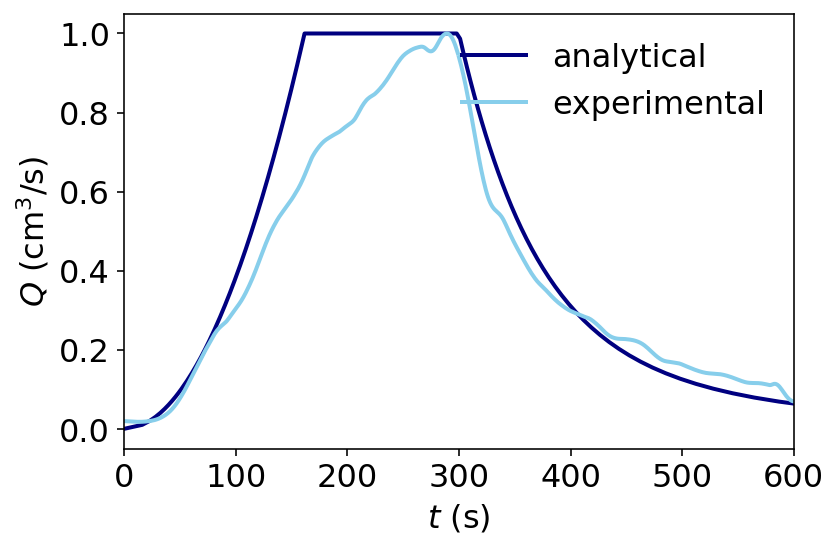

$alpha$ = 11.346938775510203
0.05_4 teq =  0.0  qmax =  0.1609442099490946


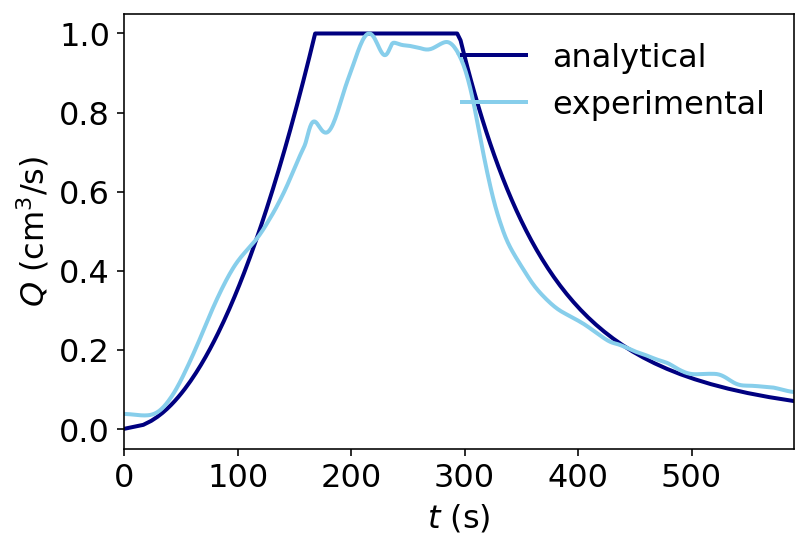

$alpha$ = 11.346938775510203
0.05_5 teq =  0.0  qmax =  0.14382125472472385


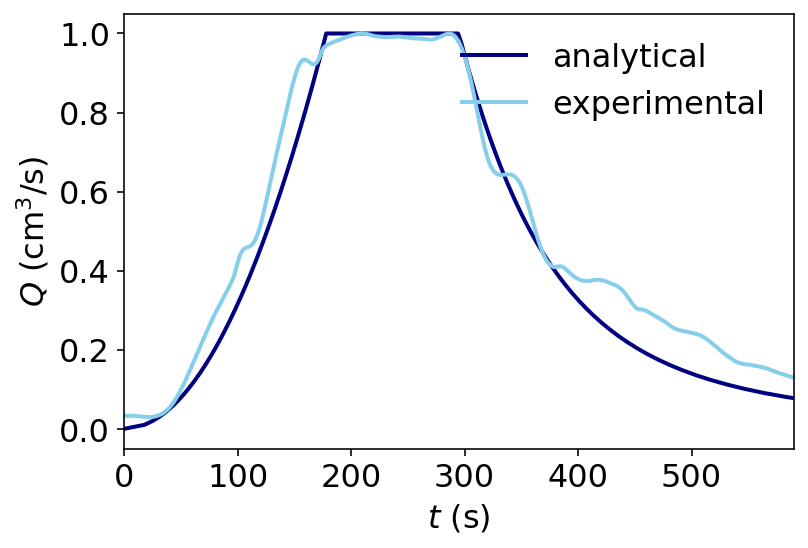

$alpha$ = 8.89795918367347
neg_0.05_1 teq =  25.0  qmax =  0.01302786009617285


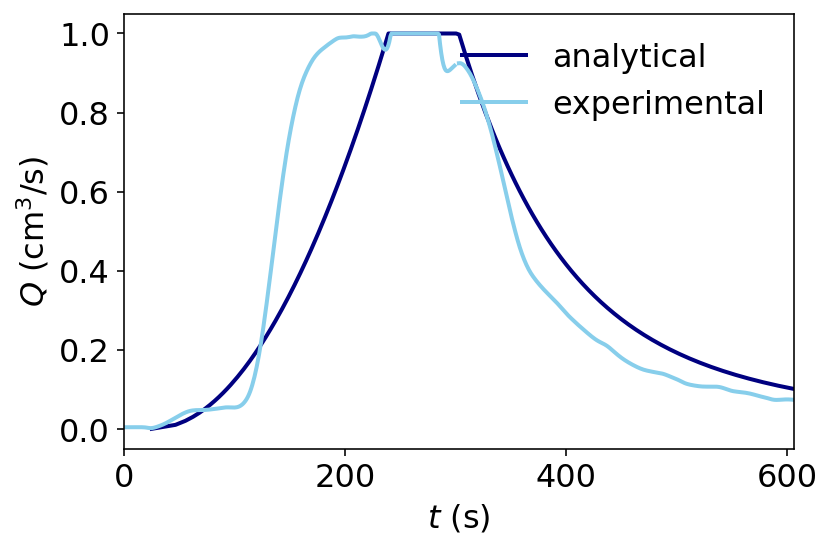

$alpha$ = 8.89795918367347
neg_0.05_2 teq =  0.0  qmax =  0.011322055407393231


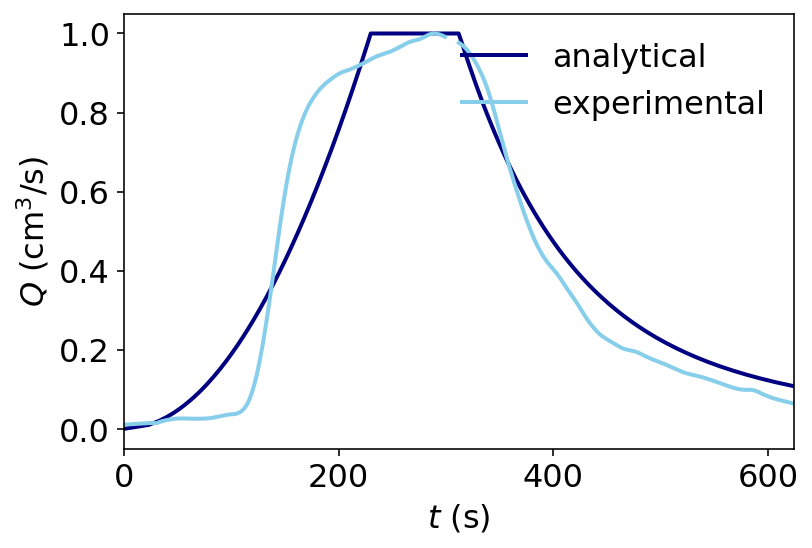

$alpha$ = 8.89795918367347
neg_0.05_3 teq =  6.0  qmax =  0.014794538347518716


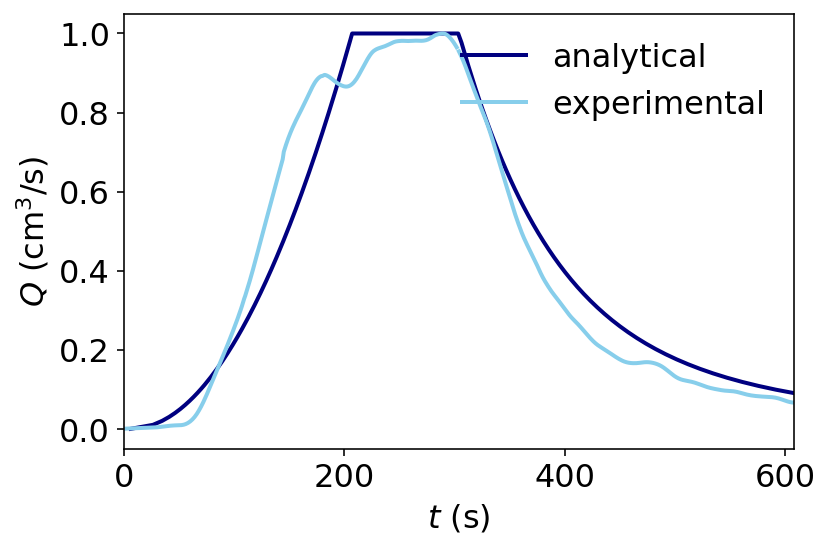

$alpha$ = 7.979591836734694
0_3 teq =  20.0  qmax =  0.046896835221483926


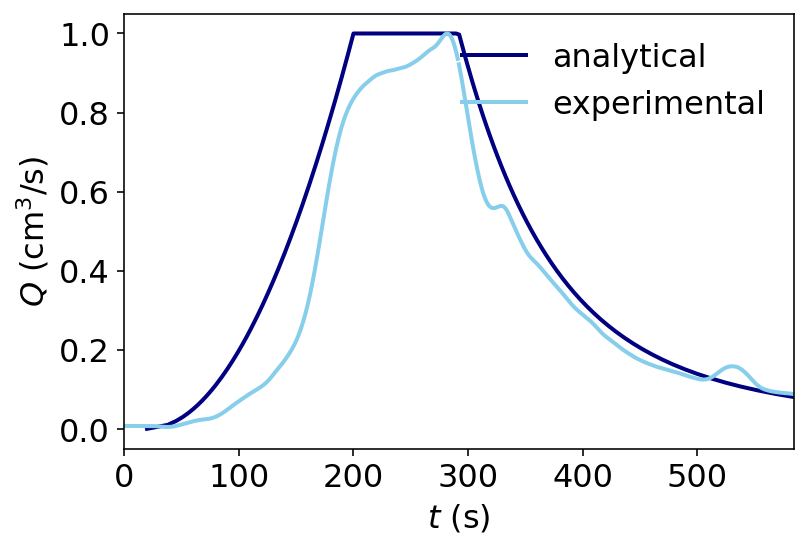

$alpha$ = 7.979591836734694
0_4 teq =  20.0  qmax =  0.04545377726100325


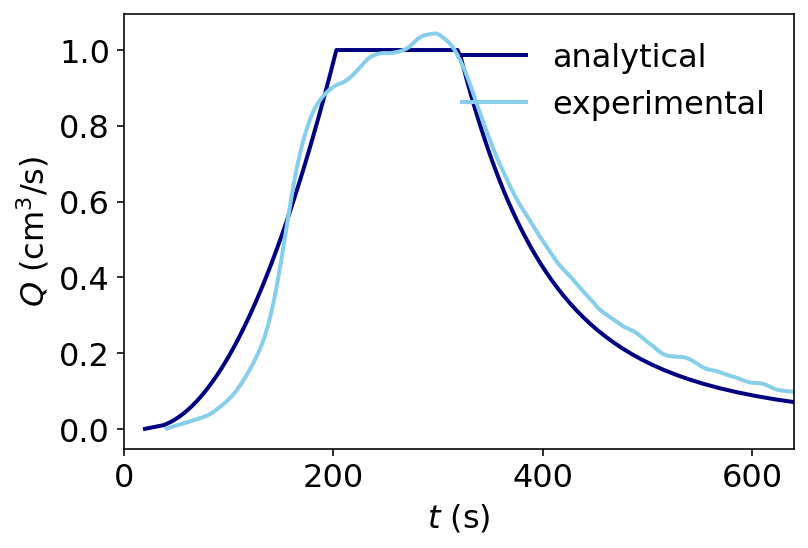

In [59]:
# this block plots the average best fit alpha for each value of a
# all simulations assume that a=0
# hydrographs are normalized

alph05 = sum([nocurve_alpha['0.05_4'][0],nocurve_alpha['0.05_3'][0]])/2.
alph_neg05 = sum([nocurve_alpha['neg_0.05_1'][0],nocurve_alpha['neg_0.05_3'][0]])/3.
alph_0 = nocurve_alpha['0_3'][0]#sum([sim_info['0_3'][5],sim_info['0_4'][5]])/2.


i05=0
in05=0
i0=0
for i in range(len(alphalist)):
    if alph05<alphalist[i] and i05==0:
        i05=i
    if alph_neg05<alphalist[i] and in05==0:
        in05 = i
    if alph_0<alphalist[i] and i0==0:
        i0 = i
if abs(alph05-alphalist[i05])<abs(alph05-alphalist[i05-1]):
    alpha05 = alphalist[i05]
else:
    alpha05 = alphalist[i05-1]
    
if abs(alph_neg05-alphalist[in05])<abs(alph_neg05-alphalist[in05-1]):
    alpha_neg05 = alphalist[in05]
else:
    alpha_neg05 = alphalist[in05-1]

if abs(alph_0-alphalist[i0])<abs(alph_0-alphalist[i0-1]):
    alph_0 = alphalist[i0]
else:
    alph_0 = alphalist[i0-1]

outletSame = False                                        # key that tells the program whether you want the outlet widths
                                                          # set individually by outlet_width or the same for all set by
print (alpha05)
print (alpha_neg05) # the number outlet
print (alph_0)

#matplotlib.rcParams.update({'font.size': 10})             # sets font size for figure


#%config InlineBackend.figure_format = 'retina'            # makes figure retina quality

# plot hydrographs

keylist = sim_info.keys() 



for aval in keylist:                      # plots a hydrograph for each value of a
    if aval in ['0.05_3','0.05_4','0.05_5']:
        aa = alpha05
        #aa = sim_info['0.05_4'][5]
    elif aval in ['0_3','0_4']:
        aa = alph_0
        
    else:
        aa = alpha_neg05
    nocurve_alpha[aval][1]=aa
    tr = sim_info[aval][4]
    if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
        xend=hillslopeSizeDict[aval][1]
        xtop=hillslopeSizeDict[aval][0]
    outlet = sim_info[aval][2]

    qouts=[]    # list of q values for hydrograph

    
    #try: 
    #    float(aval[:4])
    #    g = 0.48
    #except:
    #    g = 2.0
    g = 1.0
    for i in range(len(houts_tot_1[aval][aa])):                      # loops through houts_tot[aval], the depth values saved from above
        qouts= qouts+[(g*aa*(houts_tot_1[aval][aa][i])**2)*outlet]         # produces q values at each time

    maxq[aval]=max(qouts)

    qouts = [q/maxq[aval] for q in qouts]
    tmin=[]  # list of time values in minutes for hydrograph

    for val in touts_tot_1[aval][aa]:      # converts time values to minutes and saves in tmin
        tmin=tmin+[float(val)]#-300]



    # plot q or Q, depending on user preference
    pylab.plot((tmin),(qouts),c = 'navy',lw = 2,label = 'analytical')
    print ('$alpha$ = '+str(aa),)

    # searches for tc by finding the first time that the maximum value is hit since the max case is the equilibrium case
    k=0
    for i in range(len(qouts)):
        if maxq[aval]==qouts[i] and k==0:
            k=i

    # prints out the value of a, teq, and qmax
    print(aval, 'teq = ',touts_tot_1[aval][aa][k], ' qmax = ',maxq[aval])

    # increases the value of j, which is used for plotting labels
    j+=1

    plt.ylabel('$Q$ (cm$^3$/s)')

    plt.xlim(0,2*tr)                             # sets plot limit to 5 times storm lenth
    plt.xlabel('$t$ (s)')                     # x-axis label
    #plt.title(aval)
    
   
    v = 0.
        
    
    
    plot_prefall = []
    if aval=='neg_0.05_3':
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-17]]
    elif aval=='0.05_3':
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-20]]
    elif aval=='neg_0.05_1' or aval=='neg_0.05_2':
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-20]]
    elif aval=='0_3':
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-28]]
    elif aval=='0_4':
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-7]]
    else:
        plot_prefall = [p/max(pre_falling[aval][:-3]) for p in pre_falling[aval][:-25]]
    
    if aval=='0_4':
        plot_prefall = [p/0.045 for p in pre_falling[aval]]
        plt.plot(nm.linspace(sim_info[aval][4],sim_info[aval][4]+len(falling_limbs[aval]),len(falling_limbs[aval])),[f/0.045 for f in falling_limbs[aval]],c='skyblue',lw=2)
    else:
        plt.plot(nm.linspace(sim_info[aval][4],sim_info[aval][4]+len(falling_limbs[aval]),len(falling_limbs[aval])),[f/max(pre_falling[aval]) for f in falling_limbs[aval]],c='skyblue',lw=2)
    plt.plot(plot_prefall,c='skyblue',lw=2,label = 'experimental')
    #plt.ylim(-0.01,0.1)
    plt.legend(framealpha=0,loc='upper right') # adds a legend to the plot
    plt.show()


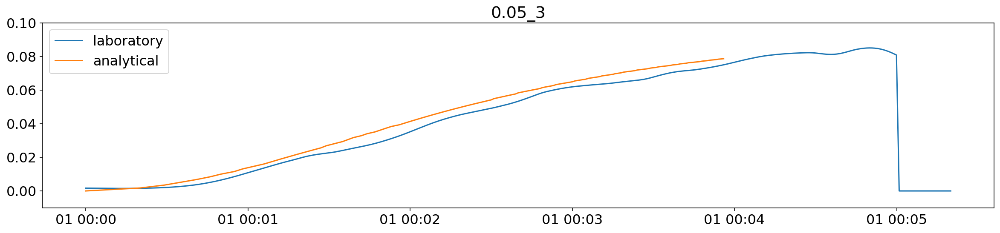

NRMSE =  0.0011081938861003055


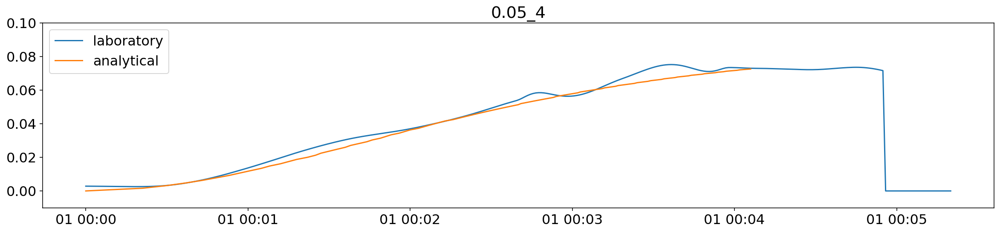

NRMSE =  0.000990783876250302


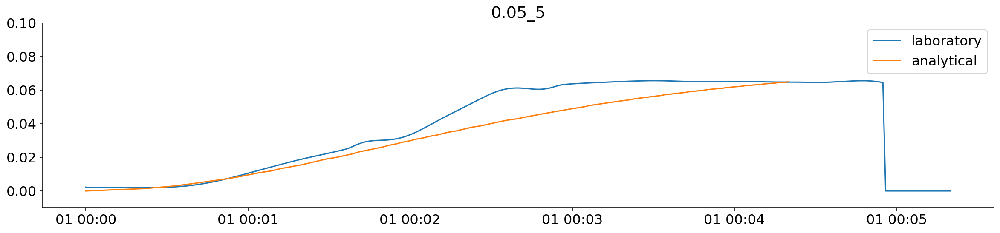

NRMSE =  0.015547246529335906


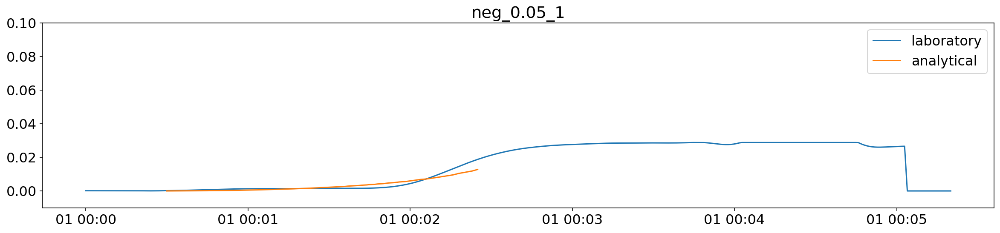

NRMSE =  0.020538992603185955


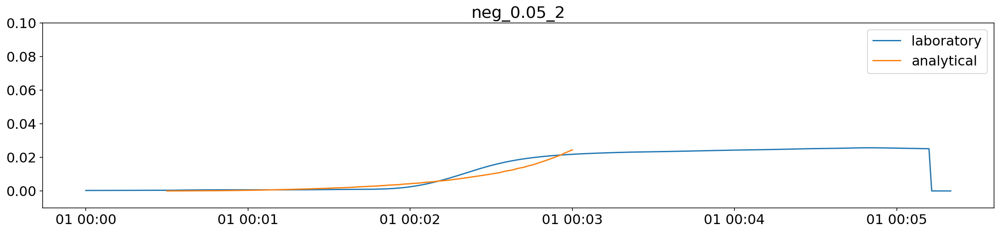

NRMSE =  0.013445359531924496


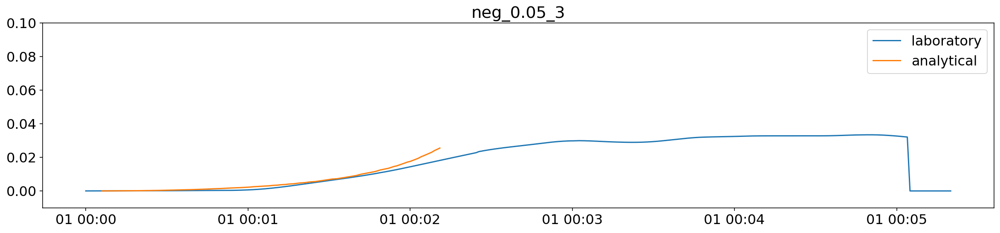

NRMSE =  0.0026510395289502603


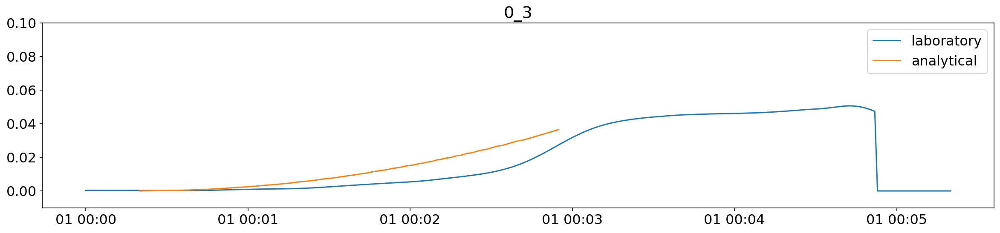

NRMSE =  0.013560023931033536


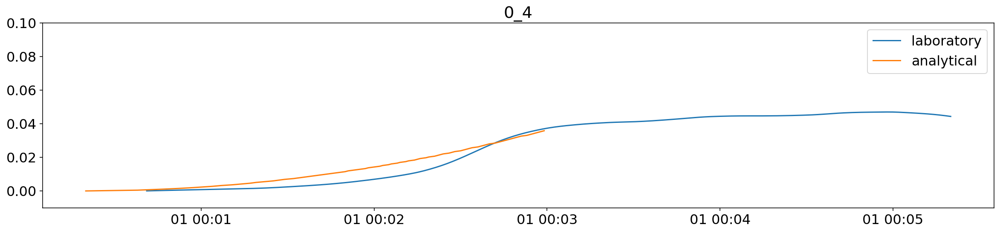

NRMSE =  0.03713056943844385


In [60]:
# this block plots only the rising limb for each experiment with the 
# best fit rising limb (average alpha for each value of a)
# NRMSE is calculated in each case

rmse_vals = {aval:0 for aval in keylist}
nrmse_vals = {aval:0 for aval in keylist}


for aval in keylist: 
    plt.figure(figsize=(20,4))
    #print len(df_falling[aval])
    filer = df_prefalling[aval]
    filer.index = pd.to_datetime(nm.linspace(0,len(filer),len(filer)), unit='s')

    
    plt.plot(filer,label='laboratory')
    #plt.show()

    aa=curve_aval[aval]
    #plt.figure(figsize=(20,4))
    tr = sim_info[aval][4]
    tc = sim_info[aval][6]
    outlet = sim_info[aval][2]
    end = 0
    for i in range(len(touts_tot[aval][aa])):
        if touts_tot[aval][aa][i]>=tc and end==0:
            end=i
    if aval=='neg_0.05_2':
        v = 30.
    elif aval=='neg_0.05_1':
        v = 5.
    else:
        v = 0.
    rising_t = [tt+v for tt in touts_tot[aval][aa][:end]]
    rising_q = [h**2.*aa*outlet for h in houts_tot[aval][aa][:end]]
    #plt.plot(falling_t,falling_q)
    #print falling_t

    df = pd.DataFrame({'q': rising_q})
    df.index = pd.to_datetime([t*1. for t in rising_t],unit = 's')

    s_resampled_data = df.resample('1s').mean()
    s_resampled_data = s_resampled_data.interpolate()
    #print s_resampled_data.head()


    plt.plot(s_resampled_data,label='analytical')
    #plt.show()

    #print filer_resampled['sum'][s_resampled_data.idxmin()]
    nnm = max(s_resampled_data['q'].tolist())
    mm = max(filer.tolist()[:len(s_resampled_data)])
    
    
    try:
        rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
        nfiler = [f/mm for f in filer.tolist()[:len(s_resampled_data)]]
        n_s_resampled_data = [f/nnm for f in s_resampled_data['q'].tolist()]
        nrms = mean_squared_error(nfiler,n_s_resampled_data)
    except:
        rmslist=[]
        for i in range(len (filer.tolist()[:len(s_resampled_data)])):
            if math.isnan(filer.tolist()[:len(s_resampled_data)][i]):
                rmslist = rmslist + [0.]
            else:
                rmslist = rmslist + [filer.tolist()[:len(s_resampled_data)][i]]
        rms = mean_squared_error(rmslist,s_resampled_data['q'].tolist())
        mm = max(rmslist)
        nfiler = [f/mm for f in rmslist]
        n_s_resampled_data = [f/nnm for f in s_resampled_data['q'].tolist()]
        nrms = mean_squared_error(nfiler,n_s_resampled_data)
        
    plt.legend()
    #plt.xlim(min())
    plt.title(aval)
    plt.ylim(-0.01,0.1)
    plt.show()
 
    
    
    print ('NRMSE = ',nrms)
    rmse_vals[aval]=rms
    nrmse_vals[aval]=nrms

    

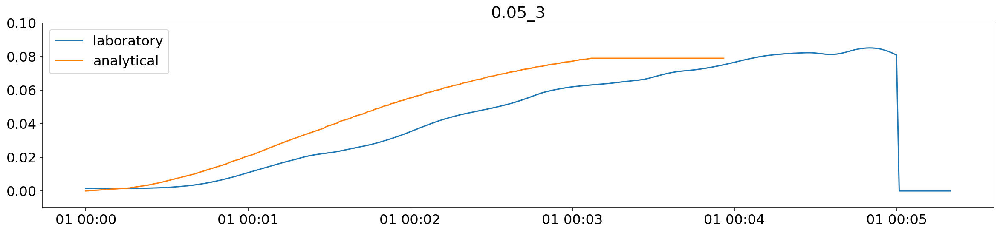

NRMSE =  0.9561658919147167


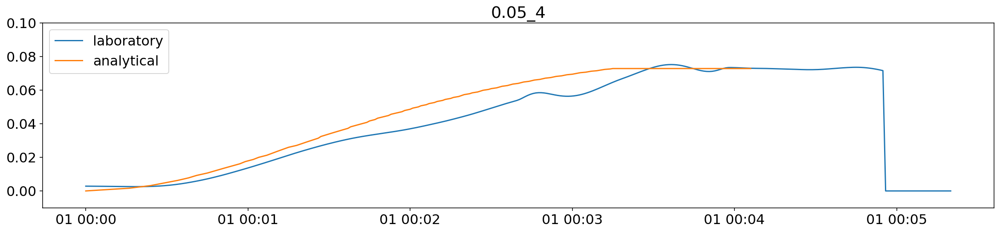

NRMSE =  0.677977678248733


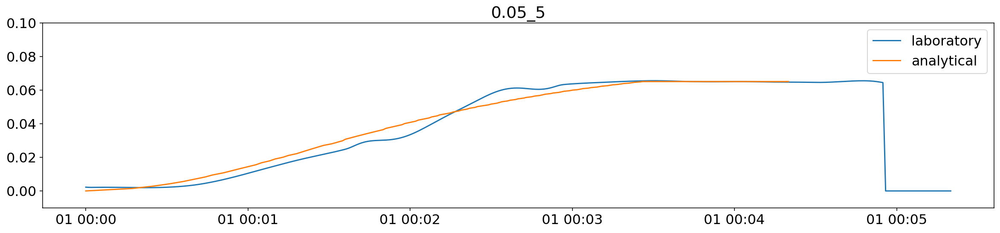

NRMSE =  0.33510957715385103


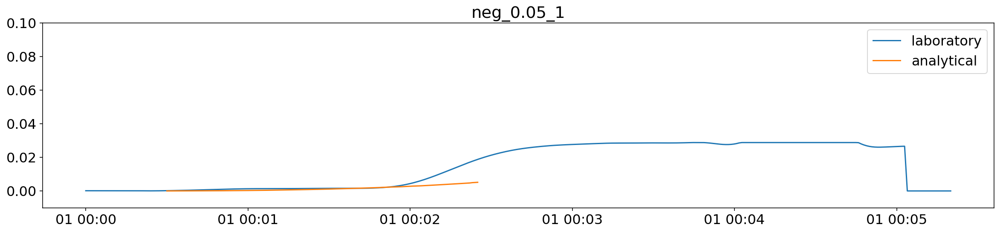

NRMSE =  0.12589102503698632


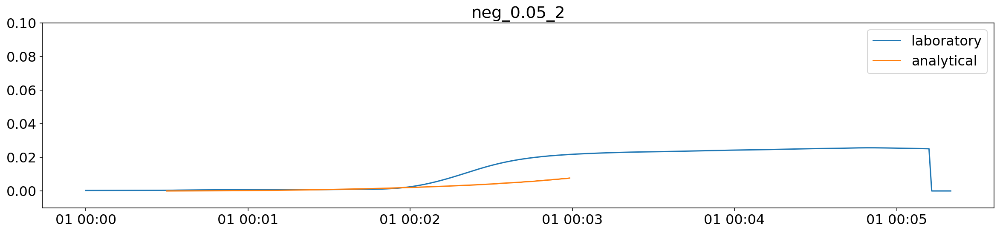

NRMSE =  0.040898239933954056


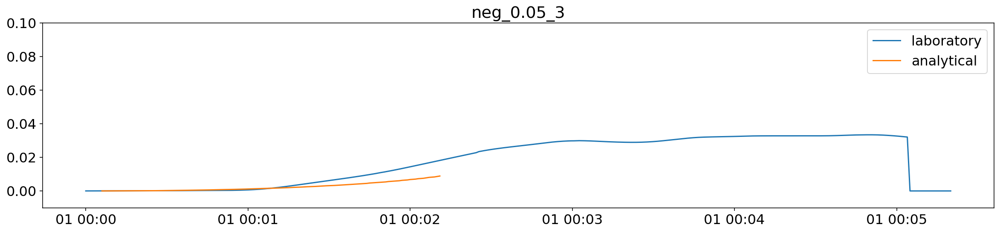

NRMSE =  0.08172691850524669


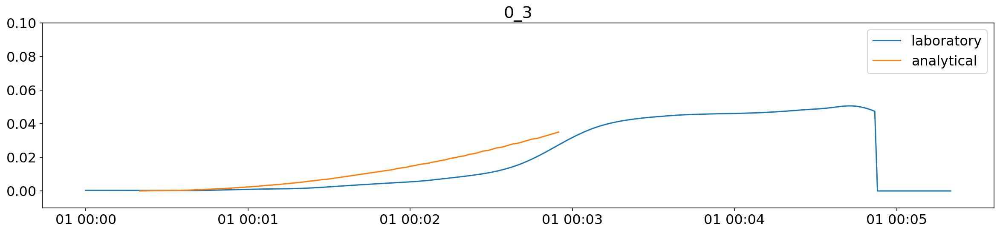

NRMSE =  0.011987418817839735


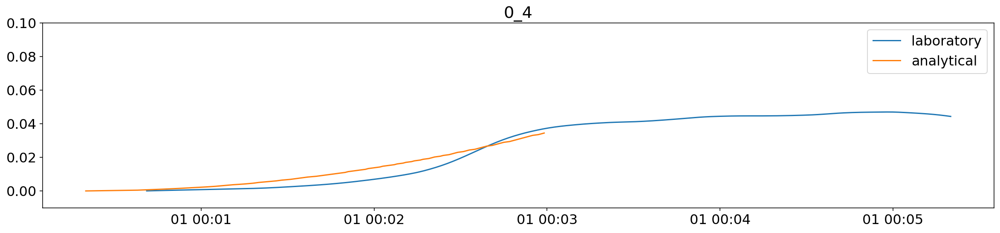

NRMSE =  0.03202765861975106


In [61]:
# this block plots only the rising limb for each experiment with the 
# best fit rising limb (average alpha for each value of a with a=0 in all cases)
# NRMSE is calculated in each case

rmse_vals_nocurve = {aval:0 for aval in keylist}
nrmse_vals_nocurve = {aval:0 for aval in keylist}

for aval in keylist: 
    plt.figure(figsize=(20,4))
    #print len(df_falling[aval])
    filer = df_prefalling[aval]
    filer.index = pd.to_datetime(nm.linspace(0,len(filer),len(filer)), unit='s')

    
    plt.plot(filer,label='laboratory')
    #plt.show()

    aa = nocurve_alpha[aval][1]
    #plt.figure(figsize=(20,4))
    tr = sim_info[aval][4]
    tc = sim_info[aval][6]
    outlet = sim_info[aval][2]
    end = 0
    for i in range(len(touts_tot[aval][aa])):
        if touts_tot[aval][aa][i]>=tc and end==0:
            end=i
    if aval=='neg_0.05_2':
        v = 30.
    elif aval=='neg_0.05_1':
        v = 5.
    else:
        v = 0.
    rising_t = [tt+v for tt in touts_tot[aval][aa][:end]]
    rising_q = [h**2.*aa*outlet for h in houts_tot[aval][aa][:end]]
    #plt.plot(falling_t,falling_q)
    #print falling_t

    df = pd.DataFrame({'q': rising_q})
    df.index = pd.to_datetime([t*1. for t in rising_t],unit = 's')

    s_resampled_data = df.resample('1s').mean()
    s_resampled_data = s_resampled_data.interpolate()
    #print s_resampled_data.head()


    plt.plot(s_resampled_data,label='analytical')
    #plt.show()

    #print filer_resampled['sum'][s_resampled_data.idxmin()]
    
    mm = max(filer.tolist()[:len(s_resampled_data)])
    mmm = max(s_resampled_data['q'].tolist())
    
    try:
        rms = mean_squared_error(filer.tolist()[:len(s_resampled_data)],s_resampled_data['q'].tolist())
        nfiler = [f/mm for f in filer.tolist()[:len(s_resampled_data)]]
        n_s_resampled_data = [f/nnm for f in s_resampled_data['q'].tolist()]
        nrms = mean_squared_error(nfiler,n_s_resampled_data)
    except:
        rmslist=[]
        for i in range(len (filer.tolist()[:len(s_resampled_data)])):
            if math.isnan(filer.tolist()[:len(s_resampled_data)][i]):
                rmslist = rmslist + [0.]
            else:
                rmslist = rmslist + [filer.tolist()[:len(s_resampled_data)][i]]
        rms = mean_squared_error(rmslist,s_resampled_data['q'].tolist())
        mm = max(rmslist)
        nfiler = [f/mm for f in rmslist]
        n_s_resampled_data = [f/nnm for f in s_resampled_data['q'].tolist()]
        nrms = mean_squared_error(nfiler,n_s_resampled_data)
        
    plt.legend()
    #plt.xlim(min())
    plt.title(aval)
    plt.ylim(-0.01,0.1)
    plt.show()
 
    
    
    print ('NRMSE = ',nrms)
    rmse_vals_nocurve[aval]=rms
    nrmse_vals_nocurve[aval]=nrms

    

([<matplotlib.axis.XTick at 0x11ad4aef0>,
 <a list of 3 Text xticklabel objects>)

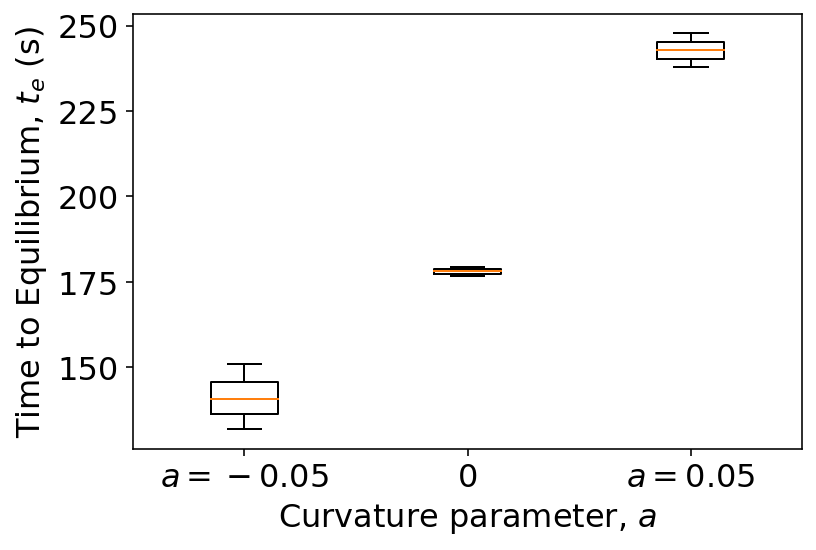

In [505]:
# boxplot showing time of concnetration for each set of 
# simulations (value taken from best fit (average alpha) analytical solution)

plt.boxplot([sim_info['neg_0.05_1'][6]+sim_info['neg_0.05_2'][6]+sim_info['neg_0.05_3'][6],
             sim_info['0_3'][6]+sim_info['0_4'][6],
             sim_info['0.05_3'][6]+sim_info['0.05_4'][6]])
plt.xlabel('Curvature parameter, $a$')
plt.ylabel('Time to Equilibrium, $t_e$ (s)')
plt.xticks([1,2,3],['$a=-0.05$','0','$a=0.05$'])

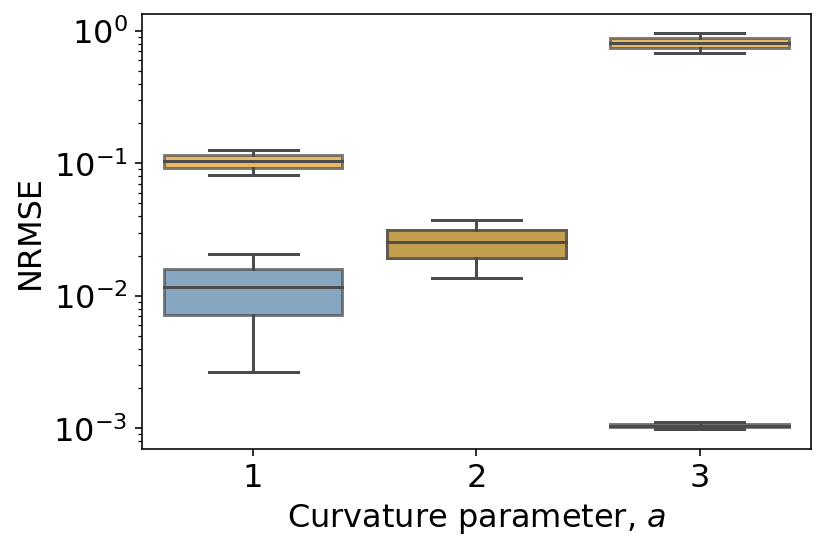

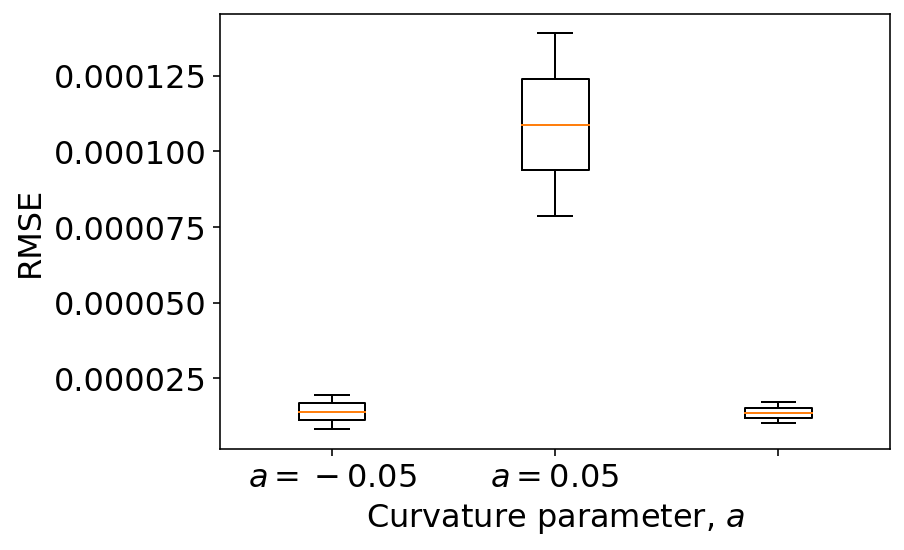

In [62]:
# boxplots of RMSE and NRMSE between rising limbs and best fit (average alpha) analytical fits
# comparison between error when a is correctly stated vs. when a is assumed to be 0

import seaborn as sns

boxplot_kwargs = dict({'alpha': 0.7})
bp1=sns.boxplot(x=[1,2,3],y=[[nrmse_vals['neg_0.05_1']]+[nrmse_vals['neg_0.05_3']],
             [nrmse_vals['0_3']]+[nrmse_vals['0_4']],
             [nrmse_vals['0.05_3']]+[nrmse_vals['0.05_4']]],color='steelblue',boxprops=dict(alpha=.7))
bp2=sns.boxplot(x=[1,2,3],y=[[nrmse_vals_nocurve['neg_0.05_1']]+[nrmse_vals_nocurve['neg_0.05_3']],
             [nrmse_vals['0_3']]+[nrmse_vals['0_4']],
             [nrmse_vals_nocurve['0.05_3']]+[nrmse_vals_nocurve['0.05_4']]],color='orange',boxprops=dict(alpha=.7))
#plt.legend()#(bp1,bp2),('curvature','no curvature'))
plt.xlabel('Curvature parameter, $a$')
plt.ylabel('NRMSE')
#plt.xticks([1,2],['$a=-0.05$','$a=0.05$'])
plt.yscale('log')
plt.show()

plt.boxplot([[rmse_vals['neg_0.05_2']]+[rmse_vals['neg_0.05_3']],
             [rmse_vals['0_3']]+[rmse_vals['0_4']],
             [rmse_vals['0.05_3']]+[rmse_vals['0.05_4']]])
plt.xlabel('Curvature parameter, $a$')
plt.ylabel('RMSE')
plt.xticks([1,2,3],['$a=-0.05$','$a=0.05$'])
#plt.yscale('log')
plt.show()

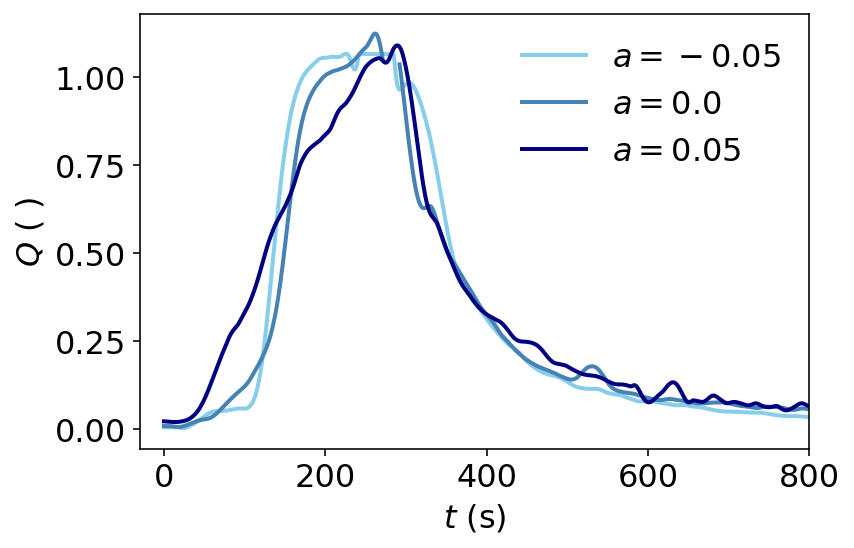

In [63]:
# plot three experimental hydrographs together (normalized), one for each value of a

keylist = sim_info.keys() 

clist = ['skyblue','steelblue','navy']
labellist = ['$a=-0.05$','$a=0.0$','$a=0.05$']

cval = 0

for aval in ['neg_0.05_1','0_3','0.05_3']:                      # plots a hydrograph for each value of a
    if aval in ['0.05_3','0.05_4','0.05_5']:
        aa = alpha05
        #aa = sim_info['0.05_4'][5]
    elif aval in ['0_3','0_4']:
        aa = alph_0
    else:
        aa = alpha_neg05
    tr = sim_info[aval][4]
    if different==True:                   # defines hillslope dimension in x using hillslopeSizeDict if true or xend and xtop if False
        xend=hillslopeSizeDict[aval][1]
        xtop=hillslopeSizeDict[aval][0]
    outlet = sim_info[aval][2]

    qouts=[]    # list of q values for hydrograph

    
    #try: 
    #    float(aval[:4])
    #    g = 0.48
    #except:
    #    g = 2.0
        
    if len(sim_info[aval])>=7:    
        sim_info[aval][6] = [touts_tot[aval][aa][k]]
    else: 
        sim_info[aval] = sim_info[aval] + [touts_tot[aval][aa][k]]
    #plt.legend()
    if aval=='neg_0.05_3':
        divval = 0.032
    elif aval=='neg_0.05_2':
        divval = 0.025
    elif aval=='neg_0.05_1':
        divval = 0.027
    elif aval=='0_3':
        divval = 0.045
    else:
        divval = 0.078
    if aval=='0_3':
        plt.plot(nm.linspace(sim_info[aval][4],sim_info[aval][4]+len(falling_limbs[aval]),len(falling_limbs[aval])),[f/divval for f in falling_limbs[aval]],c=clist[cval],lw=2)
    else:
        plt.plot(nm.linspace(sim_info[aval][4],sim_info[aval][4]+len(falling_limbs[aval]),len(falling_limbs[aval])),[f/divval for f in falling_limbs[aval]],c=clist[cval],lw=2)
    plot_prefall = []
    if aval=='neg_0.05_3':
        plot_prefall = pre_falling[aval][:-20]
    elif aval=='0.05_3':
        plot_prefall = pre_falling[aval][:-20]
    elif aval=='neg_0.05_1' or aval=='neg_0.05_2':
        plot_prefall = pre_falling[aval][:-20]
    elif aval=='0_3'or aval=='0_4':
        plot_prefall = pre_falling[aval][20:-28]

    else:
        plot_prefall = pre_falling[aval][:-10]
    plot_prefall = [p/divval for p in plot_prefall]
    plt.plot(plot_prefall,c=clist[cval],lw=2,label = labellist[cval])
    plt.xlim(-30,800)
    plt.ylabel('$Q$ ( )')
    plt.xlabel('$t$ (s)')
    
    #plt.show()
    cval+=1
plt.legend(framealpha=0,loc='upper right') # adds a legend to the plot
plt.show()